<a href="https://colab.research.google.com/github/skengman1312/UDA/blob/main/DeepLearning_UDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Unsupervised Domain Adaptation**
#### Pietro Demurtas (MAT. 229707), Rossana Cervesato (MAT. 231499)


Deep learning course, AA 2021/2022

Prof. Elisa Ricci

# Abstract

Unsupervised domain adaptation (UDA) is a machine learning problem that has gained significant attention due to its practical importance in scenarios where labeled target domain data is scarce or expensive to obtain.

The goal of UDA is to learn domain-invariant representations, allowing a model to generalize well by effectively transferring knowledge from the source domain to the target domain.

To achieve this, UDA methods employ various techniques such as domain adaptation algorithms, which aim to reduce the domain shift by aligning the feature distributions or minimizing the distribution discrepancy between the domains.

Our approach involves self-training, where the model iteratively generates pseudo-labels for unlabeled target domain samples, incorporates them into the training process, and refines the model's predictions. This process helps to exploit the unlabeled target data to enhance the model's performance on the target domain.

We have explored some of the techniques whithin the field of pseudolabeling. Our final approach is mainly based and integrates two papers [Data Augmentation with norm-VAE for UDA](https://doi.org/10.48550/arXiv.2012.00848) and [Improving Pseudo Labels With Intra-Class Similarity for UDA](
https://doi.org/10.48550/arXiv.2207.12139)



# Contents of the notebook

The notebook is divided into several sections to simplify readability and understanding between its parts.

1.   Problem formulation and proposed methods
1.   Coding related part

> *   How to run the notebook
*   Dataset: dataloading and analysis
*   Utils
*   Models and training loops: Baseline, Classifier, CVAE
*   Results: models trained in both directions

3.   Discussion
3.   Conclusions

Note that each section contains more detailed explanations and code implementations. Running the notebook in the specified order ensures the accurate reproducibility of the results.

# Problem formulation and proposed methods

***Problem formulation***

-------
*Unsupervised domain adaptation problem*

Consider a source dataset $\mathcal{S} = \{X^S_i , y^S_i\}^{N_S}_{i=1}$
of images and associated labels, and an unlabelled
target dataset $\mathcal{T} = \{X^T_i\}^{N_T}_{i=1}$, where $X_i \in \mathcal{X}$ and $y \in \mathcal{Y}$, $\mathcal{Y} = \{1, 2, . . . , K\}$ ($K$ denotes the number of object
categories). The goal is to learn a function $F_{\theta} : \mathcal{X}→ \mathcal{Y}$ with parameters $\theta$ that maps an input
image $X$ to a class label $y$ and perform well on target data.

-----

We will try to solve this UDA problem using the pseudolabels of the data in the target domain.

The use of pseudolabels offers several advantages, especially in situations like this one where the scenario is characterized by limited dataset size and computational resources. Pseudolabeling techniques provide a cost-effective and accessible approach to leverage unlabeled data by assigning labels based on the predictions made by a classifier trained on the source domain.

This strategy effectively expands the labeled dataset mitigating the limitations imposed by data scarcity. Additionally, pseudolabeling techniques are usually simple to implement and can be readily applied to various problem domains, making them a highly adaptable and versatile solution for addressing UDA challenges.

We will then investigate the efficacy of this approach in training comparatively simple models based on a pre-trained shared feature representation.

***Proposed methods***

Our starting point and backbone for pseudolabeling is a classifier model based on Resnet-50 as proposed by [[1]](https://doi.org/10.48550/arXiv.2012.00848).
The model consists mainly of two parts:
1. Pretrained Resnet-50 feature extractor: It consists of a frozen Resnet-50 trained on ImageNet whose classification layer has been removed and outputs feature tensors of `d = 2048`

2.   Fresh fully connected classification layers

The use of Resnet-50 as a feature extractor allows us to leverage the universal representation learned by the complex architecture via transfer learning. This enables us to obtain competitive performances with a very low training cost.
It is important to note that since all the training "starts" at feature level the classifier model can be seen as a shallow MLP trained in Resnet-50 feature space. It is then possibile to compute the forward pass of the Resnet-50 just once and then iteratively train the last layers on the extracted features.
The training of the shallow MLP alone does not require extensive computational resoruces.
However, as it will be discusssed later in more details, we have decided to explicitly code the feature extractor in our implementation and to compute the forward pass on Resnet-50 at each iteration in order to better higlight the overall capacity of the classifiers. This also allows our models to run seamlessly on input images instead of requiring feature extraction as a preprocessing step.

The described model has been used as a baseline when trained on source-only data and as the backbone of our proposed pseudolabeling strategies.
When the pseudo labels are generated by the classifier trained on the source
domain, there may be some incorrect pseudo labels in each optimization iteration. Due to the cumulation of the errors, the incorrect pseudolabels can greatly affect the final performance.

In this project we investigate different methods to improve the accuracy of the pseudolabels in the target domain. Starting from two papers ([[1]](https://doi.org/10.48550/arXiv.2012.00848), [[2]](
https://doi.org/10.48550/arXiv.2207.12139)) we propose two different strategie:

1.   Selective Pseudo Labeling (SPL)
2.   Spanning Trees

Specifically the first approach leverages the confidence of the model to select the trustable pseudolabels. The second approach tries instead to explot intra-class similarity and relies on the model only for the inital assignment of pseudolabels.

In addition to the two approaches mentioned before we also investigate the use of a dedicated Autoencoder architecture to generate synthetic features and thus perform data augumenation as proposed by [[1]](https://doi.org/10.48550/arXiv.2012.00848).


***SPL***

Many current approaches use pseudo-labelling to address the problem of the lack of labelled data in the target domain. A classifier assigns pseudo-labels to unlabeled samples in the target domain. Each unlabelled sample is given a pseudo-label through hard labeling without taking the level of confidence into account. To learn a better classifier, labeled source samples and pseudo-labeled target samples are combined. Hard pseudo-labelling heavily depends on initialization. This is due to the fact that the problem poses the risk of getting stuck in local optimum. Soft labeling can be used to mitigate this problem. Soft labeling gives a sample the probability of belonging to each class rather than giving it a hard label.

The alternative method for addressing mislabelling is **selective pseudo-labelling**. Selective pseudolabeling leverages the confiedence of the model in the pseudolabels differently compared to soft pseudolabeling. In order to prevent potential mislabelling, selective pseudo-labelling selects a small subset of target samples and assigns pseudo labels with high confidence. The idea is that the classifier starts out weak and can only correctly classify a small portion of the target samples. More target samples should be pseudo-labeled and included in the learning process as the classifier becomes more powerful after each learning iteration.

As the first step, we train the classifier with labelled source domain
data. The trained classifier is subsequently used to classify
unlabelled target domain samples and get their pseudo labels ${\hat{y}}_i^t, i = 1,2,...,n_t$. The confidence score $s({\hat{y}}_i^t)$ of the pseudo label ${y}_i^t$ is obtained from the softmax layer of the classifier. The pseudo-labelled target domain samples are combined with the labelled source domain samples to re-train the classifier so that the classifier can gain the capability of correctly classify target domain samples. The updated classifier is again used to update the pseudo-labels of target domain samples. This process can be repeated for multiple iterations towards an optimal classifier and better classification performance.

The number of selected pseudo-labelled target domain
samples $N(k,i)$ for $k$-th class in $i$-th iteration is determined as follows:

$N(k,i)= min\{(\frac{i}{T}\frac{n_t}{K}), \hat{n_t}(k,i)\}$

where $T$ is the number of iterations empirically set as 5 in our experiments due computational constraints; $n_t$
is the number of target domain samples;
$C$ is the number of classes and $\hat{n_t}(k,i)$ denotes the number of target domain samples predicted to be from $k$-th classes in $i$-th iteration.



**Spanning trees**


In unsupervised adaptation problems, prototype theory can be applied to select reliable pseudolabels. Prototype theory suggests that each class has a central prototype that represents the common characteristics shared by examples in that class. Using this concept, spanning trees can be utilized to identify prototypical examples within each class based on their similarity to other examples.


Our strategy implements the Algorithm 1 taken from [[2]](
https://doi.org/10.48550/arXiv.2207.12139) and is summarised in the Figure 1.

The first step involves training a classifier with labeled data from the source domain. This trained classifier is then employed to classify unlabeled samples from the target domain and obtain their pseudolabels, denoted as ${\hat{y}}_i^t, i = 1,2,...,n_t$. After obtaining the pseudolabels, the spanning trees strategy leverages the intra-class similarity of the target domain samples following 2 steps. Initially, samples with incorrect pseudolabels are deleted based on a specified similarity threshold. Then, spanning trees are utilized to retrieve the most representative and distinctive examples.

These pseudolabeled target domain samples are combined with the labeled source domain samples to retrain the classifier. This process, similar to the SPL strategy, can be repeated multiple times to achieve an optimal classifier and enhance classification performance.


![](https://ars.els-cdn.com/content/image/1-s2.0-S0031320323000808-gr11.jpg)

Algorithm 1. Algorithm implemented for the Spanning trees pseudolabeling selection technique



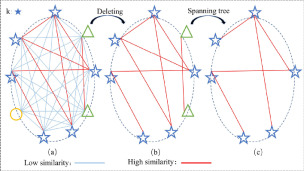

Figure 1. Principle of Spanning tree pseudolabels selection. It consists of two steps: (i) Deleting, which deletes the samples with low pairwise similarity scores
as shown from Fig. (a) to Fig. (b), and (ii) spanning tree, which selects samples with highly-confident pseudo labels by spanning trees
as shown from Fig. (b) to Fig. (c).

***normCVAE***

As opposed to the existing methods of UDA, SPL and spanning trees strategies do not aim to explicitly address the distribution discrepancy. Instead, they focuse on the issue of training data scarcity. Following this direction, we also employ a normCVAE model to further address the training data scarcity issue in the target domain by generating synthetic target domain features from labelled source domain ones as propoed by [[1]](https://doi.org/10.48550/arXiv.2012.00848).

The pseudolabels obtained were employed as input for the normCVAE which was subsequently used to generate synthetic features for the training of the classifier. By augmenting the training data with the use of normCVAE, the classifier is trained on a larger dataset sampled from the real distrbution (real labeled and pseudolabeled data) and from the CVAE-learned approximation of it (sythetic features), thus improving its ability to generalize to the target domain.


In details, the proposed generative model is based on conditional VAE (CVAE) and is conditioned on domain labels rather than class labels. Given an input sample $x$ from the source or target domain, the encoder aims to learn a distribution $p_{\theta(z)}$ (approximated by $q_{\phi}(z|x, d)$) from which
the latent encoding vector $z$ can be sampled and subsequently fed into the decoder to reconstruct the input feature $\hat{x}$, where
$d$ denotes the domain label condition. The
decoder can be parameterized by $p_{θ}(x|z,d)$. As a result, the
model is expected to generate synthetic target domain samples
from those in the source domain and vice versa.


normCAVE differs from traditional CVAE for two main aspects:


1.   Replacing the $KL$-divergence regularization with $L_2$ normalization on the output of the encoder
2.   Training the model with paired source and target domain samples belonging to the same class (considering label for source and pseudolaber for target)

Moreover, we train the model by collecting a set of reconstractions $\{\hat{x^s},\hat{x^{st}},\hat{x^{t}},\hat{x^{ts}} \}$ generated from paired training examples. The proposed loss loss function is formulated as:

$\mathcal{L}_{normCVAE}(\phi, \theta, x ) = (\mathcal{L}_{recon}(x^s,\hat{x}^s +\mathcal{L}_{recon}(x^t,\hat{x}^t)) + (\mathcal{L}_{cross-recon}(x^s,\hat{x}^{ts}) + \mathcal{L}_{cross-recon}(x^t,\hat{x}^{st}))$

The first two terms measure the reconstruction errors for source and target domain samples respectively. The last two terms are cross-domain reconstruction errors. To reduce the cross-domain reconstruction errors, the encoder has to preserve class information in the latent code space. As a result, the use of cross-domain reconstruction loss $\mathcal{L}_{cross-recon}$  facilitates the model to generate class discriminative synthetic data across domains.


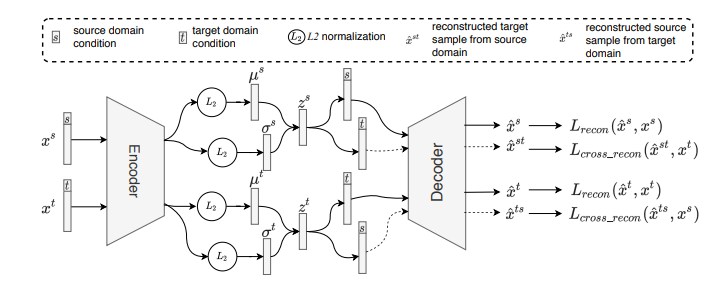

Figure 2. The diagram of norm-VAE used for data augmentation. The encoder and decoder are conditioned on the domain label $𝑠$ or $𝑡$. Given a source domain
sample $𝑥^𝑠$ as the input, the model generates reconstructed samples ${\hat{x}}^{s}$ and ${\hat{x}}^{st}$ in the source and target domains respectively. Similarly, the model can take a
target domain sample $𝑥^𝑡$ as the input and generates ${\hat{x}}^{t}$ and ${\hat{x}}^{ts}$ .

More details on the fresh part of the networks and training strategies are provided in the dedicated sections of the report.

# Coding realted part

## How to run the notebook



Modules and functions

In [ ]:
!pip install -q umap-learn
!pip install -q wandb
!pip install -q --upgrade scikit-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 25.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 28.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 23.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 209.4/209.4 kB 26.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 87.5 MB/s eta 0:00:00


In [ ]:
import os
from os import makedirs, listdir
from os.path import join
from shutil import copytree, move, rmtree, copyfile
from tqdm.auto import tqdm, trange
from google.colab import drive

import pandas as pd
import numpy as np
import multiprocessing
import random

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from sklearn import metrics
from sklearn.decomposition import PCA
from umap import UMAP
from IPython.display import HTML
from PIL import Image

import torch
import torch.nn as nn
import torchvision
import torchvision.datasets as datasets
import torch.nn.functional as F
from torchvision.transforms import transforms
from torch.utils.data import  RandomSampler, DataLoader, Dataset
from torchvision.datasets import ImageFolder

import wandb


Set a seed

In [ ]:
random.seed(456)
np.random.seed(456)
torch.manual_seed(456)

## Dataset: dataloading and analysis

### Data exploration

***DATASET***

In this project we used a subset of the Adaptiope  [[3]](
https://paperswithcode.com/dataset/adaptiope) object recognition dataset. We extracted 20 randomly chosen categories from the `product` and `real world` domains. The chosen categories are the following: ```
backpack, bookcase, car jack, comb, crown, file cabinet, flat iron, game controller,
glasses, helicopter, ice skates, letter tray, monitor, mug, network switch, over-ear headphones, pen, purse,
stand mixer and stroller.```


In [ ]:
drive.mount('/content/gdrive')

In [ ]:
!mkdir dataset
!cp "gdrive/My Drive/datasets/Adaptiope.zip" dataset/
!ls dataset

In [ ]:
!unzip -q dataset/Adaptiope.zip

In [ ]:
!rm -rf adaptiope_small

In [ ]:
!mkdir adaptiope_small
classes = listdir("Adaptiope/product_images")
classes = ["backpack", "bookcase", "car jack", "comb", "crown", "file cabinet", "flat iron", "game controller", "glasses",
           "helicopter", "ice skates", "letter tray", "monitor", "mug", "network switch", "over-ear headphones", "pen",
           "purse", "stand mixer", "stroller"]
for d, td in zip(["Adaptiope/product_images", "Adaptiope/real_life"], ["adaptiope_small/product_images", "adaptiope_small/real_life"]):
  makedirs(td)
  for c in tqdm(classes):
    c_path = join(d, c)
    c_target = join(td, c)
    copytree(c_path, c_target)

Visualization of the images within the two domains

In [ ]:
def display_images(dataset_dir, domain_name, class_names, image_files, num_rows=2, num_columns=10, image_size=(4, 4)):

    fig, axes = plt.subplots(num_rows, num_columns, figsize=(image_size[0] * num_columns, image_size[1] * num_rows))
    fig.suptitle(domain_name.upper(), fontsize=60)

    for i, (class_name, image_file) in enumerate(zip(class_names, image_files)):
        row_index = i // num_columns
        col_index = i % num_columns

        image_path = os.path.join(dataset_dir, domain_name, class_name, image_file)
        image = plt.imread(image_path)

        axes[row_index, col_index].imshow(image)
        axes[row_index, col_index].axis('on')
        axes[row_index, col_index].set_title(class_name, fontsize=40)

    plt.tight_layout()
    plt.show()
    print("\n\n")


def display_images_domain(dataset_dir, domain_name, class_names, num_rows=2, num_columns=10, image_size=(4, 4)):

    domain_dir = os.path.join(dataset_dir, domain_name)
    image_files = []
    for class_name in class_names:
        class_dir = os.path.join(domain_dir, class_name)
        image_file = random.choice(os.listdir(class_dir))
        image_files.append(image_file)

    display_images(dataset_dir, domain_name, class_names, image_files, num_rows, num_columns, image_size)


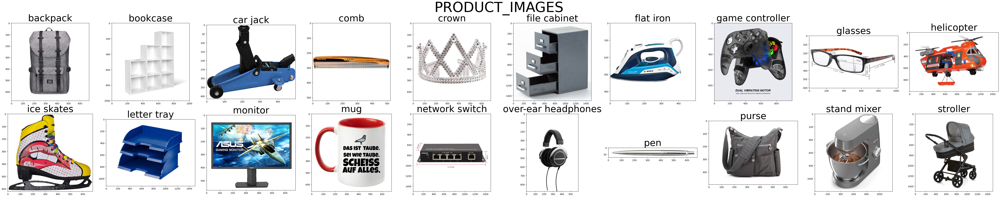

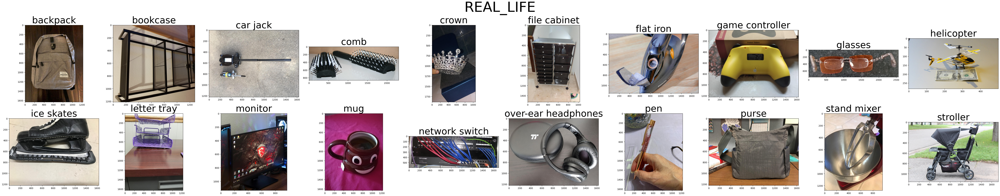

In [ ]:
root= "/content/gdrive/MyDrive/datasets/adaptiope_small/"
domains = ["product_images", "real_life"]
classes = ["backpack", "bookcase", "car jack", "comb", "crown", "file cabinet", "flat iron", "game controller", "glasses",
           "helicopter", "ice skates", "letter tray", "monitor", "mug", "network switch", "over-ear headphones", "pen",
           "purse", "stand mixer", "stroller"]

for domain in domains:
  display_images_domain(root, domain, classes, num_rows=2, num_columns=10, image_size=(6, 6))


There are several key differences between the two domains that can affect the solution of the UDA problem.

One notable distinction is that the real domain images often feature objects framed within a context. This means that in addition to the main object of interest, there may be a background and other objects present in the image. On the other hand, the product domain images consistently have a white background. This dissimilarity in backgrounds can introduce a bias in the UDA problem.

Furthermore, another challenge arises from the variability in image sizes within the dataset. The images in both domains can have different dimensions, which can complicate the feature extraction process. Inconsistent image sizes can hinder the model's ability to learn domain-invariant features and lead to suboptimal performance during domain adaptation.

We tried to incorporate some solutions within the pseudolabels approaches to also mitigate the biases introduced by background differences and varying image sizes.


### Loading the dataset

***`TwoModalDataLoader` class details***

In the `TwoModalDataLoader` class, there are three different phases: `train`, `test`, and `target`. The distinction between them enables flexible access to the data according to the specific requirements of training, testing, and pseudolabeling processes.
1.   Train Phase: This phase is used during the training of both classifier and CVAE models. It provides access to the source domain training samples paired with target training examples with a compatible pseudolabel, if available.
3. Target Phase: This phase is specifically used for the pseudolabeling process. It iterates over target_train samples allowing the updating of pseudolabels based on model predictions.
2.  Test Phase: This phase is used for evaluating the performance of a trained model on the target domain test set.

The phase distinction is particularly crucial in the `__getitem__` method. In the target phase, the model is responsible of retrieving elements from terget_train on which we will then performing pseudolabelling. The test phase is instead needed to sample from the target domain test dataset ensuring that the elements used in the evaluation of the model were never used before. In the train phase,
the model first retrieves an example from the source_domain training dataset (`source_image`, `source_label`). Then, it searches for indices of target domain samples with the same label as the source domain sample. The coupled training examples are a key aspect of the normCVAE training.



PSEUDOLABELS UPDATING WITH SPL

The `update_pseudolabels` method is responsible for updating the pseudolabels of the target samples based on the predictions the give classifier. It sets the phase to "target" and iterates over the target_train dataset to obtain predictions using the provided model. Once all the target_train samples have been processed, the function calculates the "trustable" pseudolabels based on confidance of the model (`scores`). The process aims to select specific pseudolabeled data from the target_train domain, which will then be used for training a model in a semi-supervised learning setting. It is important to note that at each iteration we retain more and more samples from target domain, incrasing the number of pseudolabeld examples in the training set gradualy.



PSEUDOLABELS UPDATING WITH SPANNING TREES

The `update_pseudolabels_tree` function updates the pseudolabels of target_training samples using a spanning tree approach. The function iterates over the target samples and calculates the similarity matrix between samples of the same class. It sorts the similarity matrix and selects a representative sample for each class based on the highest similarity. It constructs a spanning tree by expanding layers of connected samples around the representative samples (the sample with the highest degree within the adjacency matrix is selected as the starting point). Finally, it updates the pseudolabels of the trustable samples.

This function calls several other functions to perform its task:


*   `intra_class_similarity`: This function calculates the cosine similarity between pairs of samples within a class based on their input features.
*   `sorting_matrix`: This function is used to sort the similarity matrix in descending order. The sorting is necessary to select the top-k similar samples as neighbors for each class.
*   `create_tree`: This function constructs a spanning tree based on an adjacency matrix and a starting index. It recursively selects connected samples based on their positions in the adjacency matrix and returns the resulting spanning tree.

Each function plays a crucial role in the overall process of updating the pseudolabels using a spanning tree approach.

In [ ]:

class TwoModalDataLoader(Dataset):

    def __init__(self, phase='train', root= "/content/gdrive/MyDrive/datasets/adaptiope_small/", image_size=(224, 224), source_domain = "product_images", **kwargs):

        valid_domains = ["product_images", "real_life"]
        assert source_domain in valid_domains,  'Attention! the two only valid domains are "product_images" and "real_life"'
        valid_domains.remove(source_domain)
        self.sd, self.td = source_domain, *valid_domains

        self.phase = phase
        self.root = root
        self.source_dataset = self.source_train_dataset = self.source_test_dataset = None # placeholder values dictated by PEPs
        self.target_dataset = self.target_train_dataset = self.target_test_dataset = None

        self.image_size = image_size

        self.dataset_loader()
        self.pseudo_target = np.ones(len(self.target_train_dataset)) * -1  # Placeholder for pseudo-labels of test set
        self.pseudo_score_target = np.zeros(len(self.target_train_dataset))  # Placeholder for pseudo-scores of test set

        # For the combined model PSL+TREE
        self.pseudo_tree = kwargs.get("pseudo_tree", None)

        pseudo_root = kwargs.get("pseudo_root", None)
        if pseudo_root:
          self.load_pseudo(pseudo_root)


    def dataset_loader(self):

        transformation = transforms.Compose([
              transforms.Resize(self.image_size),
              transforms.ToTensor(),
              transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
          ])
        source_dataset = torchvision.datasets.ImageFolder(root=self.root + self.sd, transform=transformation)
        target_dataset = torchvision.datasets.ImageFolder(root=self.root + self.td, transform=transformation)
        generator1 = torch.Generator().manual_seed(42)
        source_train, source_test = torch.utils.data.random_split(source_dataset, [0.8,0.2], generator=generator1)
        target_train, target_test = torch.utils.data.random_split(target_dataset, [0.8,0.2], generator=generator1)

        self.source_dataset, self.source_train_dataset, self.source_test_dataset = source_dataset, source_train, source_test
        self.target_dataset, self.target_train_dataset, self.target_test_dataset = target_dataset, target_train, target_test


    def __len__(self):
        if self.phase == 'train':
            return len(self.source_train_dataset)
        elif self.phase == "test":
            return len(self.target_test_dataset)
        else:
            return len(self.target_train_dataset)


    def __getitem__(self, idx):

        if self.phase == 'target':
            idx_test = idx
            return self.target_train_dataset[idx_test]

        if self.phase == 'test':
            idx_test = idx
            return self.target_test_dataset[idx_test]

        # For training phase
        source_image, source_label = self.source_train_dataset[idx]

        # Find indices of target domain samples with the same label as the source domain sample
        indices_test_this_label = np.argwhere(self.pseudo_target == source_label)
        indices_test_this_label = indices_test_this_label.squeeze()

        if len(indices_test_this_label) > 0:
            idx_test = np.random.choice(indices_test_this_label)
            return source_image, self.target_train_dataset[idx_test][0], source_label, self.pseudo_target[idx_test]

        else:
            idx_test = np.random.randint(len( self.target_train_dataset))
            return source_image, self.target_train_dataset[idx_test][0], source_label, np.ones_like(source_label) * -1


    def save_pseudo(self, path):
      np.savez(path, labels=self.pseudo_target, scores=self.pseudo_score_target)


    def load_pseudo(self, path):
      f = np.load(path)
      self.pseudo_target = f["labels"]
      self.pseudo_score_target = f["scores"]

      # Modification for the combined model PSL+TREE
      if self.pseudo_tree: self.update_pseudolabels_tree()


    # PSEUDOLABELS UPDATING WITH PSL

    def update_pseudolabels(self, model, it=0, total_it = 10):
      device = "cuda" if torch.cuda.is_available() else "cpu"
      model.eval()
      old_phase = self.phase
      self.phase = "target"
      self.pseudo_target = -1*np.ones_like(self.pseudo_target)

      loader =  DataLoader(dataset=self, batch_size=32, shuffle=False, num_workers = 2)
      model.to(device)
      with torch.no_grad():
        for i, (x, y) in enumerate(tqdm(loader, desc = "Pseudolabeling target samples")):

          x, y = x.to(device), y.to(device)
          preds = model(x)
          preds = preds.cpu().detach().numpy()
          out_preds = preds if i < 1 else  np.concatenate((out_preds, preds), 0)

      preds = np.argmax(out_preds,1)
      scores = np.exp(np.max(out_preds,1))
      trustable = np.zeros((len(preds),),dtype=np.int32)
      numSelected = np.int32((1+it)/total_it*len(preds)/20)

      for iCls in trange(20, desc = "Selecting examples for each class"):
          thisClassFlag = preds==iCls
          numThisClass = thisClassFlag.sum()

          if numThisClass > 0:
              threshold = sorted(scores[thisClassFlag],reverse=True)[min(numThisClass-1,numSelected)]
              trustable = trustable + np.int32((scores>=threshold) & thisClassFlag)

      self.pseudo_target[trustable==1] = preds[trustable==1]
      self.pseudo_score_target = scores
      self.phase = old_phase


    # PSEUDOLABELS UPDATING WITH SPANNING TREES
    # The update_pseudolabels_tree() method will work together with other methods implemented below

    def plot_matrix(similarity_matrix):
        plt.figure(figsize=(8, 6))
        plt.imshow(similarity_matrix, cmap='hot', interpolation='nearest')
        plt.colorbar(label='Similarity')
        plt.title('Similarity Matrix - Heatmap')
        plt.show()


    def sorting_matrix(similarity_matrix):

        column_sums = torch.sum(similarity_matrix != 0, dim=0)

        degrees = torch.sum(similarity_matrix, dim=0)

        value_index_list = [(value.item(), i) for i, value in enumerate(column_sums)]
        sorted_list = sorted(value_index_list, key=lambda x: x[0])

        # Move the zero elements to the end of the list
        zero_list = [item for item in sorted_list if item[0] == 0]
        nonzero_list = [item for item in sorted_list if item[0] != 0]
        sorted_list = nonzero_list + zero_list

        # Extract the sorted values and original indices
        new_order = torch.tensor([item[1] for item in sorted_list])
        sorted_similarity_matrix = similarity_matrix[:, new_order]

        return sorted_similarity_matrix, new_order


    def intra_class_similarity( data):

        num_samples = data.size(0)
        similarity_matrix = torch.zeros((num_samples, num_samples)) # initialization of the similarity matrix

        for i in tqdm(range(num_samples)):
            for j in range(i+1, num_samples):
                img1 = data[i]
                img2 = data[j]

                img1 = img1.view(-1)
                img2 = img2.view(-1)

                similarity = F.cosine_similarity(img1.unsqueeze(0), img2.unsqueeze(0))
                similarity = max(similarity, 0)  # Set negative cosine similarities to zero
                similarity_matrix[i, j] = similarity
                similarity_matrix[j, i] = similarity

        sorted_similarity_matrix, new_order = TwoModalDataLoader.sorting_matrix(similarity_matrix)
        sorted_similarity_matrix = sorted_similarity_matrix.triu(diagonal=1)
        TwoModalDataLoader.plot_matrix(sorted_similarity_matrix)

        return sorted_similarity_matrix, new_order


    def create_tree( similar: torch.Tensor, index_i, position):

        span_tree = [index_i.item()]
        next_layer = position[similar[index_i, :] > 0].numpy().tolist()
        span_tree.extend(next_layer)
        similar[index_i, :] = 0
        similar[:, index_i] = 0
        num_layers = 2  # Number of layers to expand the tree, NB. zero based

        for _ in range(num_layers-1):
            similar[:, next_layer] = 0
            next_layer = position[similar[next_layer, :].sum(0) > 0].numpy().tolist()
            similar[next_layer, :] = 0
            if len(next_layer) > 0:
                span_tree.extend(next_layer)

        return span_tree


    def update_pseudolabels_tree(self, model=None, it=0, numSelected=100, threshold = 0.8):

      trustable_indices = []
      input_data = []  # List to store the input data

      if model is not None:
          model.eval()
          old_phase = self.phase
          self.phase = "target"
          self.pseudo_target = -1*np.ones_like(self.pseudo_target)

          loader =  DataLoader(dataset=self, batch_size=32, shuffle=False, num_workers = 2)
          model.to(device)

          with torch.no_grad():
            for i, (x, y) in enumerate(tqdm(loader, desc = "Pseudolabeling target samples")):

              x, y = x.to(device), y.to(device)
              preds = model(x)
              preds = preds.cpu().detach().numpy()
              out_preds = preds if i < 1 else  np.concatenate((out_preds, preds), 0)
              input_data.append(x.cpu().detach().numpy())  # Save the input data

          pseudolabels = np.argmax(out_preds,1)
          input_data_tensor = torch.cat([torch.from_numpy(arr) for arr in input_data], dim=0)

          self.phase = old_phase

      else:
        pseudolabels = self.pseudo_target
        input_data_tensor = torch.cat([tensor[0] for tensor in self.target_train_dataset], dim=0)

      trustable = np.zeros((len(pseudolabels),),dtype=np.int32)

      for iCls in trange(20, desc = "Selecting examples for each class"):
          thisClassFlag = pseudolabels==iCls
          numThisClass = thisClassFlag.sum()
          print("iCls", iCls)
          print("numThisClass", numThisClass)

          if numThisClass > 0:
              indices = torch.nonzero(torch.tensor(thisClassFlag)).squeeze()
              subset_features = input_data_tensor[indices]

              similarity, new_order = TwoModalDataLoader.intra_class_similarity(subset_features)
              max_similarity = similarity.max().max() * threshold
              adjacency_matrix = (similarity >= max_similarity).float()
              degree = adjacency_matrix.sum(dim=1)
              index_i = degree.argmax()
              span_tree = TwoModalDataLoader.create_tree(adjacency_matrix, index_i, new_order)

              translated_span_tree = indices[span_tree]

              # Keep track of the indices of the representative data
              trustable_indices.extend(translated_span_tree[:min(len(translated_span_tree), numSelected)])

              print('# Trustable:', len(translated_span_tree))
              for idx, label in enumerate(pseudolabels):
                  if idx in trustable_indices:
                      trustable[idx] = 1

      self.pseudo_target[trustable==1] = pseudolabels[trustable==1]

      if model is None:
          self.pseudo_target[trustable!=1] = -1



Check the balance of the classes within train and test sets of both domains

In [ ]:
def check_balance(dataset, train, test):
    classes = [
        "backpack", "bookcase", "car jack", "comb", "crown", "file cabinet", "flat iron", "game controller", "glasses",
        "helicopter", "ice skates", "letter tray", "monitor", "mug", "network switch", "over-ear headphones", "pen",
        "purse", "stand mixer", "stroller"]

    labels = pd.Series([classes[d[1] - 1] for d in tqdm(dataset, desc="counting the labels in full dataset")])
    train_labels = pd.Series([classes[d[1] - 1] for d in tqdm(train, desc="counting the labels in train dataset")])
    test_labels = pd.Series([classes[d[1] - 1] for d in tqdm(test, desc="counting the labels in test dataset")])

    full_counts = labels.value_counts().rename("Full Dataset")
    train_counts = train_labels.value_counts().rename("Train Dataset")
    test_counts = test_labels.value_counts().rename("Test Dataset")

    df = pd.DataFrame({"Full Dataset": full_counts, "Train Dataset": train_counts, "Test Dataset": test_counts})
    print(df)


In [ ]:
data_loader = TwoModalDataLoader()
data_loader.dataset_loader()

dataset_prod = data_loader.source_dataset
train_prod = data_loader.source_train_dataset
test_prod = data_loader.source_test_dataset

check_balance(dataset_prod, train_prod, test_prod)

counting the labels in full dataset:   0%|          | 0/2000 [00:00<?, ?it/s]

counting the labels in train dataset:   0%|          | 0/1600 [00:00<?, ?it/s]

counting the labels in test dataset:   0%|          | 0/400 [00:00<?, ?it/s]

                     Full Dataset  Train Dataset  Test Dataset
backpack                      100             78            22
bookcase                      100             78            22
car jack                      100             85            15
comb                          100             77            23
crown                         100             78            22
file cabinet                  100             77            23
flat iron                     100             76            24
game controller               100             85            15
glasses                       100             77            23
helicopter                    100             78            22
ice skates                    100             81            19
letter tray                   100             80            20
monitor                       100             77            23
mug                           100             84            16
network switch                100             76       

In [ ]:
data_loader = TwoModalDataLoader(source_domain = "real_life")
data_loader.dataset_loader()

dataset_rl = data_loader.source_dataset
train_rl = data_loader.source_train_dataset
test_rl = data_loader.source_test_dataset

check_balance(dataset_rl, train_rl, test_rl)

counting the labels in full dataset:   0%|          | 0/2000 [00:00<?, ?it/s]

counting the labels in train dataset:   0%|          | 0/1600 [00:00<?, ?it/s]

counting the labels in test dataset:   0%|          | 0/400 [00:00<?, ?it/s]

                     Full Dataset  Train Dataset  Test Dataset
backpack                      100             78            22
bookcase                      100             78            22
car jack                      100             85            15
comb                          100             77            23
crown                         100             78            22
file cabinet                  100             77            23
flat iron                     100             76            24
game controller               100             85            15
glasses                       100             77            23
helicopter                    100             78            22
ice skates                    100             81            19
letter tray                   100             80            20
monitor                       100             77            23
mug                           100             84            16
network switch                100             76       

## Utils

### Coding related functions

In [ ]:
def idx2onehot(idx, n):

    assert torch.max(idx).item() < n
    if idx.dim() == 1:
        idx = idx.unsqueeze(1)

    onehot = torch.zeros(idx.size(0), n)
    onehot.scatter_(1, idx, 1)

    return onehot

Implementation of a function to extract features form ResNet-50 and normCVAE for visualization purposes.

In [ ]:
def extract_features(data, cvae_model_path=None):

    device = "cuda" if torch.cuda.is_available() else "cpu"

    res50 = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)
    # Freezing the resnet50 params
    for param in res50.parameters():
        param.requires_grad = False
    # Initialization of the pretrained feature extractor
    res50fe = torch.nn.Sequential(*list(res50.children())[:-1])
    model = res50fe.to(device)
    Xfe = dict()
    Yfe = dict()

    if cvae_model_path is not None:
        cvae = CVAE()
        cvae.load(cvae_model_path)
        cvae.eval()
        model = cvae.to(device)
        Xrecon = dict()

    sampler = RandomSampler(data)
    dataloader = DataLoader(data, sampler=sampler, batch_size=32, num_workers=2)
    iterator = tqdm(dataloader, desc="Step", position=1, leave=True)

    for (xS, xT, yS, yT) in iterator:
        yS, yT =  yS.type(torch.LongTensor), yT.type(torch.LongTensor)
        xS, xT, yS, yT = xS.to(device), xT.to(device), yS.to(device), yT.to(device)

        xT, xS = res50fe(xT),  res50fe(xS)

        xS = xS.reshape(32,-1).squeeze()
        xT = xT.reshape(32,-1).squeeze()

        if cvae_model_path is not None:
            recon_xS,recon_xT = cvae.generate_z(xS,xT, device)

        mask = yT!=-1
        xT = xT[mask,:]
        yT = yT[mask]

        if cvae_model_path is not None:
            recon_xT = recon_xT[mask,:]
            recon_xS, recon_xT  = recon_xS.to("cpu"), recon_xT.to("cpu")

        xS, xT, yS, yT = xS.to("cpu"), xT.to("cpu"), yS.to("cpu"), yT.to("cpu")

        Xfe["source"] = torch.cat((Xfe.get("source", torch.Tensor()),xS),dim=0)
        Xfe["target"] = torch.cat((Xfe.get("target", torch.Tensor()),xT),dim=0)
        Yfe["source"] = torch.cat((Yfe.get("source", torch.Tensor()),yS),dim=0)
        Yfe["target"] = torch.cat((Yfe.get("target", torch.Tensor()),yT),dim=0)

        if cvae_model_path is not None:
            Xrecon["source"] = torch.cat((Xrecon.get("source", torch.Tensor()),recon_xS),dim=0)
            Xrecon["target"] = torch.cat((Xrecon.get("target", torch.Tensor()),recon_xT),dim=0)


    Xfe = {k: i.detach().numpy() for k,i in Xfe.items()}
    Yfe = {k: i.detach().numpy() for k,i in Yfe.items()}

    if cvae_model_path is not None:
        Xrecon = {k: i.detach().numpy() for k,i in Xrecon.items()}
        return Xfe, Yfe, Xrecon, Yfe

    return Xfe, Yfe

### Visualization

**Visualization of the feature spaces: (SOURCE vs TARGET) * (RESNET vs CVAE)**

The `plot_feature_comparison()` function serves to compare the feature spaces of two datasets, namely the source_data and target_data, by utilizing dimensionality reduction techniques like Principal Component Analysis (PCA) and Uniform Manifold Approximation and Projection (UMAP). It creates a 2x2 grid of subplots that effectively illustrate these comparisons.

For each dimensionality reduction technique, the first plot enables a comprehensive assessment of the real features derived from the penultimate layer of the ResNet50 model and the synthetic features obtained from the CVAE. The second plot enhances the visualization by incorporating the distribution of labels assigned to each sample. This additional layer of information aids in understanding the relationship between the features and their corresponding labels, facilitating a more comprehensive analysis of the datasets.

In [ ]:
def plot_feature_comparison(resnet_features, vae_features, resnet_labels, vae_labels):

    # Unpack source data
    source_resnet_features = resnet_features["source"]
    source_vae_features = vae_features["source"]
    source_resnet_labels = resnet_labels["source"].astype(int)  # Convert to integers
    source_vae_labels = vae_labels["source"].astype(int)  # Convert to integers

    # Unpack target data
    target_resnet_features = resnet_features["target"]
    target_vae_features = vae_features["target"]
    target_resnet_labels = resnet_labels["target"].astype(int)  # Convert to integers
    target_vae_labels = vae_labels["target"].astype(int)  # Convert to integers

    # PCA
    pca = PCA(n_components=min(source_resnet_features.shape[1], source_resnet_features.shape[0]))
    umap = UMAP(n_components=2)

    reduced_source_resnet_features_pca = pca.fit_transform(source_resnet_features)
    reduced_source_vae_features_pca = pca.transform(source_vae_features)
    reduced_target_resnet_features_pca = pca.transform(target_resnet_features)
    reduced_target_vae_features_pca = pca.transform(target_vae_features)

    reduced_source_resnet_features_umap = umap.fit_transform(reduced_source_resnet_features_pca)
    reduced_source_vae_features_umap = umap.transform(reduced_source_vae_features_pca)
    reduced_target_resnet_features_umap = umap.transform(reduced_target_resnet_features_pca)
    reduced_target_vae_features_umap = umap.transform(reduced_target_vae_features_pca)

    # Color map for both ResNet and VAE
    unique_labels = np.unique(np.concatenate((source_resnet_labels, source_vae_labels, target_resnet_labels, target_vae_labels)))
    label_color_map = plt.get_cmap('tab10', len(unique_labels))

    fig, axes = plt.subplots(2, 2, figsize=(12, 12))

    # PCA without labels
    ax1 = axes[0, 0]
    ax1.scatter(reduced_source_resnet_features_pca[:, 0], reduced_source_resnet_features_pca[:, 1], color='red', marker='o', facecolors='none', edgecolors='r', linewidths=1.5, label='Source ResNet')
    ax1.scatter(reduced_source_vae_features_pca[:, 0], reduced_source_vae_features_pca[:, 1], color='cyan', marker='p', facecolors='none', edgecolors='cyan', linewidths=1.5, label='Source VAE')
    ax1.scatter(reduced_target_resnet_features_pca[:, 0], reduced_target_resnet_features_pca[:, 1], color='blue', marker='s', facecolors='none', edgecolors='blue', linewidths=1.5, label='Target ResNet')
    ax1.scatter(reduced_target_vae_features_pca[:, 0], reduced_target_vae_features_pca[:, 1], color='lime', marker='v', facecolors='none', edgecolors='lime', linewidths=1.5, label='Target VAE')
    ax1.set_title('Feature Space Comparison with PCA')
    ax1.legend()

    # PCA with labels
    ax2 = axes[0, 1]
    resnet_scatter_pca = ax2.scatter(reduced_source_resnet_features_pca[:, 0], reduced_source_resnet_features_pca[:, 1], c=source_resnet_labels, cmap=label_color_map, marker='o', label='Source ResNet')
    vae_scatter_pca = ax2.scatter(reduced_source_vae_features_pca[:, 0], reduced_source_vae_features_pca[:, 1], c=source_vae_labels, cmap=label_color_map, marker='p', label='Source VAE')
    resnet_scatter_pca = ax2.scatter(reduced_target_resnet_features_pca[:, 0], reduced_target_resnet_features_pca[:, 1], c=target_resnet_labels, cmap=label_color_map, marker='s', label='Target ResNet')
    vae_scatter_pca = ax2.scatter(reduced_target_vae_features_pca[:, 0], reduced_target_vae_features_pca[:, 1], c=target_vae_labels, cmap=label_color_map, marker='v', label='Target VAE')
    ax2.set_title('Feature Space Comparison with PCA')

    # Legend
    handles_source_resnet_pca = []
    handles_source_vae_pca = []
    handles_target_resnet_pca = []
    handles_target_vae_pca = []
    for label in unique_labels:
        handles_source_resnet_pca.append(ax2.scatter([], [], c=[label_color_map(label)], marker='o', label=str(label)))
        handles_source_vae_pca.append(ax2.scatter([], [], c=[label_color_map(label)], marker='p', label=str(label)))
        handles_target_resnet_pca.append(ax2.scatter([], [], c=[label_color_map(label)], marker='s', label=str(label)))
        handles_target_vae_pca.append(ax2.scatter([], [], c=[label_color_map(label)], marker='v', label=str(label)))
    ax2.legend(handles_source_resnet_pca + handles_source_vae_pca + handles_target_resnet_pca + handles_target_vae_pca, unique_labels, title='Labels')

    # UMAP without labels
    ax3 = axes[1, 0]
    ax3.scatter(reduced_source_resnet_features_umap[:, 0], reduced_source_resnet_features_umap[:, 1], color='red', marker='o', facecolors='none', edgecolors='r', linewidths=1.5, label='Source ResNet')
    ax3.scatter(reduced_source_vae_features_umap[:, 0], reduced_source_vae_features_umap[:, 1], color='cyan', marker='p', facecolors='none', edgecolors='cyan', linewidths=1.5, label='Source VAE')
    ax3.scatter(reduced_target_resnet_features_umap[:, 0], reduced_target_resnet_features_umap[:, 1], color='blue', marker='s', facecolors='none', edgecolors='blue', linewidths=1.5, label='Target ResNet')
    ax3.scatter(reduced_target_vae_features_umap[:, 0], reduced_target_vae_features_umap[:, 1], color='lime', marker='v', facecolors='none', edgecolors='lime', linewidths=1.5, label='Target VAE')
    ax3.set_title('Feature Space Comparison with UMAP')
    ax3.legend()

    # UMAP with labels
    ax4 = axes[1, 1]
    resnet_scatter_umap = ax4.scatter(reduced_source_resnet_features_umap[:, 0], reduced_source_resnet_features_umap[:, 1], c=source_resnet_labels, cmap=label_color_map, marker='o', label='Source ResNet')
    vae_scatter_umap = ax4.scatter(reduced_source_vae_features_umap[:, 0], reduced_source_vae_features_umap[:, 1], c=source_vae_labels, cmap=label_color_map, marker='p', label='Source VAE')
    resnet_scatter_umap = ax4.scatter(reduced_target_resnet_features_umap[:, 0], reduced_target_resnet_features_umap[:, 1], c=target_resnet_labels, cmap=label_color_map, marker='s', label='Target ResNet')
    vae_scatter_umap = ax4.scatter(reduced_target_vae_features_umap[:, 0], reduced_target_vae_features_umap[:, 1], c=target_vae_labels, cmap=label_color_map, marker='v', label='Target VAE')
    ax4.set_title('Feature Space Comparison with UMAP')

    # Legend
    handles_source_resnet_umap = []
    handles_source_vae_umap = []
    handles_target_resnet_umap = []
    handles_target_vae_umap = []
    for label in unique_labels:
        handles_source_resnet_umap.append(ax4.scatter([], [], c=[label_color_map(label)], marker='o', label=str(label)))
        handles_source_vae_umap.append(ax4.scatter([], [], c=[label_color_map(label)], marker='p', label=str(label)))
        handles_target_resnet_umap.append(ax4.scatter([], [], c=[label_color_map(label)], marker='s', label=str(label)))
        handles_target_vae_umap.append(ax4.scatter([], [], c=[label_color_map(label)], marker='v', label=str(label)))
    ax4.legend(handles_source_resnet_umap + handles_source_vae_umap + handles_target_resnet_umap + handles_target_vae_umap, unique_labels, title='Labels')

    for ax_row in axes:
        for ax in ax_row:
            ax.set_xlabel('Component 1')
            ax.set_ylabel('Component 2')

    # Show the plots
    plt.tight_layout()
    plt.show()


## Models and traing loops

### Source-only baseline

The source-only baseline simply consists of a model trained on the source domain and evaluated on the target domain, without any pseudolabeling strategy involved.


#### Model

The baseline model architecture utilizes a pre-trained ResNet-50 as a feature extractor. It then applies fully connected layers and activation functions to transform the features and produce a probability distribution over the 20 classes. The architecture of the baseline model is an implementation of the base classifier proposed by  [[1]](https://doi.org/10.48550/arXiv.2012.00848) with the addition of the feature extraction part.

In [ ]:
class baselineRES(nn.Module):

    def __init__(self, num_labels=10):

        super(baselineRES, self).__init__()
        res50 = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)

        # Freezing the resnet50 params
        for param in res50.parameters():
            param.requires_grad = False

        # Initialization of the pretrained feature extractor
        self.fe = nn.Sequential(*list(res50.children())[:-1])

        # last layer of Resnet50 that we keep has features of d = 2048
        self.fc = nn.Linear(2048, 128)
        self.relu = nn.ReLU()

        self.fc1 = nn.Linear(128, num_labels)
        self.logic = nn.LogSoftmax(dim=1)

        self.lossfunction = nn.NLLLoss()

    def forward(self, x):

        batch_size, _, _, _ = x.shape  # taking out batch_size from input
        x = self.fe(x)
        x = self.fc(x.reshape(batch_size,-1))
        x = self.relu(x)
        x = self.fc1(x)
        x = self.logic(x)

        return x

    def save(self, PATH):
        torch.save(self.state_dict(), PATH)

    def load(self, PATH):
        device = "cuda" if torch.cuda.is_available() else "cpu"
        self.load_state_dict(torch.load(PATH, map_location=torch.device(device)))


#### Training

This Trainer, like the others within this project, provides a framework for training and evaluating a model. PyTorch is used for model training and evaluation, whereas wandb for logging and visualization.

In [ ]:

class BaselineTrainer:

    def __init__(self, train_data, validation_data=None, test_data=None):

        self.model = baselineRES(20)
        self.train_dataset = train_data
        self.valid_dataset = validation_data
        self.test_dataset = test_data

        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model.to(self.device)

        self.optimizer = torch.optim.Adagrad(filter(lambda p: p.requires_grad, self.model.parameters()),
                                             lr=0.02698316777715989, weight_decay=0.009751463932235218)
        self.loss_crit = self.model.lossfunction


    def train(self, log_str=""):

        wandb.init(project="UDA",
                   entity="uda-dl",
                   name=f"{t.model.__class__.__name__} {log_str}")

        wandb.config = {
            "learning_rate": 0.02698,
            "epochs": 10,
            "batch_size": 32}
        wandb.watch(self.model, log="all", log_freq=1)

        train_sampler = RandomSampler(self.train_dataset)
        train_dataloader = DataLoader(self.train_dataset, sampler=train_sampler, batch_size=32, num_workers=4)

        epoch_iter = trange(10, desc="Epoch", position=0)
        for _ in epoch_iter:
            train_iter = tqdm(train_dataloader, desc="Step", position=1, leave=False)
            train_loss = list()
            self.model.train()
            for (x, y) in train_iter:
                x = x.to(self.device)
                y = y.to(self.device)

                output = self.model(x)

                loss = self.loss_crit(output, y)
                train_loss.append(loss.item())

                self.optimizer.zero_grad()
                loss.backward()
                self.optimizer.step()

            eval_loss, auc = self.eval(self.valid_dataset)
            wandb.log({"train_loss": np.asarray(train_loss).mean(),
                       "eval_loss": np.asarray(eval_loss).mean(),
                       "auc": np.asarray(auc).mean()})
        wandb.finish()


    def eval(self, data, **kwargs):

        confusion_matrix = kwargs.get("confusion_matrix", False)
        num_class = 20
        running_corrects = np.zeros((num_class,))
        num_sample_per_class = np.zeros((num_class,))
        self.model.eval()
        eval_sampler = RandomSampler(data)
        eval_dataloader = DataLoader(data, sampler=eval_sampler, batch_size=32, num_workers = 2)
        eval_iter = tqdm(eval_dataloader, position=0, desc="Evaluation", leave=True)

        if confusion_matrix:
            total_pred = torch.Tensor()
            total_labels = torch.Tensor()

        with torch.no_grad():
            acc = list()
            eval_loss = list()
            for (x, y) in eval_iter:
                x = x.to(self.device)
                y = y.to(self.device)
                output = self.model(x)

                loss = self.loss_crit(output, y)
                eval_loss.append(loss.item())
                pred = output.cpu().detach().numpy().reshape(output.shape[0], -1)
                pred = np.argmax(pred, 1)
                labels = y.cpu().numpy().reshape(output.shape[0])
                acc.append(np.sum(labels == pred)/len(y))
                if confusion_matrix:
                    total_pred = np.concatenate((total_pred, pred), 0)
                    total_labels = np.concatenate((total_labels, labels), 0)

            if confusion_matrix:
              classes = classes = ["backpack", "bookcase", "car jack", "comb", "crown", "file cabinet", "flat iron", "game controller", "glasses",
              "helicopter", "ice skates", "letter tray", "monitor", "mug", "network switch", "over-ear headphones", "pen",
              "purse", "stand mixer", "stroller"]
              wandb.log({"conf_mat" : wandb.plot.confusion_matrix(probs=None,
                          y_true=total_labels, preds=total_pred,
                          class_names=classes)})


            print(np.mean(acc))
            return eval_loss, acc

    wandb.finish()


### Classifier

#### Model

***Achitecture details***


The classifier's architecture is based upon the baseline. The main two differences are the addition of a dropout layer to add regularization and the option to skip the feature extraction phase and thus accepting both raw images and image features when training with CVAE sythetic features.
Another key difference with the implementation proposed by  [[1]](https://doi.org/10.48550/arXiv.2012.00848) is the use of unnormalized features.
Unnormalized features improved stability during training while alternating the use of the feature extractor.


The `extract_features` flag in the `forward` method allows flexibility in how the model is used. When it is set to `True` the output of the forward method will be the feature classification obtained by passing the input through the ResNet-50 layers and the new classification layers. On the other hand, when `extract_features` is set to `False`, the model will skip the feature extraction step and directly use the reshaped output from the linear layer as input to the subsequent layers.


***Loss function***

Negative log-likelihood loss:


$l(\theta) = -\sum^n_{i=1} {(y_i\log\hat{y}_{\theta,i}+(1-y_i)log(1-\hat{y}_{\theta,i}))}$


In [ ]:

class Classifier(nn.Module):

    def __init__(self, num_labels=10):
        super(Classifier, self).__init__()
        res50 = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)
        # Freezing the resnet50 params
        for param in res50.parameters():
            param.requires_grad = False
        # Initialization of the pretrained feature extractor
        self.fe = nn.Sequential(*list(res50.children())[:-1])
        # last layer of Resnet50 that we keep has features of d = 2048
        self.fc = nn.Linear(2048, 128)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.2)

        self.fc1 = nn.Linear(128, num_labels)
        self.logic = nn.LogSoftmax(dim=1)

        self.lossfunction = nn.NLLLoss()

    def forward(self, x, extract_features = True):
        batch_size, *_ = x.shape  # taking out batch_size from input
        if extract_features:
            x = self.fe(x)

        x = self.fc(x.reshape(batch_size,-1))
        x = self.relu(x)
        x = self.dropout(x)
        x = self.fc1(x)
        x = self.logic(x)

        return x

    def save(self, PATH):
        torch.save(self.state_dict(), PATH)

    def load(self, PATH):
        device = "cuda" if torch.cuda.is_available() else "cpu"
        self.load_state_dict(torch.load(PATH, map_location=torch.device(device)))

#### Training

In [ ]:
class Trainer:

  def __init__(self, train_data, test_data = None, base_model = None, **kwargs):

    self.train_data, self.test_data = train_data, test_data
    self.model  = Classifier(20)
    self.base_model = base_model

    self.device = "cuda" if torch.cuda.is_available() else "cpu"
    self.model.to(self.device)

    self.learning_rate =kwargs.get("learning_rate", 0.02698316777715989)
    self.optimizer = torch.optim.Adagrad(filter(lambda p: p.requires_grad, self.model.parameters()),
                                             lr=self.learning_rate, weight_decay=0.009751463932235218)
    self.loss_crit = self.model.lossfunction

    self.pseudo_tree = kwargs.get("pseudo_tree", None)

    if self.base_model and not np.any(train_data.pseudo_score_target):
      # check if we have a basline model for initial pseudolabeling or pre-computed pseudolabels
      self.base_model.to(self.device)

      if self.pseudo_tree:
          train_data.update_pseudolabels_tree(self.base_model)
          print("qui")
      else: train_data.update_pseudolabels(self.base_model)


  def train(self, **kwargs):

    epochs = kwargs.get("epochs", 5)
    batch_size = kwargs.get("batch_size", 32)
    log_str = kwargs.get("log_str","")
    vae = kwargs.get("VAE", None)
    cm = kwargs.get("confusion_matrix", True)
    if vae:
      vae.to(self.device)
      vae.eval()

    # wandb logger initialization
    wandb.init(project="UDA",
                   entity="uda-dl",
                   name=f"{self.model.__class__.__name__} {log_str}")

    wandb.config = {
        "learning_rate": 0.02698,
        "epochs": epochs,
        "batch_size": batch_size}
    wandb.watch(self.model, log="all", log_freq=1)

    epoch_iter = trange(epochs, desc="Epoch", position=0)
    for _ in epoch_iter:
        self.train_data.phase = "train"
        train_sampler = RandomSampler(self.train_data)
        train_dataloader = DataLoader(self.train_data, sampler=train_sampler, batch_size=batch_size, num_workers=2)
        train_iter = tqdm(train_dataloader, desc="Step", position=1, leave=False)
        train_loss = list()
        self.model.train()

        for (xS, xT, yS, yT) in train_iter:
            yS, yT =  yS.type(torch.LongTensor), yT.type(torch.LongTensor)
            xS, xT, yS, yT = xS.to(self.device), xT.to(self.device), yS.to(self.device), yT.to(self.device)
            if vae:
              xT, xS = self.model.fe(xT),  self.model.fe(xS)
              xS = xS.reshape(batch_size,-1).squeeze()
              xT = xT.reshape(batch_size,-1).squeeze()

              recon_xS,recon_xT = vae.generate_z(xS,xT, self.device)

            # masking high confidance pseudolabels
            mask = yT!=-1
            xT = xT[mask,:]
            yT = yT[mask]

            if vae:
              recon_xT = recon_xT[mask,:]

            xtrain = torch.cat((xS,xT),dim=0) if not vae else torch.cat((xS,xT,recon_xS,recon_xT),dim=0)
            ytrain = torch.cat((yS,yT),dim=0) if not vae else torch.cat((yS,yT,yS,yT),dim=0)

            output = self.model(xtrain, extract_features = (vae == None))

            loss = self.loss_crit(output, ytrain)
            train_loss.append(loss.item())
            self.optimizer.zero_grad()
            loss.backward()
            self.optimizer.step()

        old_phase = self.train_data.phase

        self.train_data.phase = "test"

        eval_loss, acc = self.eval(self.train_data, confusion_matrix = (cm and (_ == epochs-1)) )

        self.train_data.phase = old_phase

        wandb.log({"train_loss": np.asarray(train_loss).mean(),
                  "eval_loss": np.asarray(eval_loss).mean(),
                  "auc": np.asarray(acc).mean()})

    wandb.unwatch()
    wandb.finish()


  def eval(self, data, **kwargs):

      confusion_matrix = kwargs.get("confusion_matrix", False)
      num_class = 20
      running_corrects = np.zeros((num_class,))
      num_sample_per_class = np.zeros((num_class,))
      self.model.eval()
      eval_sampler = RandomSampler(data)
      eval_dataloader = DataLoader(data, sampler=eval_sampler, batch_size=32, num_workers = 2)
      eval_iter = tqdm(eval_dataloader, position=0, desc="Evaluation", leave=True)

      if confusion_matrix:
          total_pred = torch.Tensor()
          total_labels = torch.Tensor()

      with torch.no_grad():
          acc = list()
          eval_loss = list()
          for (x, y) in eval_iter:
              x = x.to(self.device)
              y = y.to(self.device)

              output = self.model(x)

              loss = self.loss_crit(output, y)
              eval_loss.append(loss.item())
              pred = output.cpu().detach().numpy().reshape(output.shape[0], -1)
              pred = np.argmax(pred, 1)
              labels = y.cpu().numpy().reshape(output.shape[0])
              acc.append(np.sum(labels == pred)/len(y))
              if confusion_matrix:
                  total_pred = np.concatenate((total_pred, pred), 0)
                  total_labels = np.concatenate((total_labels, labels), 0)

          if confusion_matrix:
            classes = classes = ["backpack", "bookcase", "car jack", "comb", "crown", "file cabinet", "flat iron", "game controller", "glasses",
            "helicopter", "ice skates", "letter tray", "monitor", "mug", "network switch", "over-ear headphones", "pen",
            "purse", "stand mixer", "stroller"]
            wandb.log({"conf_mat" : wandb.plot.confusion_matrix(probs=None,
                        y_true=total_labels, preds=total_pred,
                        class_names=classes)})


          print(np.mean(acc))
          return eval_loss, acc


  def iterative_train(self, iter, it = 0, **kwargs):

    start_iter = kwargs.get("resume_from", 0)
    run_name = kwargs.get("run_name","")
    cls_epochs = kwargs.get("cls_epochs", 10)

    if start_iter:
      try:
        self.model.load(f"/content/gdrive/MyDrive/models_save/{run_name}{self.train_data.sd}2{self.train_data.td}_{self.pseudo_tree}PSL_iter{start_iter}.pt")
      except FileNotFoundError:
        raise FileNotFoundError ("No compatible model for resuming with specified parameters")

      try:
        self.train_data.load_pseudo(
            f"/content/gdrive/MyDrive/datasets/pseudolabels/{self.train_data.td}/{self.pseudo_tree}PSL_iter{start_iter}.npz"
        )
      except FileNotFoundError:
        print("No pseudolabels found, generating new ones from the last model")
        if self.pseudo_tree:
            self.update_pseudolabels_tree(it=start_iter + it)
        else:
            self.update_pseudolabels(it=start_iter + it, total_it=5)
        self.train_data.save_pseudo(
            f"/content/gdrive/MyDrive/datasets/pseudolabels/{self.train_data.td}/{self.pseudo_tree}PSL_iter{start_iter}.npz"
        )

    epoch_iter = trange(start_iter, iter, desc="Iteration", position=0)
    for e in epoch_iter:

      self.train(epochs = cls_epochs, log_str = f"{run_name} {self.pseudo_tree} PSL iter {e}")
      if self.pseudo_tree:
          self.train_data.update_pseudolabels_tree(self.model, it = 1 + e + it)
      else: self.train_data.update_pseudolabels(self.model, it = 1 + e + it, total_it = 5)


      self.train_data.save_pseudo(f"/content/gdrive/MyDrive/datasets/pseudolabels/{self.train_data.td}/{self.pseudo_tree}PSL_iter{e}.npz")
      self.model.save(f"/content/gdrive/MyDrive/models_save/{run_name}{self.train_data.sd}2{self.train_data.td}_{self.pseudo_tree}PSL_iter{e}.pt")

      # reset model params
      for c in self.model.children():
          if not isinstance(c, torch.nn.Sequential) and isinstance(c, torch.nn.Linear):
            c.reset_parameters()


### CVAE

#### Model

***Achitecture details***


The normCVAE implementation closely follows the implementation proposed by the original developers of this model, the only notable difference is the different use of normalization for the output of the decoder and the implementation of the loss function as a static method for the model class.




In [ ]:
class CVAE(nn.Module):
    # One encoder one decoder, domain type as the last element of label indicator vector
    def __init__(self, encoder_layer_sizes = [2048, 512], latent_size = 64, decoder_layer_sizes = [512, 2048], num_domains=2, dropout=0.5):
        super().__init__()

        assert type(encoder_layer_sizes) == list
        assert type(latent_size) == int
        assert type(decoder_layer_sizes) == list

        self.latent_size = latent_size
        self.encoder = Encoder(encoder_layer_sizes, latent_size, num_domains, dropout=dropout)
        self.decoder = Decoder(decoder_layer_sizes, latent_size, num_domains, dropout=dropout)

    def forward(self, x, d=None):
        batch_size = x.size(0)
        device = "cuda" if torch.cuda.is_available() else "cpu"

        means, log_var = self.encoder(x, d)

        std = torch.exp(0.5 * log_var)
        eps = torch.randn([batch_size, self.latent_size]).to(device)
        z = eps * std + means
        recon_x = self.decoder(z, d)
        recon_x2 = self.decoder(z, 1 - d)

        return recon_x, recon_x2, means, log_var, z

    def inference(self, n=1, d=None):
        batch_size = n
        z = torch.randn([batch_size, self.latent_size])
        recon_x = self.decoder(z, d)
        return recon_x

    def generate_z(self, xS, xT, device):
        self.eval()
        recon_xS, recon_xS2, meanS, log_varS, zS = self(xS, d=torch.zeros_like(xS[:, 0]).long().to(device))
        recon_xT, recon_xT2, meanT, log_varT, zT = self(xT, d=torch.ones_like(xT[:, 0]).long().to(device))
        return recon_xS2, recon_xT2

    @staticmethod
    def loss_function(recon_xS, recon_xS2, xS, recon_xT, recon_xT2, xT, yT, meanS = None, log_varS = None, meanT = None, log_varT = None,  epoch = None):
        criterion = torch.nn.MSELoss(size_average=False)
        mask = yT != -1
        reconstruction_loss = criterion(recon_xS, xS) + criterion(recon_xT[mask, :], xT[mask, :])
        cross_reconstruction_loss = criterion(recon_xS2[mask, :], xT[mask, :]) + criterion(recon_xT2[mask, :],
                                                                                           xS[mask, :])

        return (reconstruction_loss + cross_reconstruction_loss) / xS.size(0), reconstruction_loss/ xS.size(0), cross_reconstruction_loss/ xS.size(0)

    def save(self, PATH):
        torch.save(self.state_dict(), PATH)

    def load(self, PATH):
        device = "cuda" if torch.cuda.is_available() else "cpu"
        self.load_state_dict(torch.load(PATH, map_location=torch.device(device)))


class Encoder(nn.Module):

    def __init__(self, ls, latent_size, num_domains, dropout=0): # changhed layer sizes to ls to avoid memory leak

        super().__init__()
        layer_sizes = ls.copy()
        self.num_domains = num_domains
        if num_domains > 0:
            layer_sizes[0] = layer_sizes[0] + num_domains
        self.MLP = nn.Sequential()

        for i, (in_size, out_size) in enumerate(zip(layer_sizes[:-1], layer_sizes[1:])):
            self.MLP.add_module(
                name="L{:d}".format(i), module=nn.Linear(in_size, out_size))
            self.MLP.add_module(name="A{:d}".format(i), module=nn.ReLU())
            if dropout > 0:
                self.MLP.add_module(name="D{:d}".format(i), module=nn.Dropout(dropout))

        self.linear_means = nn.Linear(layer_sizes[-1], latent_size)
        self.linear_log_var = nn.Linear(layer_sizes[-1], latent_size)


    def forward(self, x, d=None):
        device = "cuda" if torch.cuda.is_available() else "cpu"

        if self.num_domains > 0:
            d = idx2onehot(d.cpu(), n=self.num_domains).to(device)
            x = torch.cat((x, d), dim=-1)

        x = self.MLP(x)

        means = self.linear_means(x)
        log_vars = self.linear_log_var(x)
        means = F.normalize(means, p=2, dim=1)
        log_vars = F.normalize(log_vars, p=2, dim=1)
        return means, log_vars


class Decoder(nn.Module):

    def __init__(self, layer_sizes, latent_size, num_domains, device='cuda', dropout=0):

        super().__init__()

        self.MLP = nn.Sequential()

        self.num_domains = num_domains
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        input_size = latent_size
        if self.num_domains > 0:
            input_size = input_size + num_domains

        for i, (in_size, out_size) in enumerate(zip([input_size] + layer_sizes[:-1], layer_sizes)):
            self.MLP.add_module(
                name="L{:d}".format(i), module=nn.Linear(in_size, out_size))
            if i + 1 < len(layer_sizes):
                self.MLP.add_module(name="A{:d}".format(i), module=nn.ReLU())
                self.MLP.add_module(name="D{:d}".format(i), module=nn.Dropout(dropout))

            else:
                self.MLP.add_module(name="sigmoid", module=nn.Sigmoid())

    def forward(self, z, d=None):

        if self.num_domains > 0:
            d = idx2onehot(d.cpu(), n=self.num_domains).to(self.device)
            z = torch.cat((z, d), dim=-1)
        x = self.MLP(z)

        return x


#### Training

In [ ]:
class CVAETrainer:

    def __init__(self, train_data, validation_data=None, test_data=None):

        self.model = CVAE()
        self.train_dataset = train_data
        self.valid_dataset = validation_data
        self.test_dataset = test_data

        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model.to(self.device)

        self.optimizer = torch.optim.Adagrad(filter(lambda p: p.requires_grad, self.model.parameters()),
                                              lr=0.02698316777715989, weight_decay=0.009751463932235218)

        self.loss_crit = self.model.loss_function

        res50 = torch.hub.load('pytorch/vision:v0.10.0', 'resnet50', pretrained=True)
        # Freezing the resnet50 params
        for param in res50.parameters():
            param.requires_grad = False
        # Initialization of the pretrained feature extractor
        self.feature_extractor = torch.nn.Sequential(*list(res50.children())[:-1])
        self.feature_extractor.to(self.device)

    def train(self, log_str="",  **kwargs):

        epochs = kwargs.get("epochs", 10)
        wandb.init(project="UDA",
                   entity="uda-dl",
                   name=f"{self.model.__class__.__name__} {log_str}")

        wandb.config = {
            "learning_rate": 0.02698,
            "epochs": epochs,
            "batch_size": 32}
        wandb.watch(self.model, log="all", log_freq=1)

        train_sampler = RandomSampler(self.train_dataset)
        train_dataloader = DataLoader(self.train_dataset, sampler=train_sampler, batch_size=32, num_workers=2)

        epoch_iter = trange(epochs, desc="Epoch", position=0)
        for _ in epoch_iter:
            train_iter = tqdm(train_dataloader, desc="Step", position=1, leave=False)
            train_loss = list()
            train_recon_loss = list()
            train_cross_recon_loss = list()
            self.model.train()
            for (xS, xT, yS, yT) in train_iter:
                xS, xT, yS, yT = xS.to(self.device), xT.to(self.device), yS.to(self.device), yT.to(self.device)

                xS, xT = self.feature_extractor(xS), self.feature_extractor(xT)

                xS = xS.reshape(32,-1).squeeze()
                xT = xT.reshape(32,-1).squeeze()

                recon_xS, recon_xS2, meanS, log_varS, zS = self.model(xS, d=torch.zeros_like(xS[:, 0]).long().to(self.device))
                recon_xT, recon_xT2, meanT, log_varT, zT = self.model(xT, d=torch.ones_like(xT[:, 0]).long().to(self.device))

                loss, recon, cross_recon = self.loss_crit(recon_xS, recon_xS2, xS, recon_xT, recon_xT2, xT, yT)
                train_loss.append(loss.item())
                train_recon_loss.append(recon.item())
                train_cross_recon_loss.append(cross_recon.item())

                self.optimizer.zero_grad()
                loss.backward()
                self.optimizer.step()

            wandb.log({"train_loss": np.asarray(train_loss).mean(),
                       "train_recon_loss": np.asarray(train_recon_loss).mean(),
                       "train_cross_recon_loss": np.asarray(train_cross_recon_loss).mean()
                       })

        wandb.finish()

# Results

### BASELINE

#### PRODUCT -> REAL

In [ ]:
t = BaselineTrainer(train_prod, test_rl)
t.train(log_str = "source product with CM", epochs = 15)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.44711538461538464


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.5


Exception ignored in: 

Step:   0%|          | 0/50 [00:00<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Exception ignored in: Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
    Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():    
self._shutdown_workers()  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    Exception ignored in: assert self._parent_pid == os.getpid(), 'can only test a child process'<function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    

if w.is_aliv

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6899038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6947115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6923076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6754807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6971153846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Exception ignored in: if w.is_aliv

0.6971153846153846


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'    
self._shutdown_workers()AssertionError
:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
can only test a child process    
if w.is_alive():Exception ignored in: 
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
Except

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6947115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6802884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7019230769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7235576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6610576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Exception ignored in: if w.is_aliv

0.6899038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0><function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    <function _MultiProcessingDataLoaderIter.__del__ at 0x7f46d1b040d0>    assert self._parent_pid == os.getpid(), 'can only test a child 

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7259615384615384


wandb: ERROR Control-C detected -- Run data was not synced


In [ ]:
t.model.save(f"/content/UDA/models_save/source_prod.pt")

#### REAL -> PRODUCT

In [ ]:
t = BaselineTrainer(train_rl, test_prod)
t.train(log_str = "source real with CM", epochs = 15)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 209MB/s]


<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.4639423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320><function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Exception ignored in: Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    
Traceback (most recent call last):

self._shutdown_workers()Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7091346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8677884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8966346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8918269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9134615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>Exception ignored in: Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    Traceback (most recent call last):
Exception ignored in: Traceback (most recent call last):
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()

      File "/usr/local/lib/python3.10/dist-packages/tor

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9182692307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9110576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9206730769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9230769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9134615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    Exception ignored in: assert self._parent_pid == os.getpid(), 'can only test a child process'<function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>

AssertionErrorTraceback (most recent call last):
:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
can only test a child process
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Exception ignored in: if w.is_aliv

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    if w.is_alive():assert self._parent_pid == os.getpid(), 'can only test a child process'

AssertionError  File "/usr/lib/python3.10/multiprocessing/proce

0.9182692307692307


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
Exception ignored in: self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    <function _MultiProcessingDataLoaderIter.__del__ at 0x7f0381092320>
Traceback (most recent call last):
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
    if w.is_aliv

Step:   0%|          | 0/50 [00:01<?, ?it/s]

self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process


Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9134615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9158653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9254807692307693


auc,▁▅▇█▇██████████
eval_loss,█▅▃▂▂▁▁▁▁▁▁▁▁▁▁
train_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.92548
eval_loss,0.31775
train_loss,0.33534


In [ ]:
t.model.save(f"/content/UDA/models_save/source_rl.pt")

#### UPPER BOUND

By calculating the upper bound, we can gain valuable insights into the potential performance of our UDA model and make informed decisions regarding its effectiveness in bridging the domain gap.

In the specific context of addressing the UDA problem using pseudolabels, and considering that we have access to real labels for both domains, we decided to calculate the upper bound by combining the training sets from both source and the target domains. This approach allows us to obtain a comprehensive perspective on the performance that our model could potentially achieve if the pseudolabeling technique assigned all pseudolabels to be equal to the ground truth labels.


In [ ]:
class CombinedDataset(Dataset):

    def __init__(self, dataset1, dataset2):
        self.dataset1 = dataset1
        self.dataset2 = dataset2

    def __len__(self):
        return len(self.dataset1) + len(self.dataset2)

    def __getitem__(self, index):
        if index < len(self.dataset1):
            return self.dataset1[index]
        else:
            return self.dataset2[index - len(self.dataset1)]

In [ ]:
train_combined = CombinedDataset(train_rl, train_prod)

**PRODUCT DOMAIN**

In [ ]:
t = BaselineTrainer(train_combined, test_prod)
t.train(log_str = "source prod", epochs = 15)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8485576923076923


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9399038461538461


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9543269230769231


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9615384615384616


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9591346153846154


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9591346153846154


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9735576923076923


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9711538461538461


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9663461538461539


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
Exception ignored in:   File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
    assert self._parent_pid == os.getpid(), 'can only test a child process'Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    AssertionErrorself._shutdown_workers(): 
can only test a child process  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9663461538461539


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.96875


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9783653846153846


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9807692307692307


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9567307692307693


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>self._shutdown_workers()

Traceback (most recent call last):
  File "/usr/local/lib/pyt

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9759615384615384


auc,▁▆▇▇▇▇█▇▇▇▇██▇█
eval_loss,█▄▃▂▂▂▁▁▁▁▁▁▁▁▁
train_loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.97596
eval_loss,0.1638
train_loss,0.29976


**REAL DOMAIN**

In [ ]:
t = BaselineTrainer(train_combined, test_rl)
t.train(log_str = "source real", epochs = 15)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7620192307692307


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8461538461538461


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.875


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8725961538461539


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8798076923076923


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8725961538461539


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8774038461538461


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8918269230769231


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8846153846153846


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9014423076923077


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9014423076923077


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9182692307692307


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9038461538461539


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9038461538461539


Step:   0%|          | 0/100 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f54696bcdc0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9182692307692307


auc,▁▅▆▆▆▆▆▇▆▇▇█▇▇█
eval_loss,█▄▃▃▂▃▂▂▂▁▁▁▁▁▁
train_loss,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.91827
eval_loss,0.36964
train_loss,0.28514


### SPL

#### Iterative training

##### PRODUCT -> REAL

In [ ]:
classifier = Classifier(20)
classifier.load(PATH = "/content/UDA/models_save/source_prod.pt")
pt = Trainer(train_data = train_set, base_model = classifier)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:01<00:00, 82.9MB/s]
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
pt.iterative_train(5, cls_epochs = 5, run_name = "prod2rl with CM")

PSL iteration:   0%|          | 0/5 [00:00<?, ?it/s]

wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.65625


Exception ignored in: 

Step:   0%|          | 0/50 [00:00<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>self._shutdown_workers()
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():    
if w.is_alive():  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
assert self._parent_pid == os.getpid(), 'can only test a child process'    
as

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.75


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7716346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.75


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8173076923076923


auc,▁▅▆▅█
eval_loss,█▃▂▂▁
train_loss,█▂▁▁▁
auc,0.81731
eval_loss,0.77826
train_loss,0.39797


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.9040379524230957 
32


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.80788213
0.75169885
0.5611956
0.80340135
0.8674916
0.68481106
0.83152175
0.6079874
0.7318325
0.44315916
0.6822271
0.70221543
0.8675762
0.82259524
0.56242436
0.837509
0.83232874
0.56812483
0.87828606
0.7487193
660


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7115384615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>Traceback (most recent call last):

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()    self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        if w.is_alive():if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only te

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

    self._shutdown_workers()Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
    if w.is_alive():Exception ignored in: AssertionError<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>: 
can only test a child process
Traceback (most recent call last):

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-pa

0.7692307692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7644230769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8076923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/u

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8004807692307693


auc,▁▅▅█▇
eval_loss,█▃▂▁▁
train_loss,█▃▂▁▁
auc,0.80048
eval_loss,0.74832
train_loss,0.49244


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    if w.is_alive():self._shutdown_workers()
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    
assert self._parent_pid == os.getpid(), 'can only test a child process'
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
AssertionError    if w.is_alive():: 
can only test a child process
  File "/usr/lib/

Pseudolabeling target samples:   0%|          | 0/50 [00:01<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process


preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.9413185715675354 
48


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.66345704
0.6044647
0.38361454
0.81792206
0.8786231
0.4096668
0.44630754
0.29324797
0.5720026
0.7557969
0.7330402
0.6339618
0.65613705
0.6725229
0.37934643
0.5239751
0.380328
0.4234814
0.5460304
0.50174016
980


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6394230769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7668269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionErrorException ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
can only test a child process    
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in:     if w.is_aliv

0.8028846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    if w.is_alive():self._shutdown_workers()
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
if w.is_alive():AssertionError
: can only test a child process
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
if w.is_alive():Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'Exception ignor

0.8461538461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8245192307692307


auc,▁▅▇█▇
eval_loss,█▃▂▁▁
train_loss,█▃▂▁▁
auc,0.82452
eval_loss,0.6628
train_loss,0.56236


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.9363394379615784 
64


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.6595101
0.17397876
0.31393006
0.62716526
0.57684094
0.56474876
0.5863266
0.19834897
0.4053105
0.16792561
0.5827301
0.31749466
0.37812498
0.5188244
0.43799856
0.4736336
0.48852712
0.21648994
0.44699833
0.15513474
1277


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6346153846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7836538461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8509615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

Traceback (most recent call last):
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8365384615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>    
Traceback (most recent call last):
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
if w.is_alive():Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
    
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
if w.is_alive():Traceback (most recent call last):
    
  File "/usr/local/lib/python3.1

0.8461538461538461


auc,▁▆███
eval_loss,█▄▂▁▁
train_loss,█▃▂▁▁
auc,0.84615
eval_loss,0.56176
train_loss,0.49048


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.949580192565918 
80


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.4049945
0.19731568
0.2968881
0.1986884
0.39326724
0.28949684
0.18398051
0.38955995
0.24430203
0.18196474
0.17794399
0.28185943
0.2687599
0.24099454
0.37639436
0.4233685
0.3770528
0.22438496
0.42520428
0.2642039
1514


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6322115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7668269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7932692307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8533653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fbc7870bac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()
    if w.is_alive():
  File "/usr/lib/

0.8533653846153846


auc,▁▅▆██
eval_loss,█▃▂▁▁
train_loss,█▃▂▁▁
auc,0.85337
eval_loss,0.58557
train_loss,0.58649


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.978223979473114 
96


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.22012925
0.21461654
0.27008304
0.18279228
0.17046992
0.25098354
0.22977945
0.1893052
0.14757814
0.1384699
0.23956768
0.18149579
0.27706358
0.1713738
0.19245234
0.20620085
0.2939584
0.2087206
0.39948368
0.2994567
1592


##### REAL -> PRODUCT

In [ ]:
classifier = Classifier(20)
classifier.load(PATH = "/content/UDA/models_save/source_rl.pt")
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/rl_source_only_model.npz")
pt = Trainer(train_data = train_set, base_model = classifier)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
pt.iterative_train(5, cls_epochs = 5, run_name = "rl2product 5e PSL with CM")

PSL iteration:   0%|          | 0/5 [00:00<?, ?it/s]

Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8341346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8798076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/da

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    Traceback (most recent call last):
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
self._shutdown_workers()    
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    AssertionErrorif w.is_alive():: 
can only test a child process  File "/usr/lib/p

0.9038461538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionErrorException ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>: 
can only test a child processTraceback (most recent call last):

Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/d

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    assert self._parent_pid == os.getpid(), 'can only test a child process'Traceback (most recent call last):

AssertionError  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
: can only test a child process    
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9110576923076923


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>    
self._shutdown_workers()Traceback (most recent call last):


Step:   0%|          | 0/50 [00:00<?, ?it/s]


  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()if w.is_alive():  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        
    if w.is_alive():assert self._parent_pid == os.getpid(), 'can only test a child process'
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    
AssertionErrorassert self._parent_pid == os.getpid(), 'can only test a child process'
Exception ignored in: : <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>can only test a child processAssertionError
: 
Traceback (most recent call last):
can only test a child process
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloa

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9230769230769231


auc,▁▅▆▇█
eval_loss,█▄▂▁▁
train_loss,█▂▁▁▁
auc,0.92308
eval_loss,0.3481
train_loss,0.58332


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.3962271809577942 
32


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.83721685
0.89393646
0.8517389
0.80917925
0.90690184
0.81356937
0.9301979
0.9221043
0.9019919
0.9138182
0.87108624
0.86119556
0.9151366
0.9476215
0.9811691
0.9002014
0.93771636
0.8832629
0.8646695
0.87935114
660


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8389423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9230769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9254807692307693


auc,▁▇██▇
eval_loss,█▃▂▁▁
train_loss,█▂▂▁▁
auc,0.92548
eval_loss,0.30617
train_loss,0.51252


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.5029110908508301 
48


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.67466587
0.75889766
0.73903567
0.6130438
0.89215225
0.85516423
0.8968078
0.9036547
0.91256326
0.73769665
0.6968058
0.82602674
0.9289613
0.960408
0.9113811
0.84189886
0.906641
0.92629117
0.8556273
0.8657651
980


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7644230769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError    : self._shutdown_workers()can only test a child process

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/d

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9038461538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    if w.is_alive():self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9254807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9182692307692307


auc,▁▇██▇
eval_loss,█▃▂▁▁
train_loss,█▃▂▁▁
auc,0.91827
eval_loss,0.36794
train_loss,0.70065


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.6144006848335266 
64


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.3239545
0.7511669
0.15002584
0.61046594
0.8209439
0.24511704
0.3860787
0.49996594
0.8341189
0.6018875
0.4916446
0.7096597
0.6880797
0.9231011
0.7737092
0.7997737
0.60840356
0.73322034
0.78797716
0.71161973
1294


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8293269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9014423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9206730769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>Exception ignored in: 
Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

Traceback (most recent call last):
    self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/u

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9110576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9350961538461539


auc,▁▆▇▆█
eval_loss,█▃▂▂▁
train_loss,█▃▂▁▁
auc,0.9351
eval_loss,0.31785
train_loss,0.64472


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.44484248757362366 
80


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.21639524
0.43220687
0.27046984
0.16817318
0.21024157
0.22042996
0.31814823
0.18581341
0.3744195
0.43176818
0.3689561
0.20111014
0.4268088
0.32549685
0.51900774
0.25883645
0.30846384
0.2519618
0.2835265
0.33393836
1574


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8004807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9302884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
if w.is_alive():
    self._shutdown_workers()  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    AssertionErrorif w.is_alive():: 
can only test a child process  File "/usr/lib/p

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9206730769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440><function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError    : self._shutdown_workers()can only test a child processException ignored in: Exception ignored in: 

<function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440><function _MultiProcessingDataLoaderIter

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9206730769230769


auc,▁██▇▇
eval_loss,█▃▂▁▁
train_loss,█▄▂▁▁
auc,0.92067
eval_loss,0.31447
train_loss,0.67976


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5f29706440>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

preds shape:(1600,), first pred: 13 
scores shape:(1600,), first score: 0.4280230402946472 
96


Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

0.24405903
0.1394817
0.35444072
0.18010056
0.25736266
0.15018962
0.2040685
0.15766874
0.22511609
0.20144995
0.325938
0.325994
0.22906105
0.35865346
0.36115518
0.19360456
0.25099814
0.2501031
0.25586617
0.4009588
1600


#### Training extensively

##### PRODUCT -> REAL

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "product_images", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/real_life/PSL_iter3.npz")
pt = Trainer(train_data = train_set)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

1514


In [ ]:
pt.train(epochs = 15, log_str = "prod2rl 3it PSL 15e cm")

wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.5697115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()    
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():    if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
assert self._parent_pid == os.getpid(), 'can only test a

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.6802884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Traceback (most recent call last):
    if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
AssertionError:     if w.is_alive():can only test a child process

  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    Traceback (most recent call last):
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    self._shutdown_workers()assert self._parent_pid == os.getpid(), 'can only test a child process'
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():

AssertionError:   File "/usr/lib/python3.10/multiprocessing/pro

0.8173076923076923


Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>

Step:   0%|          | 0/50 [00:00<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
can only test a child process    
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
if w.is_alive():  Fi

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8125


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8461538461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8052884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8509615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8293269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Exception ignored in: Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    Traceback (most recent call last):
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():    
if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only te

0.84375


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>

Step:   0%|          | 0/50 [00:00<?, ?it/s]


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Exception ignored in: if w.is_alive():<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'Exception ignored in: 
AssertionError    : self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>can only test a child process

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

Traceback (most recent call last):
  

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>Exception ignored in: 
Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        self._shutdown_workers()if w.is_alive():
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
if w.is_alive():    assert self._parent_pid == os.getpid(), 'can only test a child process'

AssertionError  File "/usr/lib/python3.10/multiprocessing/proce

0.8317307692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8557692307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.84375


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8197115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'AssertionError
: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8533653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    Exception ignored in: assert self._parent_pid == os.getpid(), 'can only test a child process'<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
AssertionError: 
Traceback (most recent call last):
can only test a child process
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/pyth

0.8677884615384616


auc,▁▄▇▇▇▇█▇▇▇█▇▇██
eval_loss,█▅▃▂▂▂▁▂▁▁▁▁▁▁▁
train_loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁
auc,0.86779
eval_loss,0.55621
train_loss,0.53778


#####  REAL -> PRODUCT

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/PSL_iter3.npz")
pt = Trainer(train_data = train_set)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 126MB/s]


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

1574


In [ ]:
pt.train(epochs = 15, log_str = "rl2prod 3it SPL 15e with CM")

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8076923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    self._shutdown_workers()if w.is_alive():

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
assert self._parent_pid == os.getpid(), 'can only test a

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8798076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9254807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9158653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>if w.is_alive():
Traceback (most recent call last):

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        assert self._parent_pid == os.getpid(), 'can only test a child process'self._shutdown_workers()
AssertionError
: can only test a child process      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

if w.is_alive():
Exception ignored

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9399038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>

Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():    
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
if w.is_alive():    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process

  File "/usr/lib/

0.9399038461538461


Exception ignored in: 

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():    if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only test a child process'ass

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        if w.is_alive():self._shutdown_workers()Exception ignored in: 
Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0><function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers


      File "/usr/lib/python3.10/multiprocessing/process.py"

0.9567307692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9375


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9543269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9423076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0><function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Traceback (most recent call last):
if w.is_alive():    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File 

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>AssertionError
Traceback (most recent call last):
:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
can only test a child process
    Exception ignored in: self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>Exception ignored in: Exception ignored in: 

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0><function _MultiProcessingData

0.9423076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9302884615384616


auc,▁▄▇▇▆▇▇█▇█▇▇▇▇▇
eval_loss,█▅▃▂▂▂▂▁▁▁▁▁▁▁▁
train_loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁
auc,0.93029
eval_loss,0.28268
train_loss,0.536


#### Training with CVAE

##### PRODUCT -> REAL

In [ ]:
cvae = CVAE()

cvae.load(f"/content/gdrive/MyDrive/models_save/prod2rlCVAE_e10_PSL3.pt")

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "product_images", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/real_life/PSL_iter4.npz")
pt = Trainer(train_data = train_set)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
pt.train(epochs = 15, log_str = "prod2rl 3it PSL 15e w/ CVAE", VAE = cvae)

Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.38221153846153844


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.5384615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/d

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0><function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        if w.is_alive():
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/lib/python3.10/multiprocessing/process.py", line 16

0.5745192307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
can only test a child processself._shutdown_workers()    if w.is_alive():
Exception ignored in:   File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: 
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.p

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.5096153846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6850961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7163461538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Exception ignored in: Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>    
self._shutdown_workers()Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
self._shutdown_workers()  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        if w.is_alive():assert self._parent_pid == os.getpid(), 'can only test a child process'

  File "/usr/lib/python3.10/multiprocessing/process.py", line 1

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7403846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7524038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7475961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>assert self._parent_pid == os.getpid(), 'can only test a child process'

AssertionErrorTraceback (most recent call last):
:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    can only test a child processself._shutdown_workers()

Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
<function _Multi

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7235576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7427884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7355769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7716346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7716346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7980769230769231


auc,▁▄▄▃▆▇▇▇▇▇▇▇███
eval_loss,█▆▅▅▃▃▃▂▂▂▂▂▂▂▁
train_loss,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.79808
eval_loss,0.9606
train_loss,1.9139


#####  REAL -> PRODUCT

In [ ]:
cvae = CVAE()

cvae.load(f"/content/gdrive/MyDrive/models_save/unnormed_output_normCVAE_real_life2prod_e15_PSL2.pt")

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/PSL_iter2.npz")
pt = Trainer(train_data = train_set)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
pt.train(epochs = 15, log_str = "rl2prod 2it SPL 15e with normCVAE CM", VAE = cvae)


wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.3269230769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.47836538461538464


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.6923076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7788461538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>    
self._shutdown_workers()Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        self._shutdown_workers()if w.is_alive():

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        if w.is_alive():assert self._parent_pid == os.getpid(), 'can only test a child process'

  File "/usr/lib/python3.10/multiprocessing/process.py", line 1

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8389423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7932692307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8653846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8918269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8822115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
Exception ignored in:   File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>AssertionError
: can only test a child process

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>    self._shutdown_workers()
Traceback (most recent call last):

  File "/usr/local/lib/pyt

0.8846153846153846


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    Traceback (most recent call last):
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
if w.is_alive():    
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
self._shutdown_workers()    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    self._shu

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9014423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8942307692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8966346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9158653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fa73fde3ac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8966346153846154


auc,▁▃▅▆▇▇▇████████
eval_loss,█▅▄▃▃▃▂▂▂▁▁▁▁▁▁
train_loss,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.89663
eval_loss,0.72295
train_loss,1.93532


### Spanning trees pseudolabels

#### Training

In [ ]:
root = '/content/gdrive/MyDrive/datasets/adaptiope_small/'

##### PRODUCT -> REAL

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "product_images")

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 129


  0%|          | 0/129 [00:00<?, ?it/s]

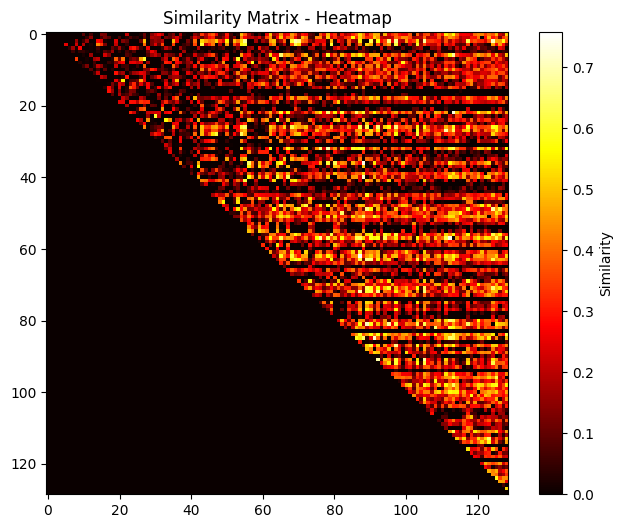

# Trustable: 78
iCls 1
numThisClass 63


  0%|          | 0/63 [00:00<?, ?it/s]

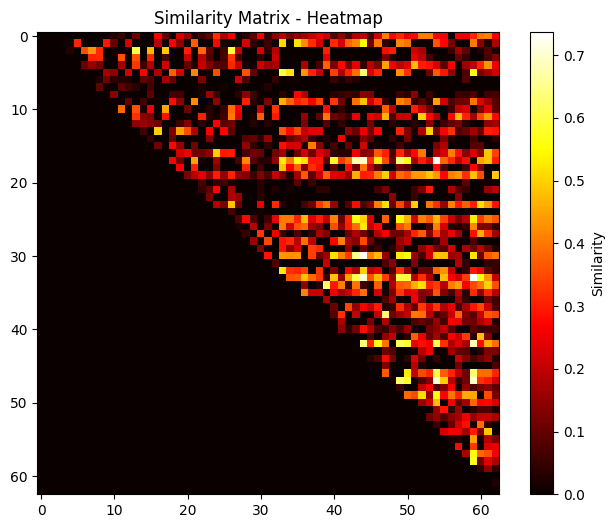

# Trustable: 26
iCls 2
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

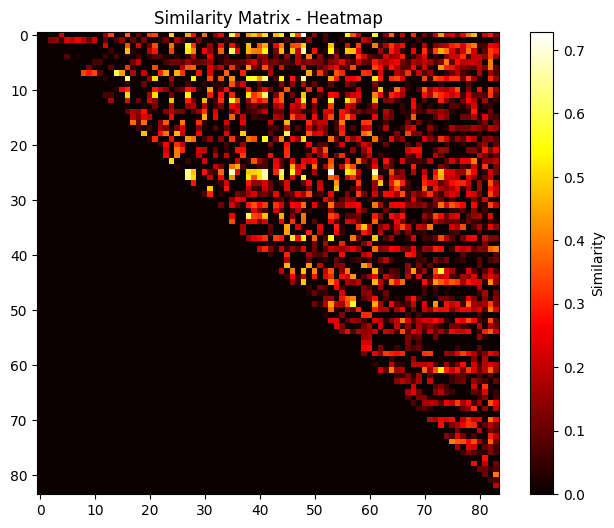

# Trustable: 34
iCls 3
numThisClass 101


  0%|          | 0/101 [00:00<?, ?it/s]

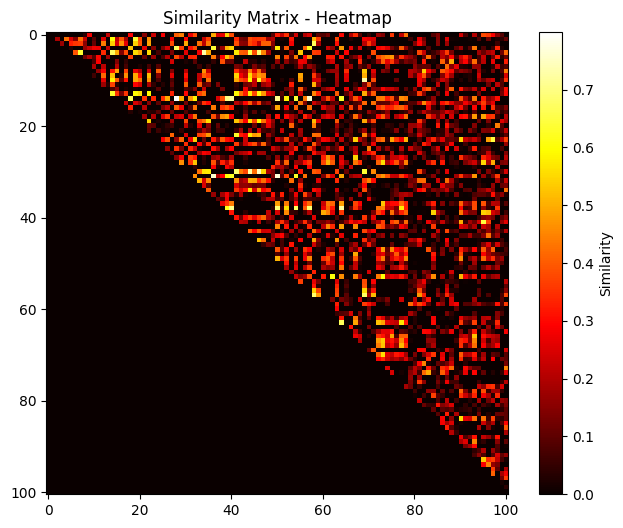

# Trustable: 27
iCls 4
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

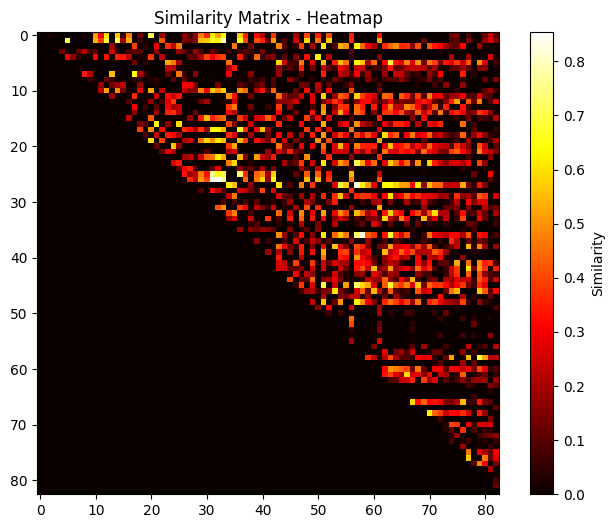

# Trustable: 30
iCls 5
numThisClass 43


  0%|          | 0/43 [00:00<?, ?it/s]

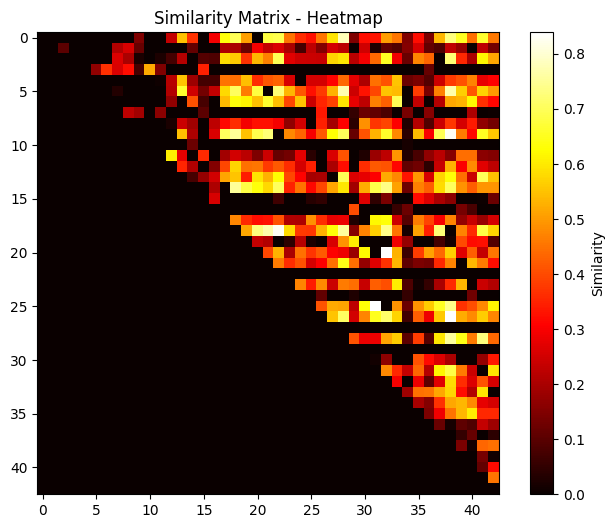

# Trustable: 32
iCls 6
numThisClass 133


  0%|          | 0/133 [00:00<?, ?it/s]

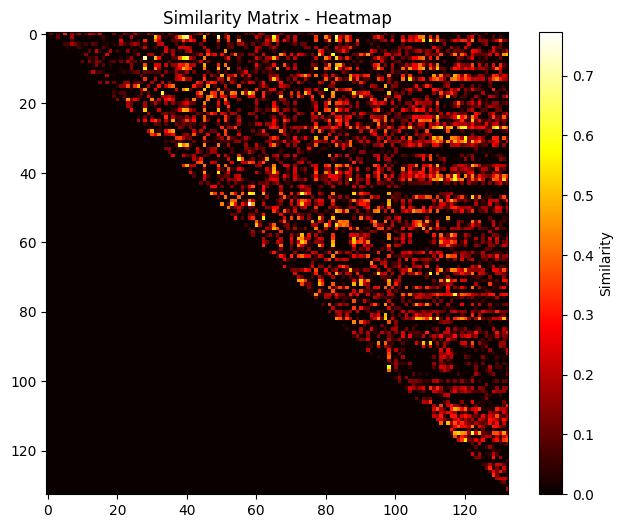

# Trustable: 27
iCls 7
numThisClass 63


  0%|          | 0/63 [00:00<?, ?it/s]

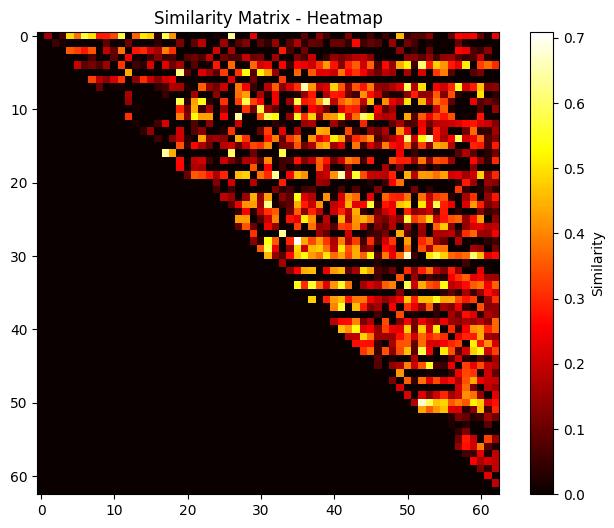

# Trustable: 37
iCls 8
numThisClass 43


  0%|          | 0/43 [00:00<?, ?it/s]

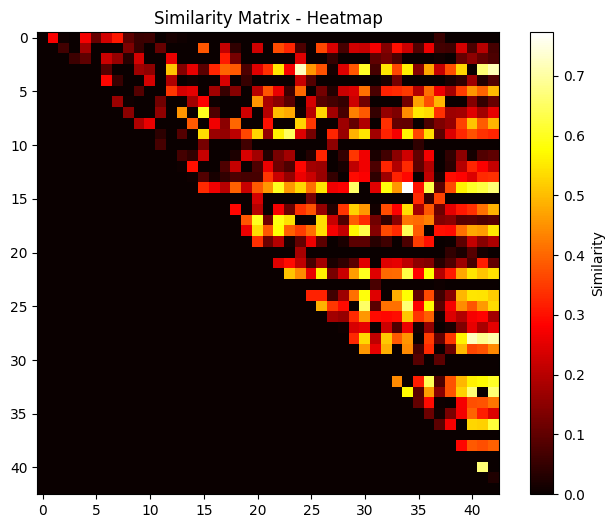

# Trustable: 23
iCls 9
numThisClass 49


  0%|          | 0/49 [00:00<?, ?it/s]

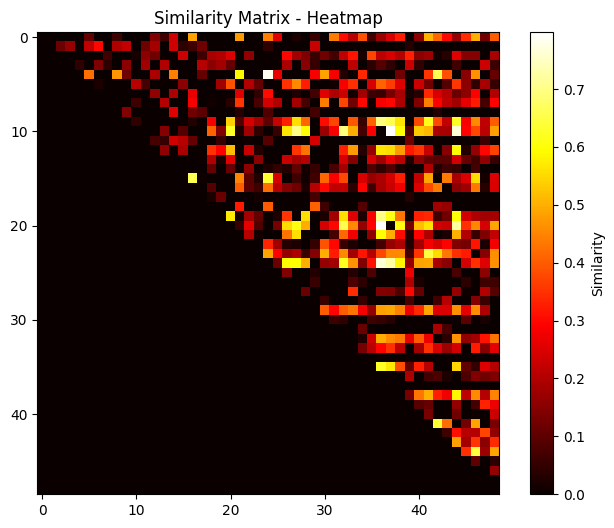

# Trustable: 22
iCls 10
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

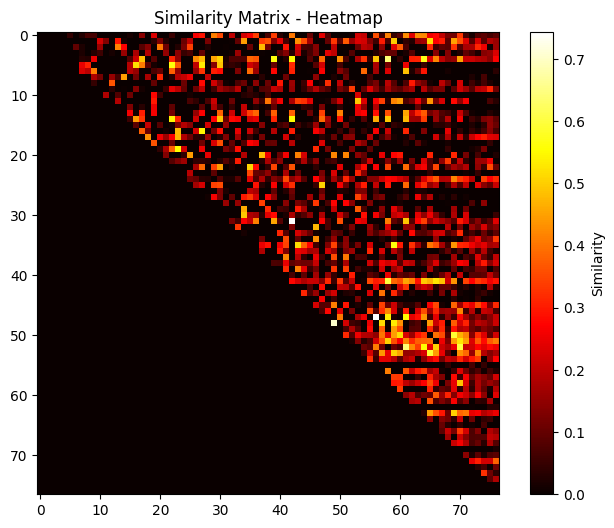

# Trustable: 21
iCls 11
numThisClass 150


  0%|          | 0/150 [00:00<?, ?it/s]

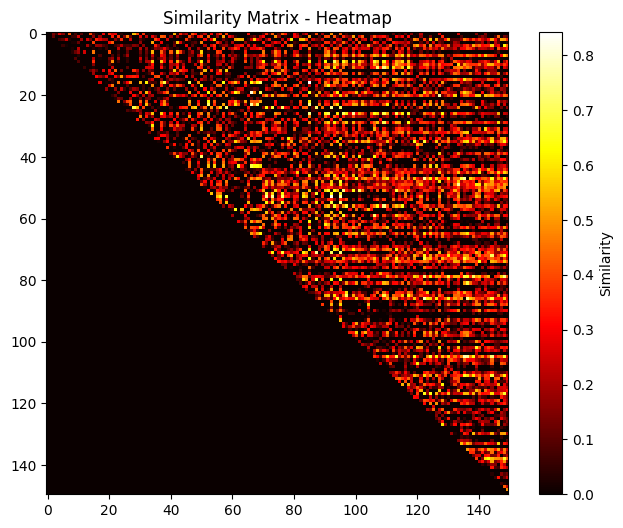

# Trustable: 52
iCls 12
numThisClass 54


  0%|          | 0/54 [00:00<?, ?it/s]

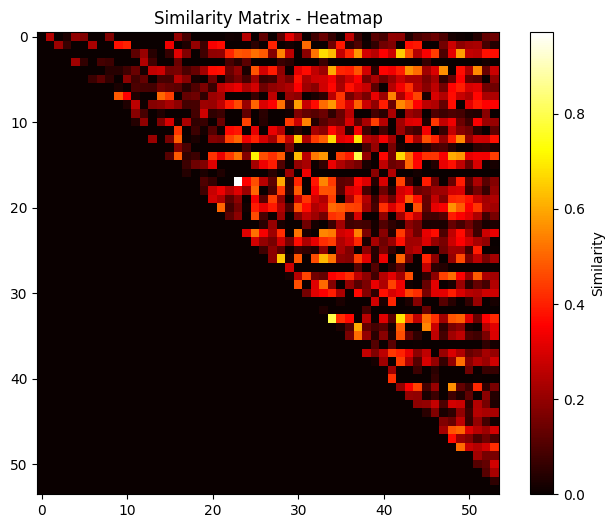

# Trustable: 11
iCls 13
numThisClass 58


  0%|          | 0/58 [00:00<?, ?it/s]

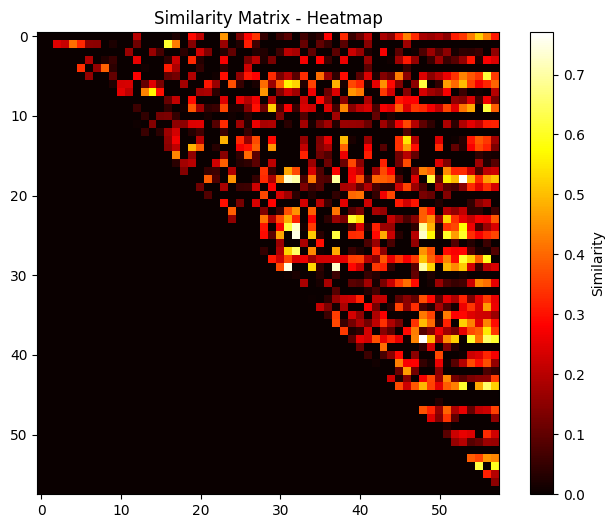

# Trustable: 24
iCls 14
numThisClass 65


  0%|          | 0/65 [00:00<?, ?it/s]

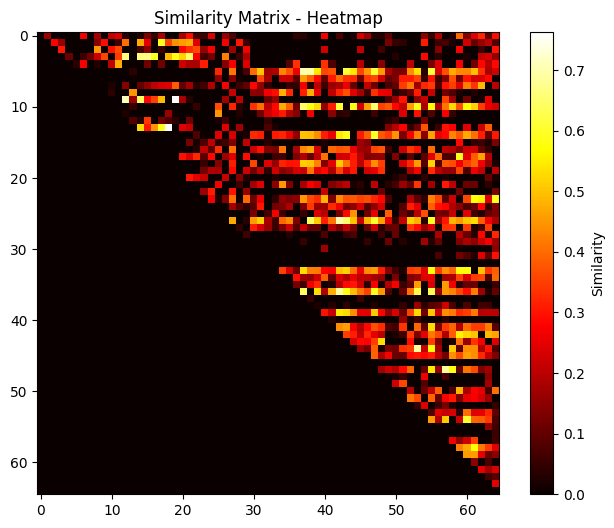

# Trustable: 32
iCls 15
numThisClass 66


  0%|          | 0/66 [00:00<?, ?it/s]

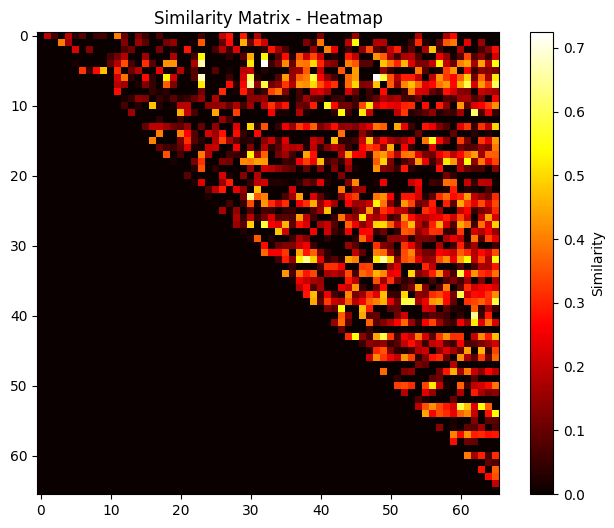

# Trustable: 28
iCls 16
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

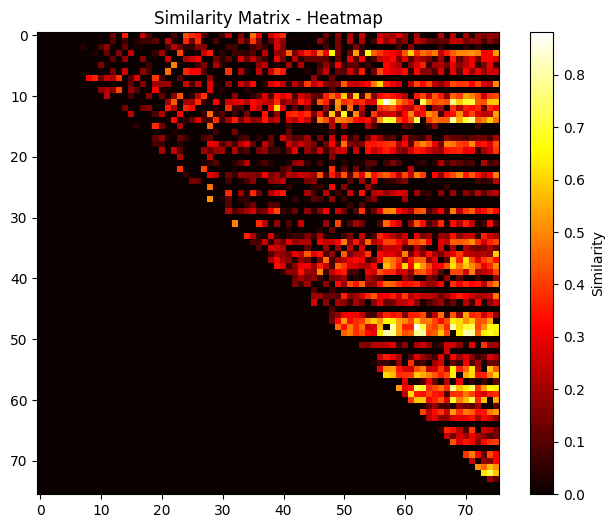

# Trustable: 24
iCls 17
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

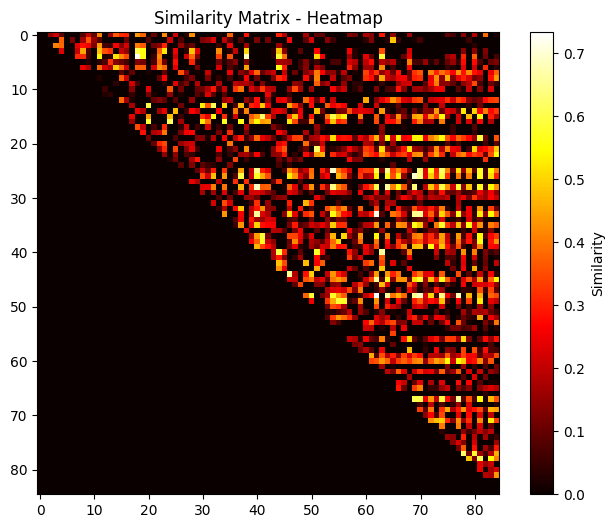

# Trustable: 41
iCls 18
numThisClass 118


  0%|          | 0/118 [00:00<?, ?it/s]

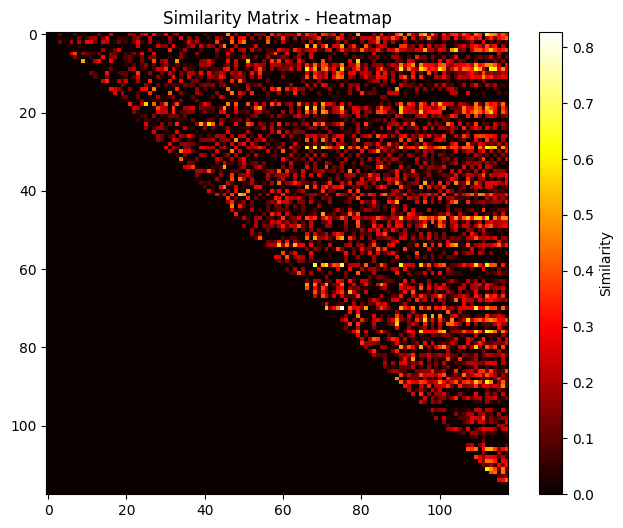

# Trustable: 27
iCls 19
numThisClass 60


  0%|          | 0/60 [00:00<?, ?it/s]

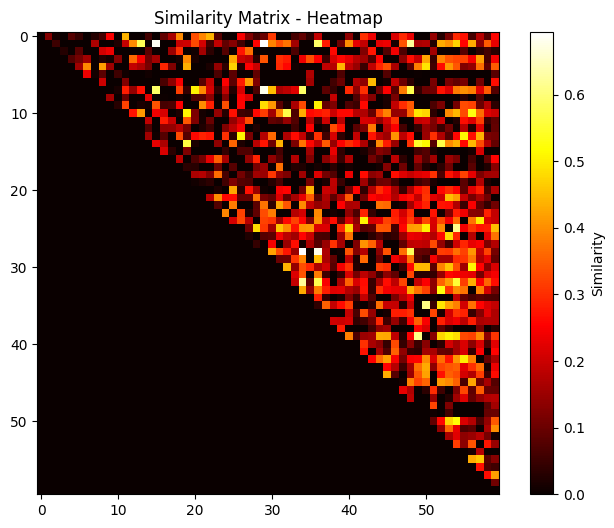

# Trustable: 23


In [ ]:
classifier = Classifier(20)
classifier.load(PATH = "/content/UDA/models_save/source_prod.pt")
pt = Trainer(train_data = train_set, base_model = classifier, pseudo_tree="tree")

In [ ]:
pt.train_data.save_pseudo("/content/gdrive/MyDrive/datasets/pseudolabels/product_images/tree_prod_source_only_model.npz")

In [ ]:
pt.train(epochs = 15, log_str = "prod2rl 3it T norm 15e")

wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.5985576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6033653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7451923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7884615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7596153846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.78125


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7668269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.78125


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7692307692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8028846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7860576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8052884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
Exception ignored

0.7716346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7860576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f80241cbac0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8076923076923077


auc,▁▁▆▇▆▇▇▇▇█▇█▇▇█
eval_loss,█▆▃▂▂▂▂▂▂▁▂▁▂▂▁
train_loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.80769
eval_loss,0.71263
train_loss,0.57487


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_prod2real_life_e15_T.pt")
#pt.model

##### **Initial considerations**

Instead of relying on the model's confidence, this strategy uses a similarity measure based on the features extracted from the penultimate layer of the pre-trained ResNet50 model. Specifically, the similarity matrix is constructed by computing the pairwise distances between the feature representations of the target_train samples. The threshold value acts as a cutoff point, determining the minimum similarity required for a sample to be considered trustworthy.

Changing the threshold value directly affects the selection of pseudolabels. A higher threshold necessitates more similar features among target samples, resulting in a smaller set of trustable pseudolabels. On the other hand, a lower threshold allows for a greater number of pseudolabels to be considered trustworthy, even if the feature similarity is relatively lower.


In the specific case of the domain adaptation problem from product images to real images a lower threshold value was necessary. Initially, the threshold of 0.8 resulted in a limited number of pseudolabels being considered trustworthy. Small pseudolabeled samples can lead to decreased diversity and representativeness within the training data. Consequently, this can result in biased learning, poor generalization, and provide limited coverage of the target distribution.

To address this issue, we experimented with lowering the threshold while carefully monitoring the subsequent classifier training performance. Our aim was to find the optimal balance between the quantity and quality of pseudolabeled data. Through these experiments, we considered a threshold of 0.6 to be appropriate.

The variation in the selection of trustworthy pseudolabels (threshold of 0.8 vs 0.6) between the two adaptation directions can be attributed to the inherent nature of the images within each domain. When adapting from real images to product images, a higher threshold value was required. This can partially be explained by the fact that all the images in the product domain have a consistent white background, which increases the similarity between images.

------

The choice of the hyperparameter threshold was determined through empirical experimentation:

Max accuracy with threshold 0.8 = 0.7308.
View run at [wandb](https://wandb.ai/uda-dl/UDA/runs/07nwqd4v)

Max accuracy with threshold 0.7 = 0.8077.
View run at [wandb](https://wandb.ai/uda-dl/UDA/runs/utt8882b)

Max accuracy with threshold 0.6 = 0.8077

Max accuracy with threshold 0.55 = 0.8101
View run at [wandb](https://wandb.ai/uda-dl/UDA/runs/5pb1zqe6)

Max accuracy with threshold 0.50 = 0.8101
View run at [wandb](https://wandb.ai/uda-dl/UDA/runs/oidsg753)


| Class       | Pseudolabeled samples     | Threshold 0.8     | Threshold 0.7   | Threshold 0.6   | Threshold 0.55   | Threshold 0.50   |
| ----------- | ----------- | ----------- | ---------- | ---------- | ---------- |---------- |
| backpack        | 129 | 21 | 55 | 78 | 85 | 94 |
| bookcase        |  63 | 11 | 20 | 26 | 33 | 38 |
| car jack        |  84 | 11 | 21 | 34 | 36 | 46 |
| comb            | 101 | 13 | 20 | 27 | 33 | 43 |
| crown           |  83 |  5 | 14 | 30 | 37 | 43 |
| file cabinet    |  43 | 17 | 24 | 32 | 32 | 33 |
| flat iron       | 133 |  6 | 10 | 27 | 36 | 49 |
| game controller |  63 |  7 | 18 | 37 | 41 | 45 |
| glasses         |  43 | 11 | 18 | 23 | 24 | 28 |
| helicopter      |  49 |  9 | 16 | 22 | 23 | 25 |
| ice skates      |  77 |  4 | 10 | 21 | 32 | 38 |
| letter tray     | 150 | 12 | 32 | 52 | 79 | 103 |
| monitor         |  54 |  3 |  5 | 11 | 17 | 27 |
| mug             |  58 | 11 | 16 | 24 | 27 | 32 |
| network switch  |  65 |  5 | 19 | 32 | 37 | 42 |
| over-ear headphones |  66 | 12 | 18 | 28 | 37 | 45 |
| pen             |  76 | 12 | 20 | 24 | 34 | 39 |
| purse           |  85 | 17 | 26 | 41 | 51 | 55 |
| stand mixer     | 118 | 2  | 15 | 27 | 36 | 44 |
| stroller        |  60 | 12 | 13 | 23| 31 | 36 |

##### REAL -> PRODUCT

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life")

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 66


  0%|          | 0/66 [00:10<?, ?it/s]

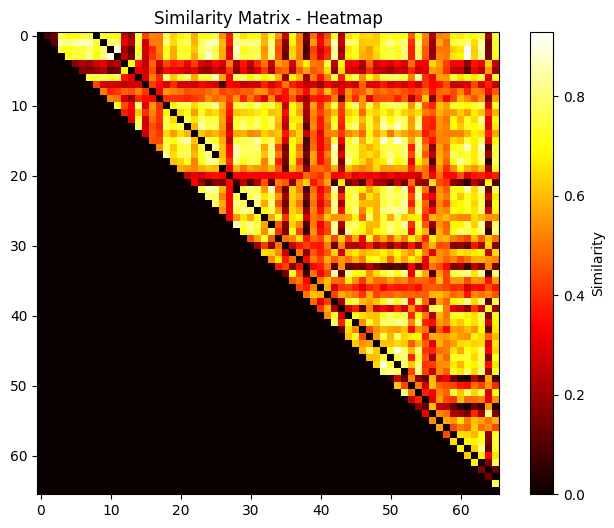

# Trustable: 52
iCls 1
numThisClass 97


  0%|          | 0/97 [00:00<?, ?it/s]

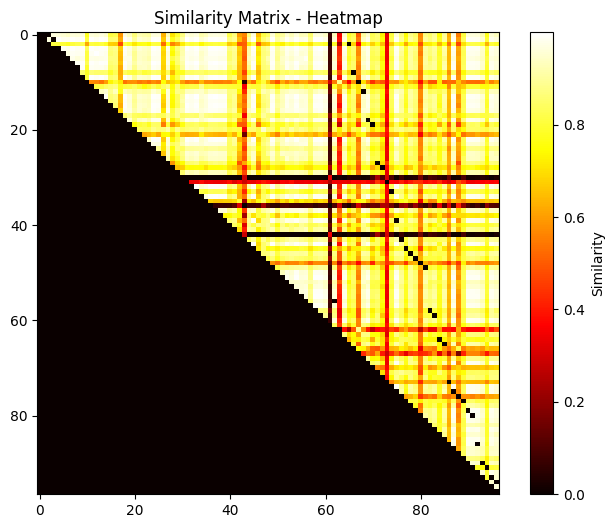

# Trustable: 95
iCls 2
numThisClass 68


  0%|          | 0/68 [00:00<?, ?it/s]

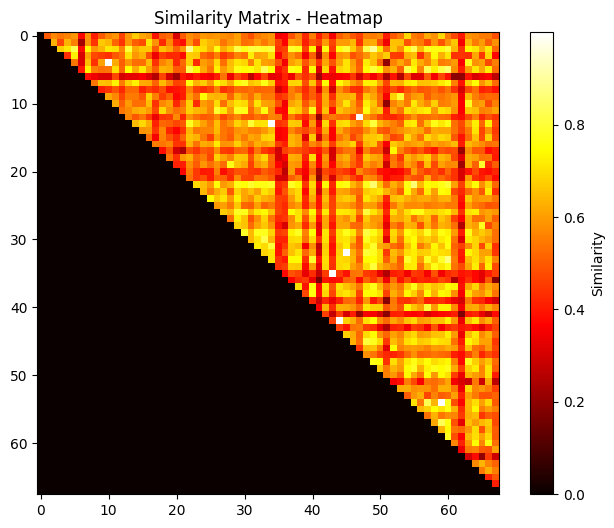

# Trustable: 17
iCls 3
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

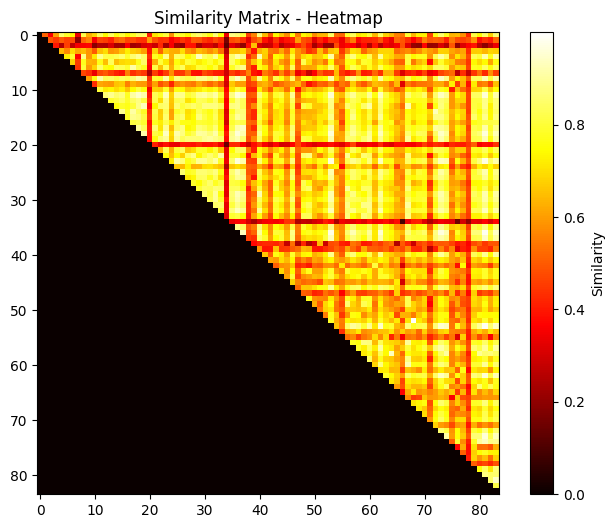

# Trustable: 53
iCls 4
numThisClass 75


  0%|          | 0/75 [00:00<?, ?it/s]

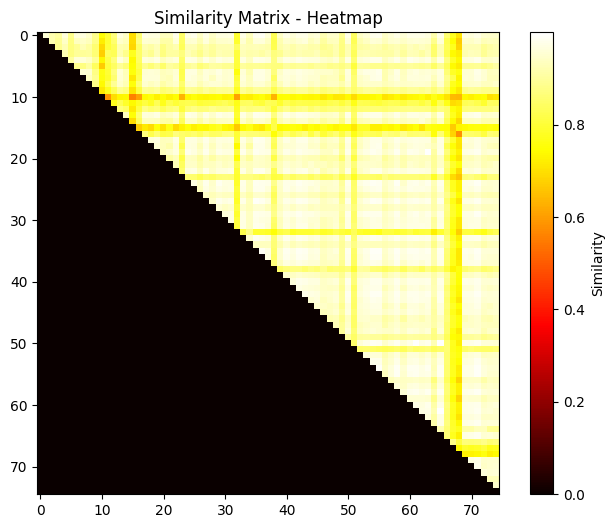

# Trustable: 73
iCls 5
numThisClass 60


  0%|          | 0/60 [00:00<?, ?it/s]

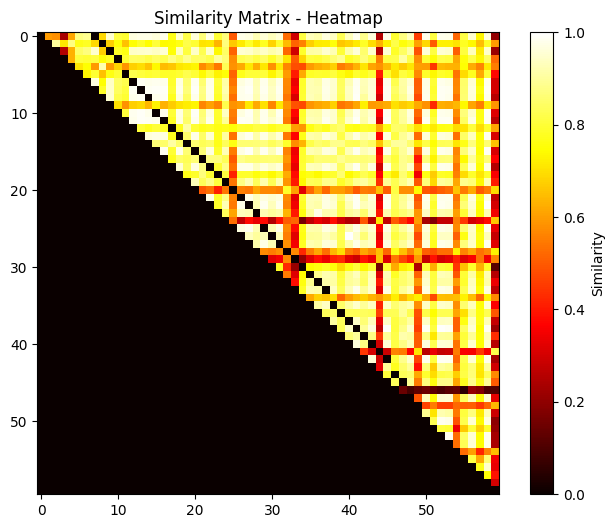

# Trustable: 53
iCls 6
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

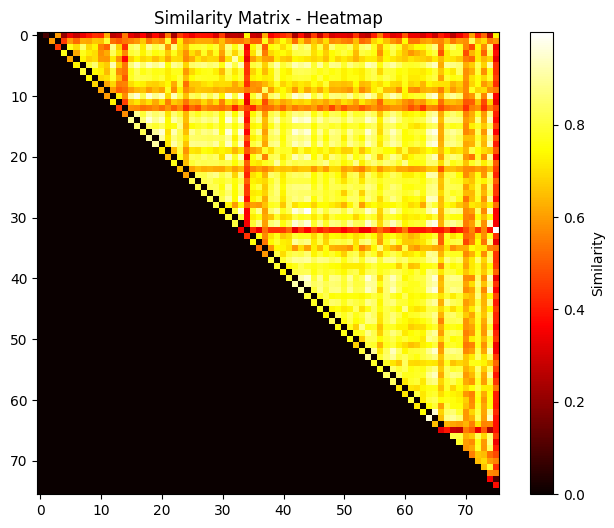

# Trustable: 64
iCls 7
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

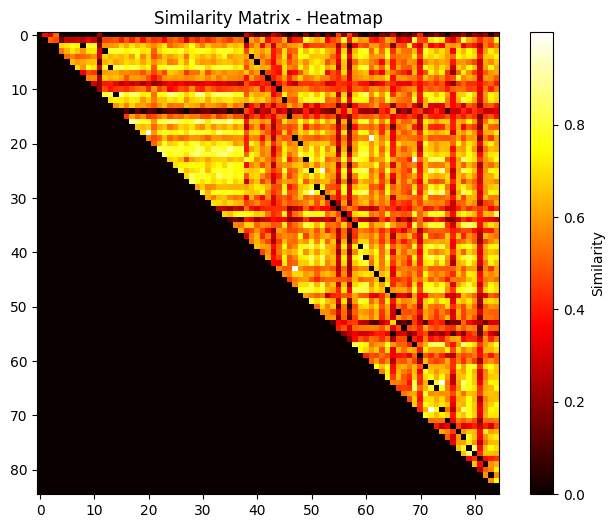

# Trustable: 42
iCls 8
numThisClass 90


  0%|          | 0/90 [00:00<?, ?it/s]

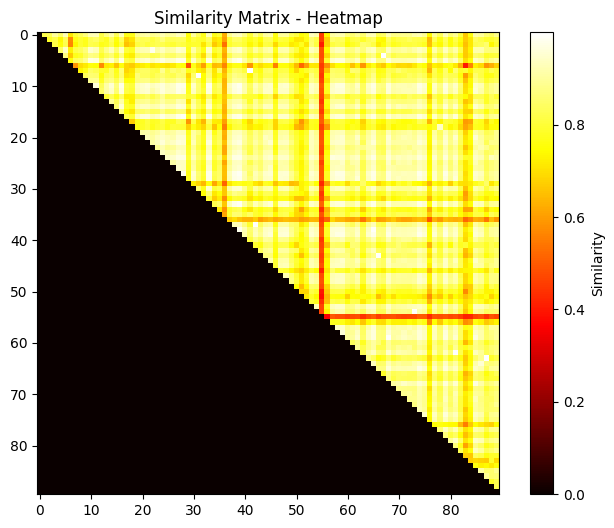

# Trustable: 83
iCls 9
numThisClass 87


  0%|          | 0/87 [00:00<?, ?it/s]

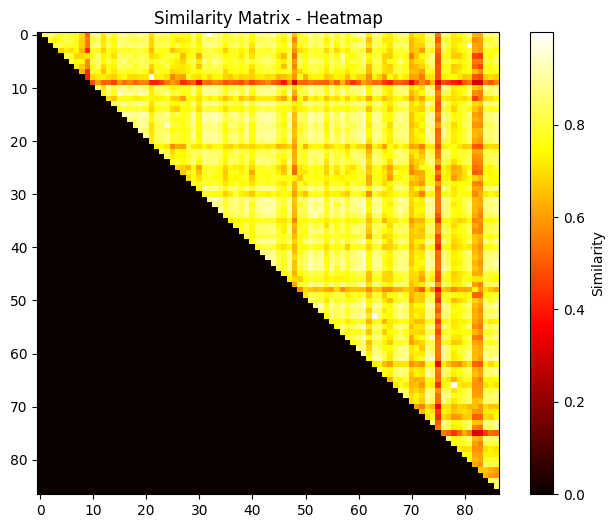

# Trustable: 69
iCls 10
numThisClass 74


  0%|          | 0/74 [00:00<?, ?it/s]

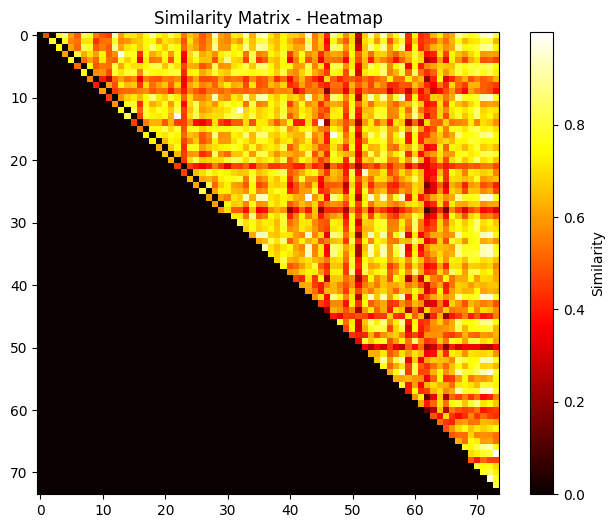

# Trustable: 35
iCls 11
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

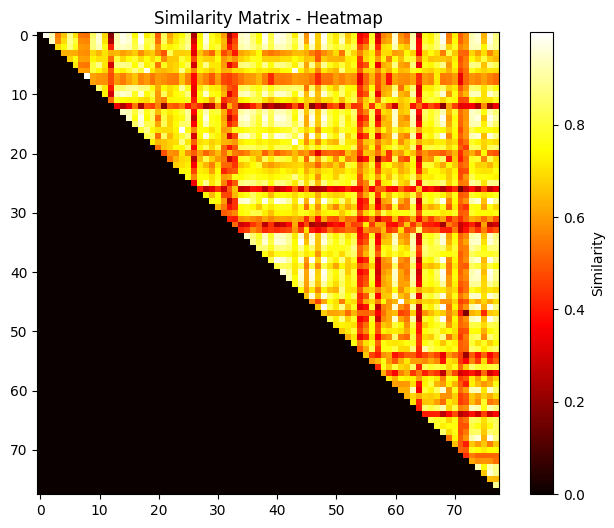

# Trustable: 47
iCls 12
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

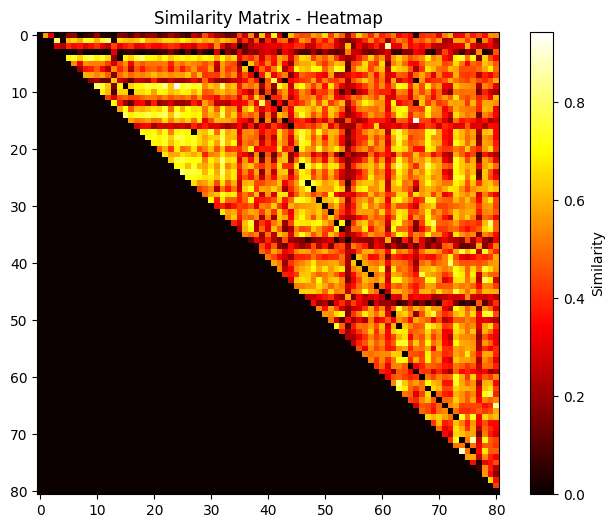

# Trustable: 10
iCls 13
numThisClass 88


  0%|          | 0/88 [00:00<?, ?it/s]

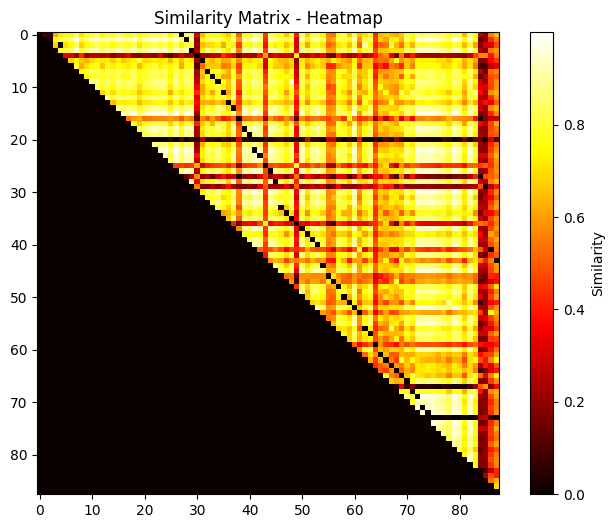

# Trustable: 75
iCls 14
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

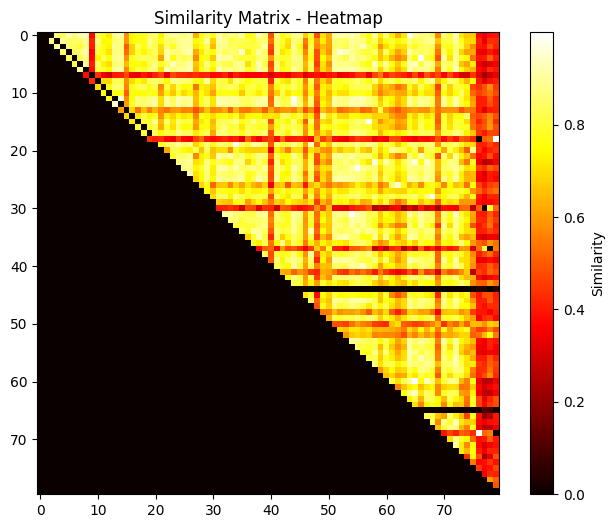

# Trustable: 66
iCls 15
numThisClass 89


  0%|          | 0/89 [00:00<?, ?it/s]

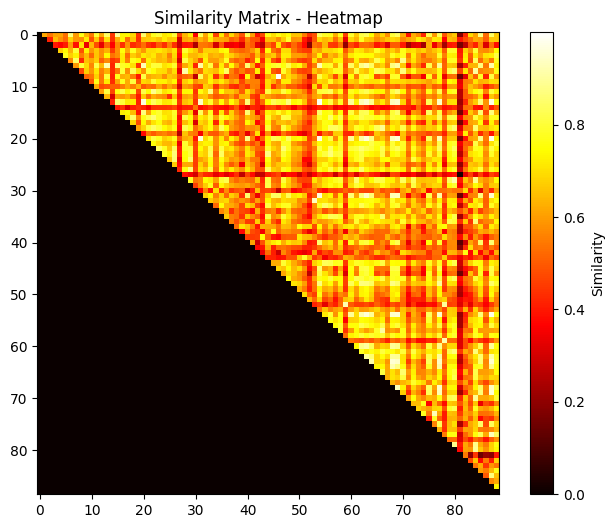

# Trustable: 36
iCls 16
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

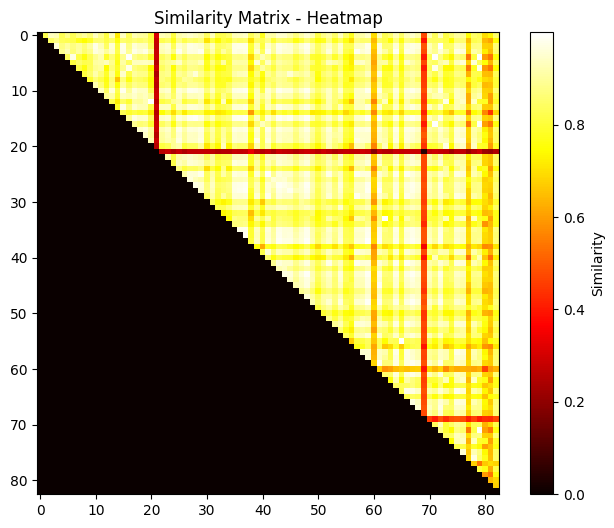

# Trustable: 77
iCls 17
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

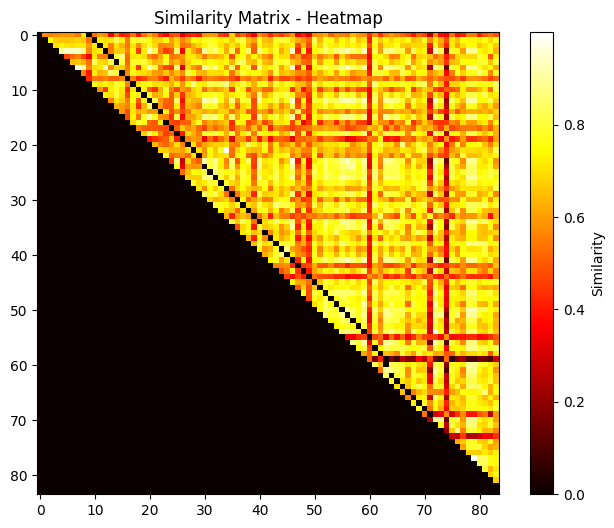

# Trustable: 56
iCls 18
numThisClass 70


  0%|          | 0/70 [00:00<?, ?it/s]

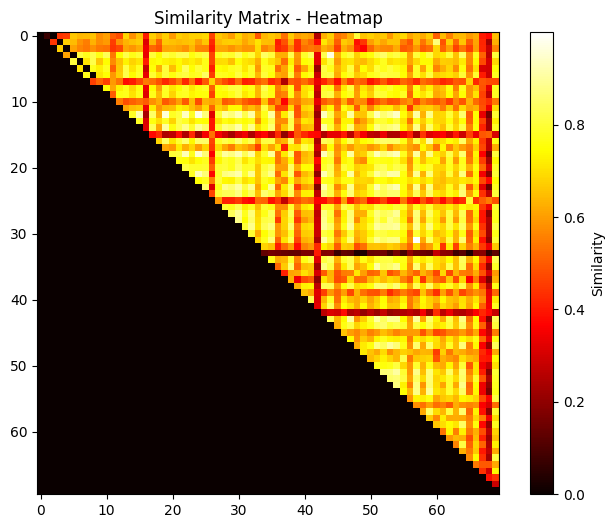

# Trustable: 43
iCls 19
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

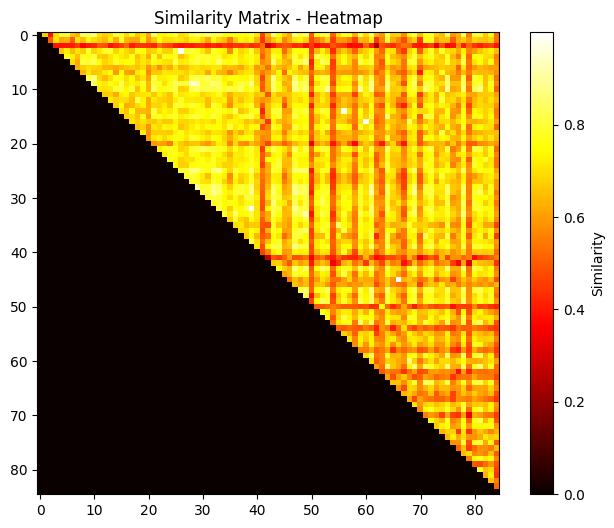

# Trustable: 40


In [ ]:
classifier = Classifier(20)
classifier.load(PATH = "/content/UDA/models_save/source_rl.pt")
pt = Trainer(train_data = train_set, base_model = classifier, pseudo_tree="tree")

In [ ]:
pt.train_data.save_pseudo("/content/gdrive/MyDrive/datasets/pseudolabels/product_images/tree_rl_source_only_model.npz")

In [ ]:
pt.train(epochs = 15, log_str = "rl2prod 3it T norm 15e")

wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7836538461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8846153846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8870192307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9086538461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9230769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    self._shutdown_workers()
if w.is_alive():
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        if w.is_alive():assert self._parent_pid == os.getpid(), 'can only test a child process'
  File "/usr/lib/python3.10/multiprocessing/process.py", line 16

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9014423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9399038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9399038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9206730769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9375


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9254807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9278846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fb129609b40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9278846153846154


auc,▁▆▆▇▇█▆███▇█▇▇▇
eval_loss,█▄▃▂▂▁▂▁▁▁▁▁▁▁▁
train_loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁
auc,0.92788
eval_loss,0.27138
train_loss,0.62048


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_real_life2prod_e15_T.pt")
#pt.model

#### Iterative training

In [ ]:
root = '/content/gdrive/MyDrive/datasets/adaptiope_small/'

##### PRODUCT -> REAL

Similarity matrix threshold = 0.6

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "product_images")

In [ ]:
classifier = Classifier(20)
classifier.load(PATH = "/content/UDA/models_save/source_prod.pt")
pt = Trainer(train_data = train_set, base_model = classifier, pseudo_tree="tree")

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 262MB/s]
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 129


  0%|          | 0/129 [00:00<?, ?it/s]

# Trustable: 78
iCls 1
numThisClass 63


  0%|          | 0/63 [00:00<?, ?it/s]

# Trustable: 26
iCls 2
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

# Trustable: 34
iCls 3
numThisClass 101


  0%|          | 0/101 [00:00<?, ?it/s]

# Trustable: 27
iCls 4
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 30
iCls 5
numThisClass 43


  0%|          | 0/43 [00:00<?, ?it/s]

# Trustable: 32
iCls 6
numThisClass 133


  0%|          | 0/133 [00:00<?, ?it/s]

# Trustable: 27
iCls 7
numThisClass 63


  0%|          | 0/63 [00:00<?, ?it/s]

# Trustable: 37
iCls 8
numThisClass 43


  0%|          | 0/43 [00:00<?, ?it/s]

# Trustable: 23
iCls 9
numThisClass 49


  0%|          | 0/49 [00:00<?, ?it/s]

# Trustable: 22
iCls 10
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

# Trustable: 21
iCls 11
numThisClass 150


  0%|          | 0/150 [00:00<?, ?it/s]

# Trustable: 52
iCls 12
numThisClass 54


  0%|          | 0/54 [00:00<?, ?it/s]

# Trustable: 11
iCls 13
numThisClass 58


  0%|          | 0/58 [00:00<?, ?it/s]

# Trustable: 24
iCls 14
numThisClass 65


  0%|          | 0/65 [00:00<?, ?it/s]

# Trustable: 32
iCls 15
numThisClass 66


  0%|          | 0/66 [00:00<?, ?it/s]

# Trustable: 28
iCls 16
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

# Trustable: 24
iCls 17
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 41
iCls 18
numThisClass 118


  0%|          | 0/118 [00:00<?, ?it/s]

# Trustable: 27
iCls 19
numThisClass 60


  0%|          | 0/60 [00:00<?, ?it/s]

# Trustable: 23
qui


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

406


In [ ]:
pt.train_data.save_pseudo("/content/gdrive/MyDrive/datasets/pseudolabels/real_life/tree_prod_source_T_iter.npz")

In [ ]:
pt.iterative_train(5, cls_epochs = 5, run_name = "product2rl 5e T_PSL")


Iteration:   0%|          | 0/5 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7451923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

if w.is_alive()::     assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionErrorcan only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7283653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        if w.is_alive():
self._shutdown_workers()  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        assert self._parent_pid == os.getpid(), 'can only test a child process'if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 1

0.7572115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Traceback (most recent call last):
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    self._shutdown_workers()
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():if w.is_alive():Exception ignored in: 
Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
<function _MultiProcessingDa

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7860576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        assert self._parent_pid == os.getpid(), 'can only test a child process'if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 1

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7716346153846154


auc,▃▁▅█▆
eval_loss,█▄▂▁▁
train_loss,█▂▁▁▁
auc,0.77163
eval_loss,0.8541
train_loss,0.70723


Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30><function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
    self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
if w.is_alive():    
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    AssertionError: assert self._parent_pid == os.getpid(), 'can only test a child process'can only test a child process

Exception ignored in: <function _MultiPro

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 127


  0%|          | 0/127 [00:00<?, ?it/s]

# Trustable: 66
iCls 1
numThisClass 64


  0%|          | 0/64 [00:00<?, ?it/s]

# Trustable: 31
iCls 2
numThisClass 100


  0%|          | 0/100 [00:00<?, ?it/s]

# Trustable: 34
iCls 3
numThisClass 91


  0%|          | 0/91 [00:00<?, ?it/s]

# Trustable: 37
iCls 4
numThisClass 73


  0%|          | 0/73 [00:00<?, ?it/s]

# Trustable: 32
iCls 5
numThisClass 61


  0%|          | 0/61 [00:00<?, ?it/s]

# Trustable: 40
iCls 6
numThisClass 97


  0%|          | 0/97 [00:00<?, ?it/s]

# Trustable: 40
iCls 7
numThisClass 64


  0%|          | 0/64 [00:00<?, ?it/s]

# Trustable: 35
iCls 8
numThisClass 75


  0%|          | 0/75 [00:00<?, ?it/s]

# Trustable: 34
iCls 9
numThisClass 68


  0%|          | 0/68 [00:00<?, ?it/s]

# Trustable: 26
iCls 10
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

# Trustable: 34
iCls 11
numThisClass 104


  0%|          | 0/104 [00:00<?, ?it/s]

# Trustable: 47
iCls 12
numThisClass 48


  0%|          | 0/48 [00:00<?, ?it/s]

# Trustable: 10
iCls 13
numThisClass 59


  0%|          | 0/59 [00:00<?, ?it/s]

# Trustable: 24
iCls 14
numThisClass 109


  0%|          | 0/109 [00:00<?, ?it/s]

# Trustable: 47
iCls 15
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

# Trustable: 38
iCls 16
numThisClass 73


  0%|          | 0/73 [00:00<?, ?it/s]

# Trustable: 28
iCls 17
numThisClass 51


  0%|          | 0/51 [00:00<?, ?it/s]

# Trustable: 26
iCls 18
numThisClass 121


  0%|          | 0/121 [00:00<?, ?it/s]

# Trustable: 45
iCls 19
numThisClass 67


  0%|          | 0/67 [00:00<?, ?it/s]

# Trustable: 27


wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.40865384615384615


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.6634615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>    self._shutdown_workers()

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        assert self._parent_pid == os.getpid(), 'can only test a child process'self._shutdown_workers()

AssertionError  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
:     can only test a child processif w.is_alive():

  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7788461538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7620192307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7788461538461539


auc,▁▆███
eval_loss,█▄▂▁▁
train_loss,█▄▂▁▁
auc,0.77885
eval_loss,0.94172
train_loss,0.98657


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Exception ignored in: Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        if w.is_alive():if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only te

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 116


  0%|          | 0/116 [00:00<?, ?it/s]

# Trustable: 63
iCls 1
numThisClass 88


  0%|          | 0/88 [00:00<?, ?it/s]

# Trustable: 41
iCls 2
numThisClass 62


  0%|          | 0/62 [00:00<?, ?it/s]

# Trustable: 33
iCls 3
numThisClass 116


  0%|          | 0/116 [00:00<?, ?it/s]

# Trustable: 38
iCls 4
numThisClass 102


  0%|          | 0/102 [00:00<?, ?it/s]

# Trustable: 36
iCls 5
numThisClass 42


  0%|          | 0/42 [00:00<?, ?it/s]

# Trustable: 29
iCls 6
numThisClass 107


  0%|          | 0/107 [00:00<?, ?it/s]

# Trustable: 41
iCls 7
numThisClass 61


  0%|          | 0/61 [00:00<?, ?it/s]

# Trustable: 36
iCls 8
numThisClass 53


  0%|          | 0/53 [00:00<?, ?it/s]

# Trustable: 30
iCls 9
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 34
iCls 10
numThisClass 101


  0%|          | 0/101 [00:00<?, ?it/s]

# Trustable: 28
iCls 11
numThisClass 86


  0%|          | 0/86 [00:00<?, ?it/s]

# Trustable: 47
iCls 12
numThisClass 67


  0%|          | 0/67 [00:00<?, ?it/s]

# Trustable: 13
iCls 13
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

# Trustable: 28
iCls 14
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 40
iCls 15
numThisClass 61


  0%|          | 0/61 [00:00<?, ?it/s]

# Trustable: 35
iCls 16
numThisClass 65


  0%|          | 0/65 [00:00<?, ?it/s]

# Trustable: 23
iCls 17
numThisClass 45


  0%|          | 0/45 [00:00<?, ?it/s]

# Trustable: 24
iCls 18
numThisClass 120


  0%|          | 0/120 [00:00<?, ?it/s]

# Trustable: 50
iCls 19
numThisClass 57


  0%|          | 0/57 [00:00<?, ?it/s]

# Trustable: 25


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.4831730769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7524038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>    
self._shutdown_workers()Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        if w.is_alive():self._shutdown_workers()

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    assert self._parent_pid == os.getpid(), 'can only test a child process'if w.is_alive():

AssertionError  File "/usr/lib/python3.10/multiprocessing/proce

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    self._shutdown_workers()
if w.is_alive():
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        if w.is_alive():
Exception ignored in: assert self._parent_pid == os.getpid(), 'can only test a child process'
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377c

0.7884615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7980769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7956730769230769


auc,▁▇███
eval_loss,█▃▂▁▁
train_loss,█▄▂▁▁
auc,0.79567
eval_loss,0.76081
train_loss,0.7073


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in:     <function _M

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 163


  0%|          | 0/163 [00:00<?, ?it/s]

# Trustable: 78
iCls 1
numThisClass 61


  0%|          | 0/61 [00:00<?, ?it/s]

# Trustable: 29
iCls 2
numThisClass 94


  0%|          | 0/94 [00:00<?, ?it/s]

# Trustable: 40
iCls 3
numThisClass 108


  0%|          | 0/108 [00:00<?, ?it/s]

# Trustable: 32
iCls 4
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 38
iCls 5
numThisClass 59


  0%|          | 0/59 [00:00<?, ?it/s]

# Trustable: 37
iCls 6
numThisClass 65


  0%|          | 0/65 [00:00<?, ?it/s]

# Trustable: 11
iCls 7
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 36
iCls 8
numThisClass 64


  0%|          | 0/64 [00:00<?, ?it/s]

# Trustable: 33
iCls 9
numThisClass 53


  0%|          | 0/53 [00:00<?, ?it/s]

# Trustable: 23
iCls 10
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

# Trustable: 28
iCls 11
numThisClass 114


  0%|          | 0/114 [00:00<?, ?it/s]

# Trustable: 51
iCls 12
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

# Trustable: 14
iCls 13
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

# Trustable: 31
iCls 14
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

# Trustable: 37
iCls 15
numThisClass 64


  0%|          | 0/64 [00:00<?, ?it/s]

# Trustable: 37
iCls 16
numThisClass 75


  0%|          | 0/75 [00:00<?, ?it/s]

# Trustable: 25
iCls 17
numThisClass 45


  0%|          | 0/45 [00:00<?, ?it/s]

# Trustable: 26
iCls 18
numThisClass 116


  0%|          | 0/116 [00:00<?, ?it/s]

# Trustable: 47
iCls 19
numThisClass 68


  0%|          | 0/68 [00:00<?, ?it/s]

# Trustable: 28


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.40865384615384615


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in:     if w.is_alive():<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    Traceback (most recent call last):
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    AssertionErrorself._shutdown_workers(): 
can only test a child process  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    if w.is_alive():Exception ignored 

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
if w.is_alive():Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    self._shutdown_workers()assert self._parent_pid == os.getpid(), 'can only test a child process'
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
    AssertionError
if w.is_alive():Traceback (most recent call last):
: can only tes

0.65625


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7427884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7668269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7692307692307693


auc,▁▆▇██
eval_loss,█▄▃▁▁
train_loss,█▄▂▂▁
auc,0.76923
eval_loss,0.89497
train_loss,0.88844


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'    self._shutdown_workers()

AssertionError  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
: can only test a child process    
if w.is_alive():
  File "/usr/lib/

Pseudolabeling target samples:   0%|          | 0/50 [00:01<?, ?it/s]

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 116


  0%|          | 0/116 [00:00<?, ?it/s]

# Trustable: 67
iCls 1
numThisClass 57


  0%|          | 0/57 [00:00<?, ?it/s]

# Trustable: 28
iCls 2
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

# Trustable: 36
iCls 3
numThisClass 136


  0%|          | 0/136 [00:00<?, ?it/s]

# Trustable: 31
iCls 4
numThisClass 74


  0%|          | 0/74 [00:00<?, ?it/s]

# Trustable: 30
iCls 5
numThisClass 70


  0%|          | 0/70 [00:00<?, ?it/s]

# Trustable: 41
iCls 6
numThisClass 44


  0%|          | 0/44 [00:00<?, ?it/s]

# Trustable: 10
iCls 7
numThisClass 69


  0%|          | 0/69 [00:00<?, ?it/s]

# Trustable: 36
iCls 8
numThisClass 64


  0%|          | 0/64 [00:00<?, ?it/s]

# Trustable: 35
iCls 9
numThisClass 53


  0%|          | 0/53 [00:00<?, ?it/s]

# Trustable: 25
iCls 10
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

# Trustable: 32
iCls 11
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 34
iCls 12
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

# Trustable: 15
iCls 13
numThisClass 65


  0%|          | 0/65 [00:00<?, ?it/s]

# Trustable: 31
iCls 14
numThisClass 93


  0%|          | 0/93 [00:00<?, ?it/s]

# Trustable: 45
iCls 15
numThisClass 70


  0%|          | 0/70 [00:00<?, ?it/s]

# Trustable: 41
iCls 16
numThisClass 67


  0%|          | 0/67 [00:00<?, ?it/s]

# Trustable: 22
iCls 17
numThisClass 86


  0%|          | 0/86 [00:00<?, ?it/s]

# Trustable: 44
iCls 18
numThisClass 157


  0%|          | 0/157 [00:00<?, ?it/s]

# Trustable: 56
iCls 19
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 27


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6971153846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7283653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7524038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7980769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8221153846153846


auc,▁▃▄▇█
eval_loss,█▄▃▁▁
train_loss,█▃▂▁▁
auc,0.82212
eval_loss,0.70325
train_loss,0.60659


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 101


  0%|          | 0/101 [00:00<?, ?it/s]

# Trustable: 63
iCls 1
numThisClass 67


  0%|          | 0/67 [00:00<?, ?it/s]

# Trustable: 30
iCls 2
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

# Trustable: 37
iCls 3
numThisClass 97


  0%|          | 0/97 [00:00<?, ?it/s]

# Trustable: 40
iCls 4
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 35
iCls 5
numThisClass 66


  0%|          | 0/66 [00:00<?, ?it/s]

# Trustable: 36
iCls 6
numThisClass 91


  0%|          | 0/91 [00:00<?, ?it/s]

# Trustable: 13
iCls 7
numThisClass 75


  0%|          | 0/75 [00:00<?, ?it/s]

# Trustable: 40
iCls 8
numThisClass 62


  0%|          | 0/62 [00:00<?, ?it/s]

# Trustable: 36
iCls 9
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

# Trustable: 29
iCls 10
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 31
iCls 11
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 44
iCls 12
numThisClass 69


  0%|          | 0/69 [00:00<?, ?it/s]

# Trustable: 14
iCls 13
numThisClass 73


  0%|          | 0/73 [00:00<?, ?it/s]

# Trustable: 29
iCls 14
numThisClass 92


  0%|          | 0/92 [00:00<?, ?it/s]

# Trustable: 43
iCls 15
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

# Trustable: 46
iCls 16
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 28
iCls 17
numThisClass 91


  0%|          | 0/91 [00:00<?, ?it/s]

# Trustable: 44
iCls 18
numThisClass 124


  0%|          | 0/124 [00:00<?, ?it/s]

# Trustable: 52
iCls 19
numThisClass 59


  0%|          | 0/59 [00:00<?, ?it/s]

# Trustable: 25


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_prod2real_life_e5_iterative.pt")

##### REAL -> PRODUCT

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life")

In [ ]:
classifier = Classifier(20)
classifier.load(PATH = "/content/UDA/models_save/source_rl.pt")
pt = Trainer(train_data = train_set, base_model = classifier, pseudo_tree="tree")

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 112MB/s]
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 66


  0%|          | 0/66 [00:00<?, ?it/s]

# Trustable: 52
iCls 1
numThisClass 97


  0%|          | 0/97 [00:00<?, ?it/s]

# Trustable: 95
iCls 2
numThisClass 68


  0%|          | 0/68 [00:00<?, ?it/s]

# Trustable: 17
iCls 3
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

# Trustable: 53
iCls 4
numThisClass 75


  0%|          | 0/75 [00:00<?, ?it/s]

# Trustable: 73
iCls 5
numThisClass 60


  0%|          | 0/60 [00:00<?, ?it/s]

# Trustable: 53
iCls 6
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

# Trustable: 64
iCls 7
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 42
iCls 8
numThisClass 90


  0%|          | 0/90 [00:00<?, ?it/s]

# Trustable: 83
iCls 9
numThisClass 87


  0%|          | 0/87 [00:00<?, ?it/s]

# Trustable: 69
iCls 10
numThisClass 74


  0%|          | 0/74 [00:00<?, ?it/s]

# Trustable: 35
iCls 11
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 47
iCls 12
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 10
iCls 13
numThisClass 88


  0%|          | 0/88 [00:00<?, ?it/s]

# Trustable: 75
iCls 14
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 66
iCls 15
numThisClass 89


  0%|          | 0/89 [00:00<?, ?it/s]

# Trustable: 36
iCls 16
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 77
iCls 17
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

# Trustable: 56
iCls 18
numThisClass 70


  0%|          | 0/70 [00:00<?, ?it/s]

# Trustable: 43
iCls 19
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 40
qui


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

946


In [ ]:
pt.train_data.save_pseudo("/content/gdrive/MyDrive/datasets/pseudolabels/real_life/tree_real_source_T_iter.npz")

In [ ]:
pt.iterative_train(5, cls_epochs = 5, run_name = "rl2product 5e T_PSL")


Iteration:   0%|          | 0/5 [00:00<?, ?it/s]

here
Before wandb logger initialization


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


After wandb logger initialization


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7211538461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.875


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Exception ignored in: Traceback (most recent call last):
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    Traceback (most recent call last):
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    self._shutdown_workers()    if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        assert self._parent_pid == os.getpid(), 'can only test a child process'
if w.is_alive():AssertionError
: can only test a child process
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>Traceback (most recent call last):

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _Multi

0.9014423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9423076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


auc,▁▆▇██
eval_loss,█▃▂▁▁
train_loss,█▂▂▁▁
auc,0.93269
eval_loss,0.4227
train_loss,0.94217


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    self._shutdown_workers()
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

AssertionErrorException ignored in:     Exception ignored in: <function _MultiProces

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 91


  0%|          | 0/91 [00:00<?, ?it/s]

# Trustable: 69
iCls 1
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 82
iCls 2
numThisClass 93


  0%|          | 0/93 [00:00<?, ?it/s]

# Trustable: 28
iCls 3
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 49
iCls 4
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

# Trustable: 76
iCls 5
numThisClass 68


  0%|          | 0/68 [00:00<?, ?it/s]

# Trustable: 62
iCls 6
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 70
iCls 7
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 31
iCls 8
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 73
iCls 9
numThisClass 70


  0%|          | 0/70 [00:00<?, ?it/s]

# Trustable: 61
iCls 10
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

# Trustable: 41
iCls 11
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 53
iCls 12
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 9
iCls 13
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 72
iCls 14
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 67
iCls 15
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 39
iCls 16
numThisClass 87


  0%|          | 0/87 [00:00<?, ?it/s]

# Trustable: 78
iCls 17
numThisClass 67


  0%|          | 0/67 [00:00<?, ?it/s]

# Trustable: 49
iCls 18
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 43
iCls 19
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 40


wandb: Currently logged in as: pietro-demurtas (uda-dl). Use `wandb login --relogin` to force relogin


here
Before wandb logger initialization


After wandb logger initialization


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.65625


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0><function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
if w.is_alive():    
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/lib/python3.10/multiprocessing/process.py", line 16

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]


Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()
    self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():if w.is_alive():

Exception ignored in:   File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>    assert self._parent_pid == os.getpid(), 'can only test a child process'

assert self._parent_pid == os.getpid(), 'can only test a child proces

0.7836538461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8798076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9230769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9399038461538461


auc,▁▄▇██
eval_loss,█▄▂▁▁
train_loss,█▃▂▁▁
auc,0.9399
eval_loss,0.39322
train_loss,0.94214


Exception ignored in: 

Pseudolabeling target samples:   0%|          | 0/50 [00:10<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiproces

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 91


  0%|          | 0/91 [00:00<?, ?it/s]

# Trustable: 73
iCls 1
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 80
iCls 2
numThisClass 89


  0%|          | 0/89 [00:00<?, ?it/s]

# Trustable: 28
iCls 3
numThisClass 73


  0%|          | 0/73 [00:00<?, ?it/s]

# Trustable: 47
iCls 4
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 79
iCls 5
numThisClass 70


  0%|          | 0/70 [00:00<?, ?it/s]

# Trustable: 65
iCls 6
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 69
iCls 7
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

# Trustable: 30
iCls 8
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 72
iCls 9
numThisClass 63


  0%|          | 0/63 [00:00<?, ?it/s]

# Trustable: 51
iCls 10
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 46
iCls 11
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 52
iCls 12
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 9
iCls 13
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 70
iCls 14
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 67
iCls 15
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

# Trustable: 39
iCls 16
numThisClass 92


  0%|          | 0/92 [00:00<?, ?it/s]

# Trustable: 83
iCls 17
numThisClass 73


  0%|          | 0/73 [00:00<?, ?it/s]

# Trustable: 52
iCls 18
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 39
iCls 19
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

# Trustable: 38
here
Before wandb logger initialization


After wandb logger initialization


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7860576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]


Traceback (most recent call last):
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

        self._shutdown_workers()self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        if w.is_alive():if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only test a child process'assert self._parent_pid == os.getpid(), 'can only test a child process

0.9206730769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


auc,▁▇███
eval_loss,█▃▂▁▁
train_loss,█▃▂▁▁
auc,0.93269
eval_loss,0.32616
train_loss,0.80587


Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0><function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()

Pseudolabeling target samples:   0%|          | 0/50 [00:20<?, ?it/s]


  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        if w.is_alive():self._shutdown_workers()

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
assert self._parent_pid == os.getpid(), 'can only test a child process'    
if w.is_alive():AssertionError
:   File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
can only test a child process    
assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
can only test a child process
Exception ignored in: Traceback (most recent call last):
<function _Mult

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 68


  0%|          | 0/68 [00:00<?, ?it/s]

# Trustable: 52
iCls 1
numThisClass 97


  0%|          | 0/97 [00:00<?, ?it/s]

# Trustable: 94
iCls 2
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 30
iCls 3
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 50
iCls 4
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 80
iCls 5
numThisClass 61


  0%|          | 0/61 [00:00<?, ?it/s]

# Trustable: 56
iCls 6
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 57
iCls 7
numThisClass 70


  0%|          | 0/70 [00:00<?, ?it/s]

# Trustable: 27
iCls 8
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 71
iCls 9
numThisClass 67


  0%|          | 0/67 [00:00<?, ?it/s]

# Trustable: 56
iCls 10
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 44
iCls 11
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 49
iCls 12
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 8
iCls 13
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 77
iCls 14
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 67
iCls 15
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 39
iCls 16
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 75
iCls 17
numThisClass 89


  0%|          | 0/89 [00:00<?, ?it/s]

# Trustable: 60
iCls 18
numThisClass 103


  0%|          | 0/103 [00:00<?, ?it/s]

# Trustable: 60
iCls 19
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 40
here
Before wandb logger initialization


After wandb logger initialization


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6923076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9110576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9254807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9423076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9375


auc,▁▇███
eval_loss,█▃▂▂▁
train_loss,█▃▂▁▁
auc,0.9375
eval_loss,0.31914
train_loss,0.8257


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 73


  0%|          | 0/73 [00:00<?, ?it/s]

# Trustable: 57
iCls 1
numThisClass 96


  0%|          | 0/96 [00:00<?, ?it/s]

# Trustable: 93
iCls 2
numThisClass 87


  0%|          | 0/87 [00:00<?, ?it/s]

# Trustable: 30
iCls 3
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 51
iCls 4
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

# Trustable: 76
iCls 5
numThisClass 64


  0%|          | 0/64 [00:00<?, ?it/s]

# Trustable: 57
iCls 6
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 62
iCls 7
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

# Trustable: 27
iCls 8
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 71
iCls 9
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

# Trustable: 59
iCls 10
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 44
iCls 11
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

# Trustable: 48
iCls 12
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 15
iCls 13
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

# Trustable: 71
iCls 14
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 67
iCls 15
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 39
iCls 16
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

# Trustable: 72
iCls 17
numThisClass 86


  0%|          | 0/86 [00:00<?, ?it/s]

# Trustable: 56
iCls 18
numThisClass 88


  0%|          | 0/88 [00:00<?, ?it/s]

# Trustable: 46
iCls 19
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 40
here
Before wandb logger initialization


After wandb logger initialization


Epoch:   0%|          | 0/5 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8533653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9254807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>self._shutdown_workers()
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    if w.is_alive():    
self._shutdown_workers()  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    
assert self._parent_pid == os.getpid(), 'can only test a child process'
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
AssertionError    : can only test a child processif w.is_alive():

  File "/usr/lib/

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0><function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>

Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
    if w.is_alive():AssertionError: 
can only test a child process  File "/usr/lib/p

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9447115384615384


auc,▁▇▇▇█
eval_loss,█▃▂▂▁
train_loss,█▄▂▂▁
auc,0.94471
eval_loss,0.27836
train_loss,0.62687


Pseudolabeling target samples:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fc6bdabb7f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 60
iCls 1
numThisClass 94


  0%|          | 0/94 [00:00<?, ?it/s]

# Trustable: 91
iCls 2
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 29
iCls 3
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 52
iCls 4
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 80
iCls 5
numThisClass 63


  0%|          | 0/63 [00:00<?, ?it/s]

# Trustable: 58
iCls 6
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 63
iCls 7
numThisClass 69


  0%|          | 0/69 [00:00<?, ?it/s]

# Trustable: 27
iCls 8
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

# Trustable: 72
iCls 9
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

# Trustable: 58
iCls 10
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 41
iCls 11
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

# Trustable: 51
iCls 12
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 9
iCls 13
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

# Trustable: 69
iCls 14
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 67
iCls 15
numThisClass 84


  0%|          | 0/84 [00:00<?, ?it/s]

# Trustable: 40
iCls 16
numThisClass 77


  0%|          | 0/77 [00:00<?, ?it/s]

# Trustable: 71
iCls 17
numThisClass 75


  0%|          | 0/75 [00:00<?, ?it/s]

# Trustable: 50
iCls 18
numThisClass 96


  0%|          | 0/96 [00:00<?, ?it/s]

# Trustable: 48
iCls 19
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

# Trustable: 41


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_real_life2prod_e5_iterative.pt")

#### Training extensively

###### PRODUCT -> REAL

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "product_images",
                                pseudo_tree="tree", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/real_life/treePSL_iter4.npz")

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 44


  0%|          | 0/44 [00:00<?, ?it/s]

# Trustable: 9
iCls 1
numThisClass 20


  0%|          | 0/20 [00:00<?, ?it/s]

# Trustable: 3
iCls 2
numThisClass 24


  0%|          | 0/24 [00:00<?, ?it/s]

# Trustable: 10
iCls 3
numThisClass 24


  0%|          | 0/24 [00:00<?, ?it/s]

# Trustable: 9
iCls 4
numThisClass 23


  0%|          | 0/23 [00:00<?, ?it/s]

# Trustable: 9
iCls 5
numThisClass 26


  0%|          | 0/26 [00:00<?, ?it/s]

# Trustable: 5
iCls 6
numThisClass 10


  0%|          | 0/10 [00:00<?, ?it/s]

# Trustable: 5
iCls 7
numThisClass 27


  0%|          | 0/27 [00:00<?, ?it/s]

# Trustable: 8
iCls 8
numThisClass 23


  0%|          | 0/23 [00:00<?, ?it/s]

# Trustable: 12
iCls 9
numThisClass 17


  0%|          | 0/17 [00:00<?, ?it/s]

# Trustable: 4
iCls 10
numThisClass 20


  0%|          | 0/20 [00:00<?, ?it/s]

# Trustable: 9
iCls 11
numThisClass 28


  0%|          | 0/28 [00:00<?, ?it/s]

# Trustable: 18
iCls 12
numThisClass 11


  0%|          | 0/11 [00:00<?, ?it/s]

# Trustable: 4
iCls 13
numThisClass 17


  0%|          | 0/17 [00:00<?, ?it/s]

# Trustable: 9
iCls 14
numThisClass 28


  0%|          | 0/28 [00:00<?, ?it/s]

# Trustable: 9
iCls 15
numThisClass 29


  0%|          | 0/29 [00:00<?, ?it/s]

# Trustable: 8
iCls 16
numThisClass 19


  0%|          | 0/19 [00:00<?, ?it/s]

# Trustable: 5
iCls 17
numThisClass 29


  0%|          | 0/29 [00:00<?, ?it/s]

# Trustable: 3
iCls 18
numThisClass 34


  0%|          | 0/34 [00:00<?, ?it/s]

# Trustable: 10
iCls 19
numThisClass 18


  0%|          | 0/18 [00:00<?, ?it/s]

# Trustable: 10


In [ ]:
pt = Trainer(train_data = train_set, pseudo_tree="tree")

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

113


In [ ]:
np.unique(pt.train_data.pseudo_target, return_counts=True)

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11.,
        12., 13., 14., 15., 16., 17., 18., 19.]),
 array([1487,    7,    3,    5,    7,    6,    5,    5,    5,    8,    3,
           7,   11,    3,    7,    6,    6,    5,    3,    6,    5]))

In [ ]:
pt.train(epochs = 15, log_str = "prod2rl 3it T 15e with CM")


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.5144230769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7235576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7572115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7644230769230769


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7572115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.75


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7884615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7716346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.78125


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7716346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8028846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7860576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8100961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30><function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>

Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():    
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
if w.is_alive():AssertionError: can only test a child process

  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7908653846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f51e377cd30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7932692307692307


auc,▁▆▇▇▇▇▇▇▇▇█▇███
eval_loss,█▄▃▂▂▂▁▂▁▁▁▁▁▁▁
train_loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.79327
eval_loss,0.76798
train_loss,0.44183


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_prod2real_life_extensively.pt")
#pt.model

###### REAL -> PRODUCT

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life",
                                pseudo_tree="tree", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/treePSL_iter4.npz")

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 42


  0%|          | 0/42 [00:00<?, ?it/s]

# Trustable: 25
iCls 1
numThisClass 74


  0%|          | 0/74 [00:00<?, ?it/s]

# Trustable: 66
iCls 2
numThisClass 29


  0%|          | 0/29 [00:00<?, ?it/s]

# Trustable: 21
iCls 3
numThisClass 52


  0%|          | 0/52 [00:00<?, ?it/s]

# Trustable: 35
iCls 4
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

# Trustable: 63
iCls 5
numThisClass 47


  0%|          | 0/47 [00:00<?, ?it/s]

# Trustable: 32
iCls 6
numThisClass 52


  0%|          | 0/52 [00:00<?, ?it/s]

# Trustable: 46
iCls 7
numThisClass 21


  0%|          | 0/21 [00:00<?, ?it/s]

# Trustable: 7
iCls 8
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

# Trustable: 52
iCls 9
numThisClass 58


  0%|          | 0/58 [00:00<?, ?it/s]

# Trustable: 45
iCls 10
numThisClass 27


  0%|          | 0/27 [00:00<?, ?it/s]

# Trustable: 16
iCls 11
numThisClass 51


  0%|          | 0/51 [00:00<?, ?it/s]

# Trustable: 41
iCls 12
numThisClass 9


  0%|          | 0/9 [00:00<?, ?it/s]

# Trustable: 7
iCls 13
numThisClass 54


  0%|          | 0/54 [00:00<?, ?it/s]

# Trustable: 46
iCls 14
numThisClass 51


  0%|          | 0/51 [00:00<?, ?it/s]

# Trustable: 29
iCls 15
numThisClass 40


  0%|          | 0/40 [00:00<?, ?it/s]

# Trustable: 16
iCls 16
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

# Trustable: 46
iCls 17
numThisClass 37


  0%|          | 0/37 [00:00<?, ?it/s]

# Trustable: 26
iCls 18
numThisClass 42


  0%|          | 0/42 [00:00<?, ?it/s]

# Trustable: 31
iCls 19
numThisClass 41


  0%|          | 0/41 [00:00<?, ?it/s]

# Trustable: 28


In [ ]:
pt = Trainer(train_data = train_set, pseudo_tree="tree")

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 153MB/s]


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

509


In [ ]:
np.unique(pt.train_data.pseudo_target, return_counts=True)

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11.,
        12., 13., 14., 15., 16., 17., 18., 19.]),
 array([1091,   25,   44,   15,   35,   48,   20,   34,    7,   34,   31,
           9,   31,    7,   30,   29,   16,   30,   21,   24,   19]))

In [ ]:
pt.train(epochs = 15, log_str = "rl2prod 3it T 15e with CM")


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7259615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8822115384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9230769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9182692307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9278846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9254807692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>Traceback (most recent call last):

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()    
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        if w.is_alive():if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
assert self._parent_pid == os.getpid(), 'can only test a

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9278846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9278846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>

Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
: can only test a child process    if w.is_alive():

  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9399038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9326923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9423076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9278846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f86fca3f0a0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9254807692307693


auc,▁▆▇▇█▇████████▇
eval_loss,█▄▃▂▂▂▁▁▁▁▁▁▁▁▁
train_loss,█▃▂▂▂▂▁▁▁▁▁▁▁▁▁
auc,0.92548
eval_loss,0.27872
train_loss,0.64547


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_real_life2prod_extensively.pt")
#pt.model

### SPL + TREES

A combined technique for training the model involves an iterative process that incorporates both the pseudolabel selection technique (SPL) and spanning tree selection. Initially, the model undergoes iterative training using the SPL method, where pseudolabels are assigned to unlabeled data samples based on the model's predictions. This iterative training enables the model to progressively improve its predictions and refine the pseudolabels. Then, spanning trees technique is applied as a remediation mechanism to further select the most reliable pseudolabels to be passed to the classifier. By focusing on these trustable pseudolabels, the classifier can effectively learn from the labeled and pseudo-labeled data, leveraging the additional information provided by the trustable pseudolabels. This combined technique should benefit from both SPL and tree selection to enhance the model's training process, leading to improved performance and more accurate predictions.

##### Training

In [ ]:
root = '/content/gdrive/MyDrive/datasets/adaptiope_small/'

###### PRODUCT -> REAL

Similarity matrix threshold = 0.6

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 96


  0%|          | 0/96 [00:00<?, ?it/s]

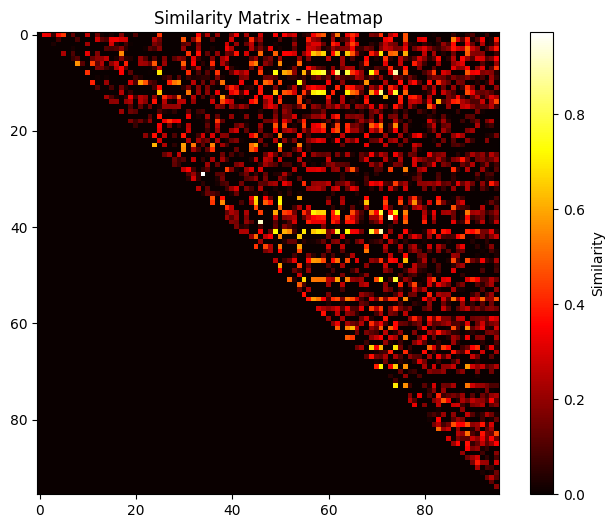

# Trustable: 23
iCls 1
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

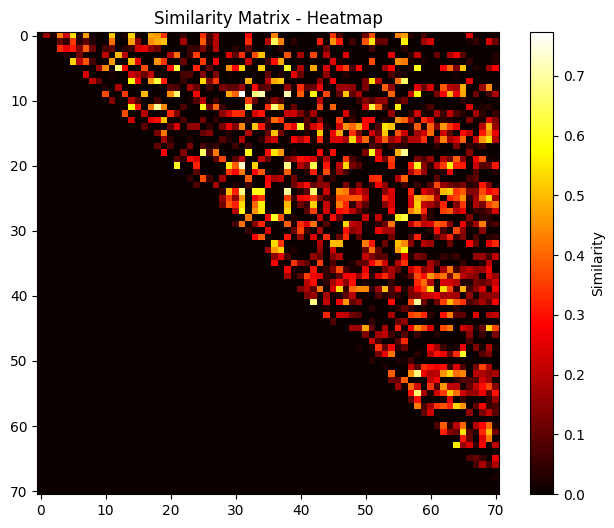

# Trustable: 31
iCls 2
numThisClass 91


  0%|          | 0/91 [00:00<?, ?it/s]

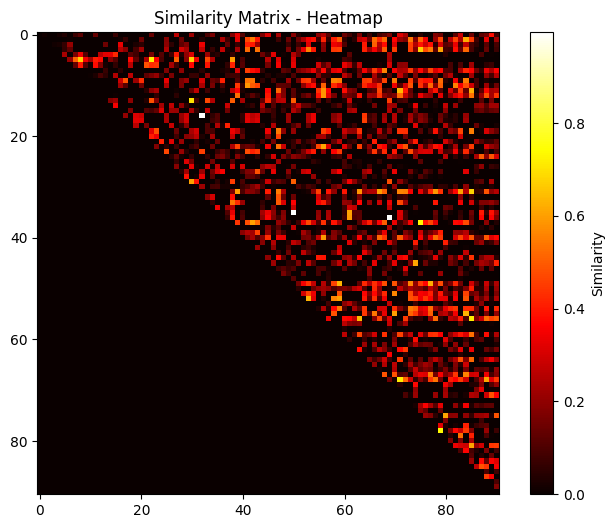

# Trustable: 5
iCls 3
numThisClass 86


  0%|          | 0/86 [00:00<?, ?it/s]

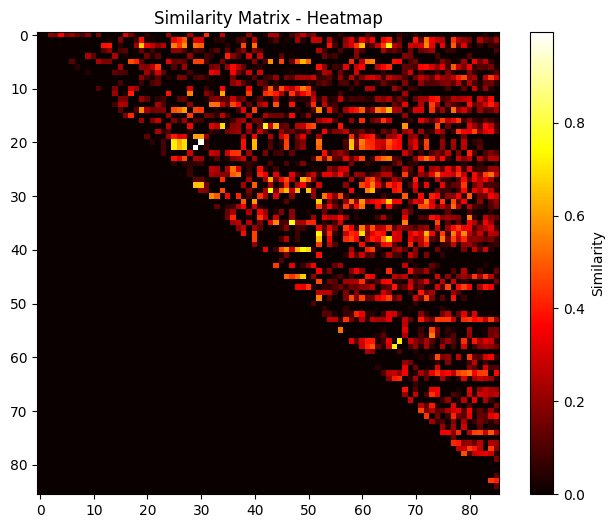

# Trustable: 14
iCls 4
numThisClass 89


  0%|          | 0/89 [00:00<?, ?it/s]

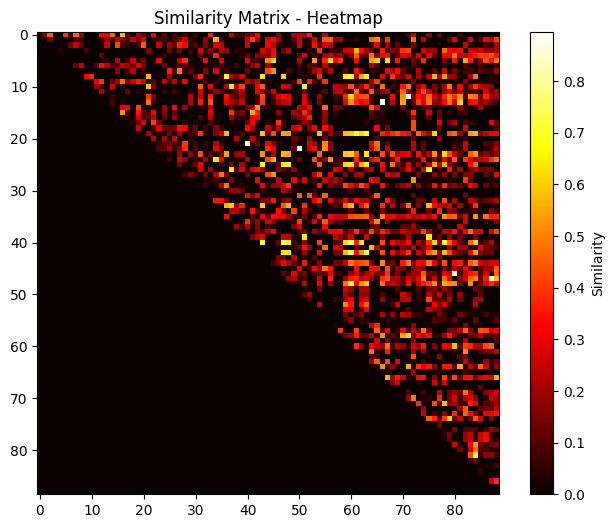

# Trustable: 22
iCls 5
numThisClass 66


  0%|          | 0/66 [00:00<?, ?it/s]

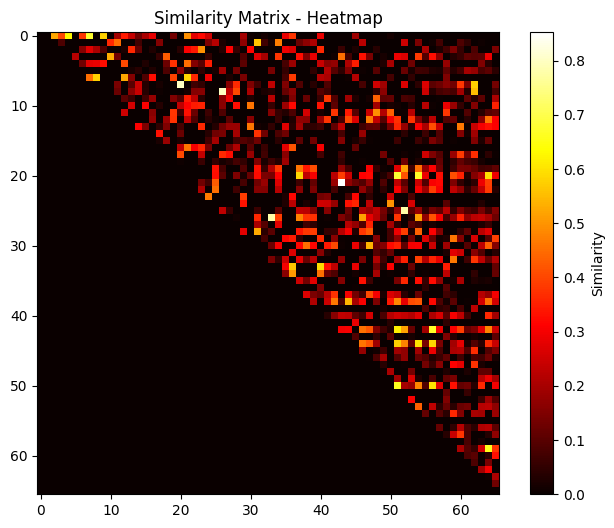

# Trustable: 8
iCls 6
numThisClass 64


  0%|          | 0/64 [00:00<?, ?it/s]

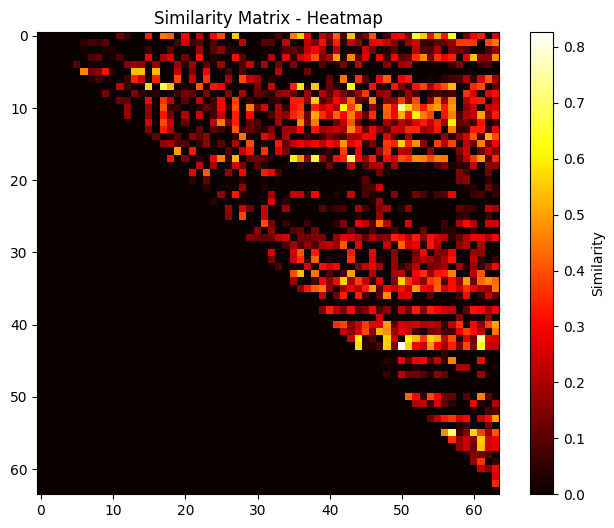

# Trustable: 20
iCls 7
numThisClass 86


  0%|          | 0/86 [00:00<?, ?it/s]

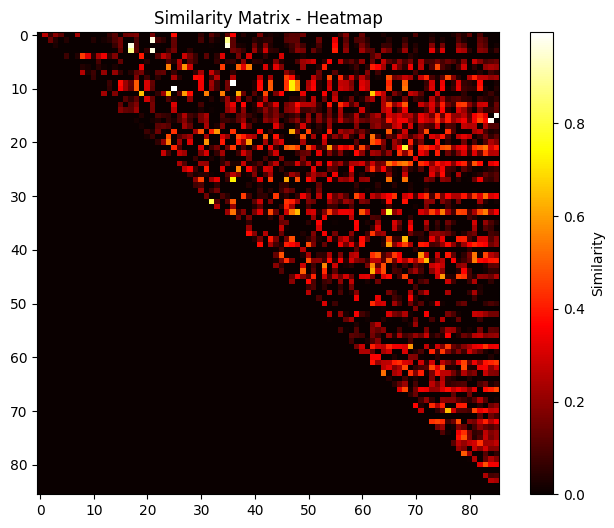

# Trustable: 8
iCls 8
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

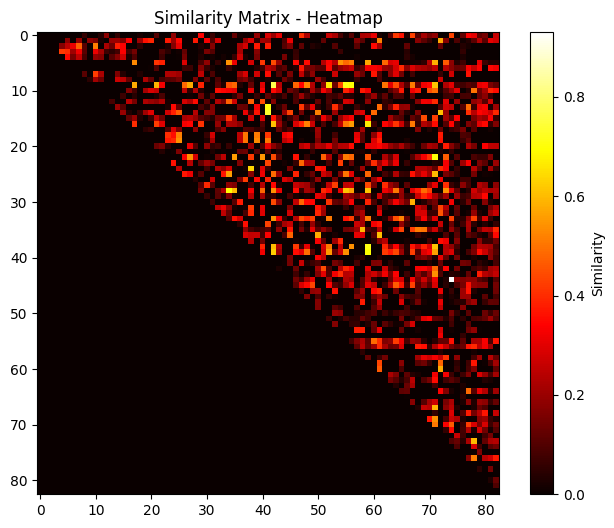

# Trustable: 16
iCls 9
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

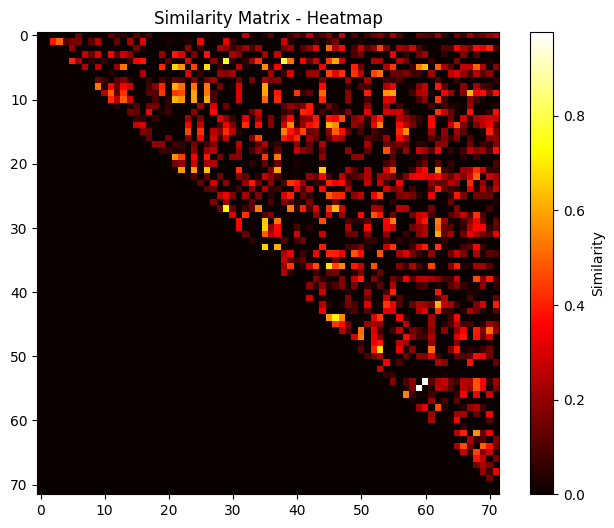

# Trustable: 10
iCls 10
numThisClass 71


  0%|          | 0/71 [00:00<?, ?it/s]

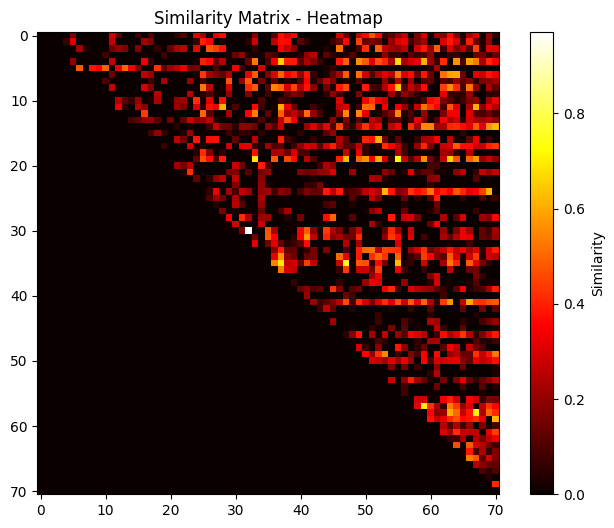

# Trustable: 13
iCls 11
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

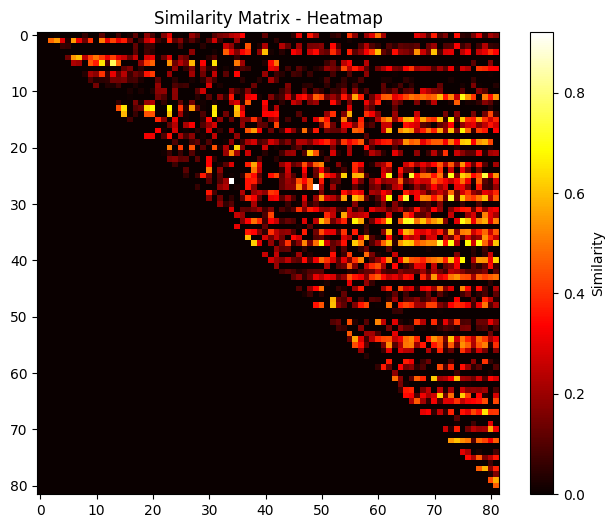

# Trustable: 26
iCls 12
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

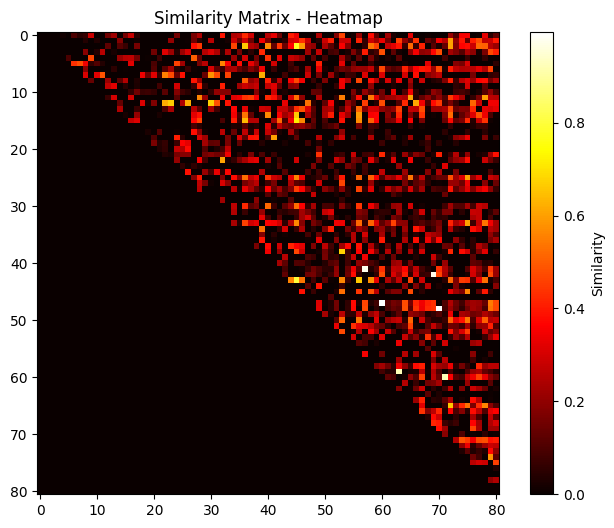

# Trustable: 7
iCls 13
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

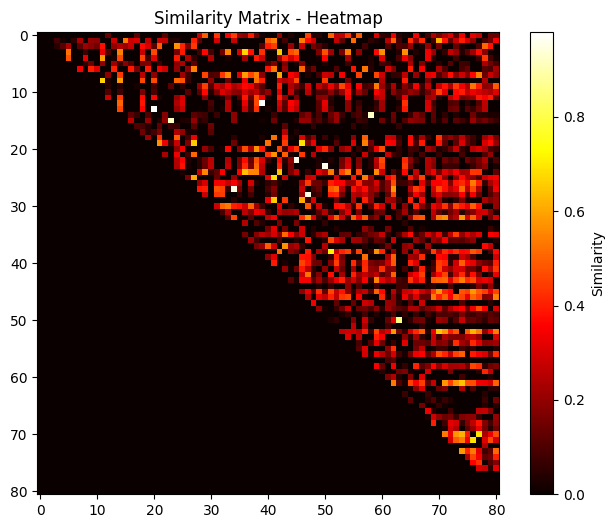

# Trustable: 3
iCls 14
numThisClass 90


  0%|          | 0/90 [00:00<?, ?it/s]

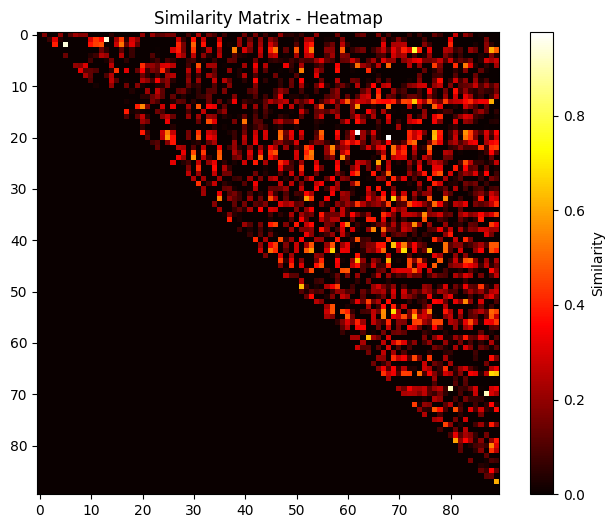

# Trustable: 5
iCls 15
numThisClass 85


  0%|          | 0/85 [00:00<?, ?it/s]

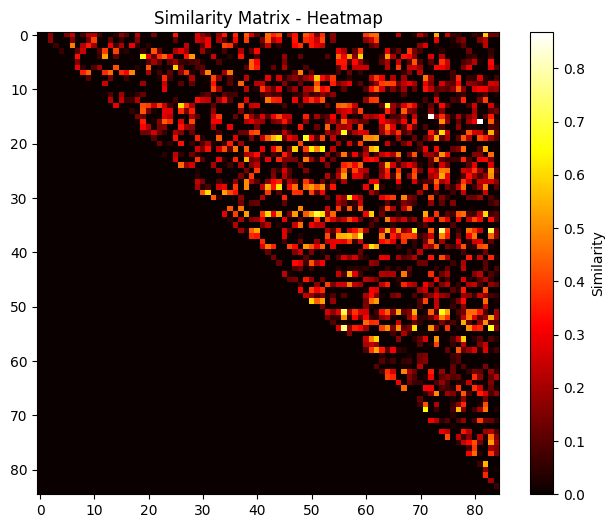

# Trustable: 21
iCls 16
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

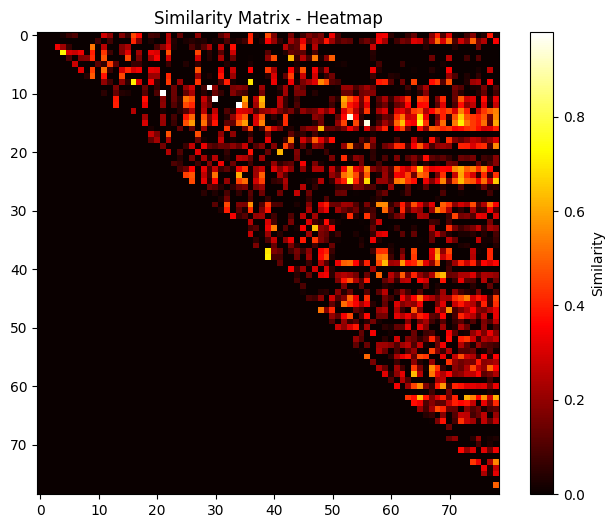

# Trustable: 14
iCls 17
numThisClass 53


  0%|          | 0/53 [00:00<?, ?it/s]

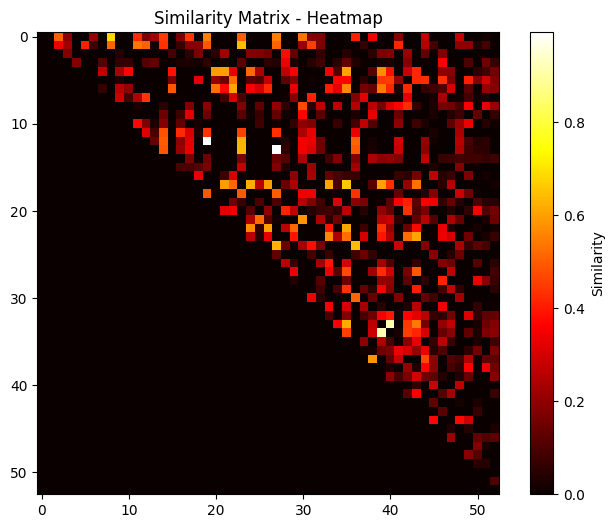

# Trustable: 12
iCls 18
numThisClass 97


  0%|          | 0/97 [00:00<?, ?it/s]

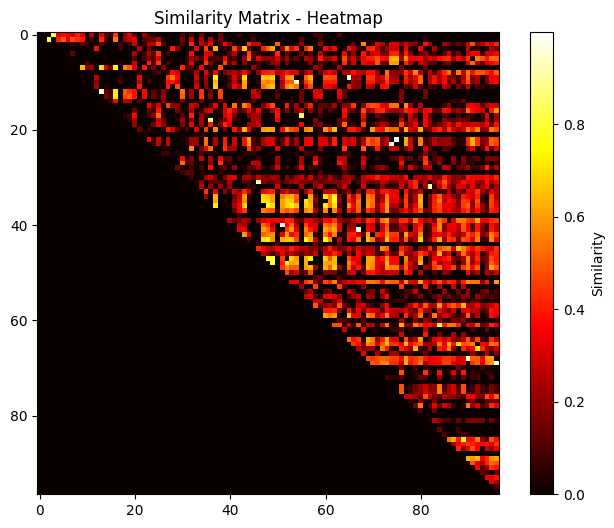

# Trustable: 31
iCls 19
numThisClass 69


  0%|          | 0/69 [00:00<?, ?it/s]

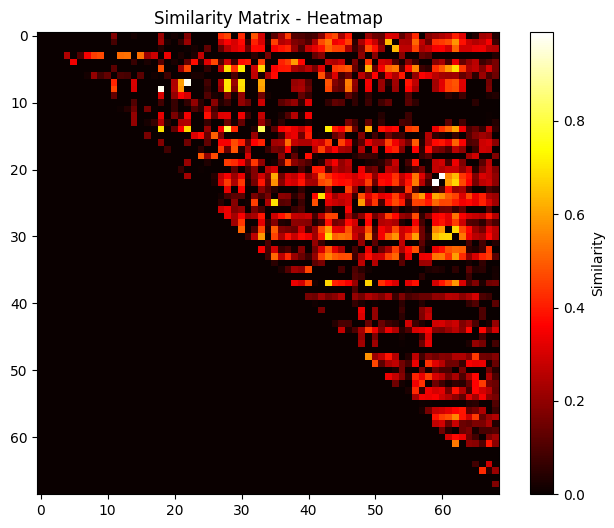

# Trustable: 20


In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "product_images",
                               pseudo_tree="tree", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/real_life/PSL_iter4.npz")

In [ ]:
pt = Trainer(train_data = train_set, pseudo_tree="tree")

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 173MB/s]


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

205


In [ ]:
np.unique(pt.train_data.pseudo_target, return_counts=True)

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11.,
        12., 13., 14., 15., 16., 17., 18., 19.]),
 array([1395,   13,   20,    5,    7,   12,    7,   14,    6,   11,    9,
          10,   15,    6,    3,    4,   12,    9,    8,   21,   13]))

In [ ]:
pt.train_data.save_pseudo("/content/gdrive/MyDrive/datasets/pseudolabels/real_life/tree_prod_source_T_PLS.npz")

In [ ]:
pt.train(epochs = 15, log_str = "prod2rl 4it T_SPL norm 15e from PSL_iter4")


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6225961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7716346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.6730769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7692307692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.78125


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7860576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8052884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8125


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8076923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.8076923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8100961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8076923076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8052884615384616


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8293269230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f5d0b3c8d30>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8149038461538461


auc,▁▆▃▆▆▇▇▇▇▇▇▇▇██
eval_loss,█▄▅▃▂▂▂▂▂▂▂▁▁▁▁
train_loss,█▂▂▂▁▁▁▁▁▁▁▁▁▁▁
auc,0.8149
eval_loss,0.6428
train_loss,0.36415


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_prod2real_life_e15_TPSL_from_iter4.pt")

###### REAL -> PRODUCT

Selecting examples for each class:   0%|          | 0/20 [00:00<?, ?it/s]

iCls 0
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

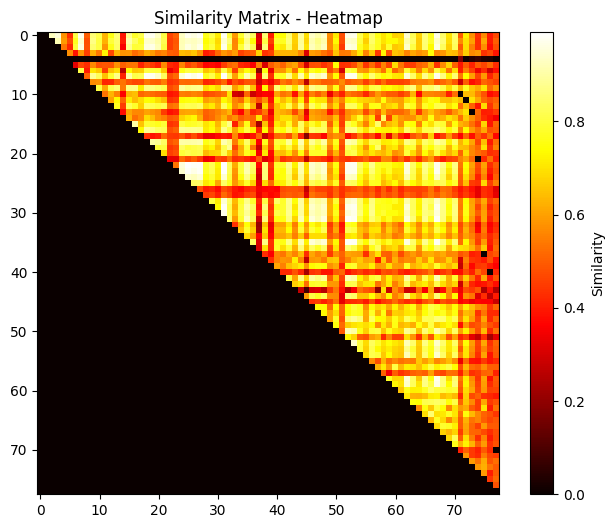

# Trustable: 61
iCls 1
numThisClass 91


  0%|          | 0/91 [00:00<?, ?it/s]

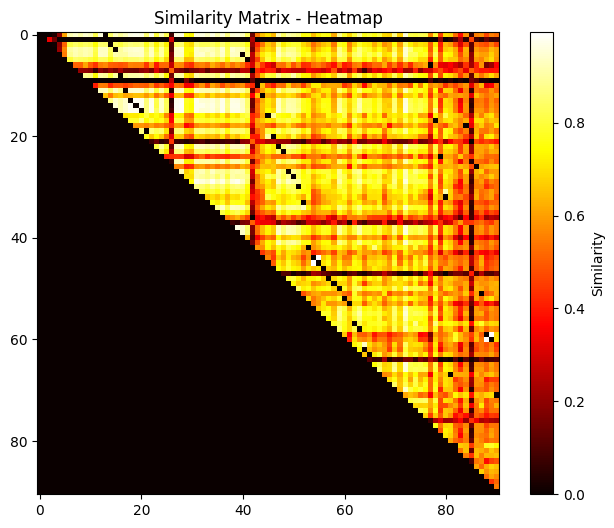

# Trustable: 81
iCls 2
numThisClass 75


  0%|          | 0/75 [00:00<?, ?it/s]

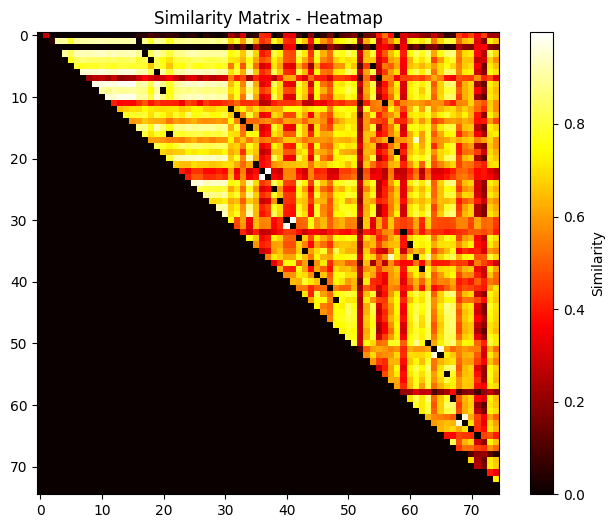

# Trustable: 57
iCls 3
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

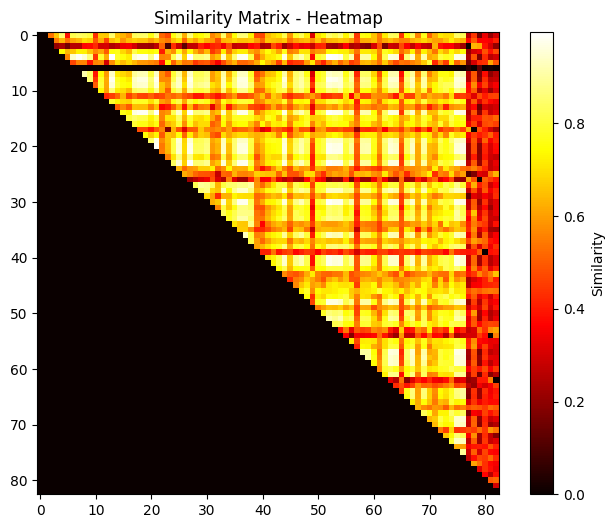

# Trustable: 65
iCls 4
numThisClass 82


  0%|          | 0/82 [00:00<?, ?it/s]

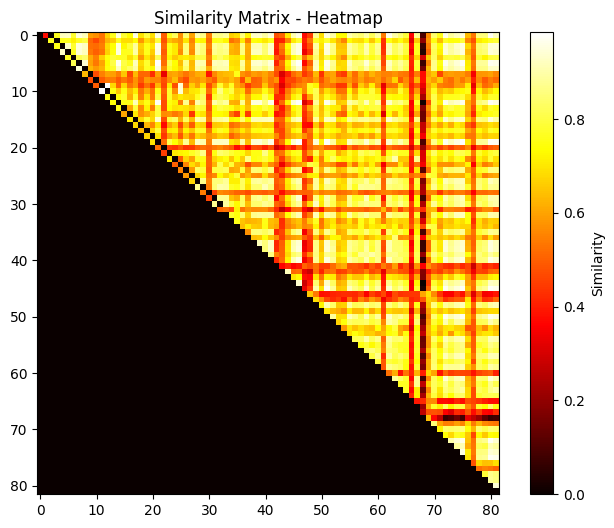

# Trustable: 67
iCls 5
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

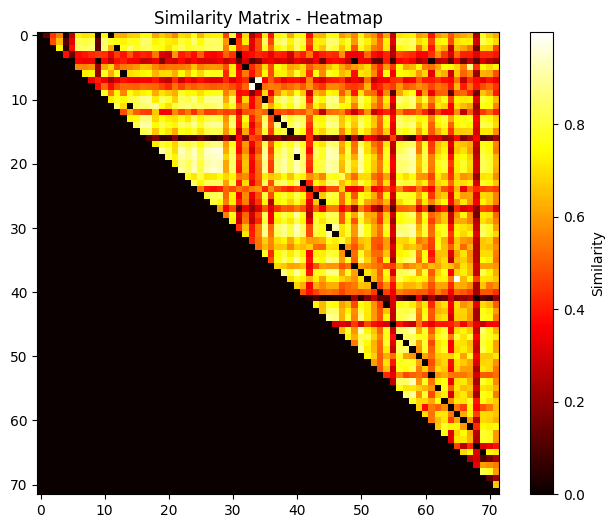

# Trustable: 47
iCls 6
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

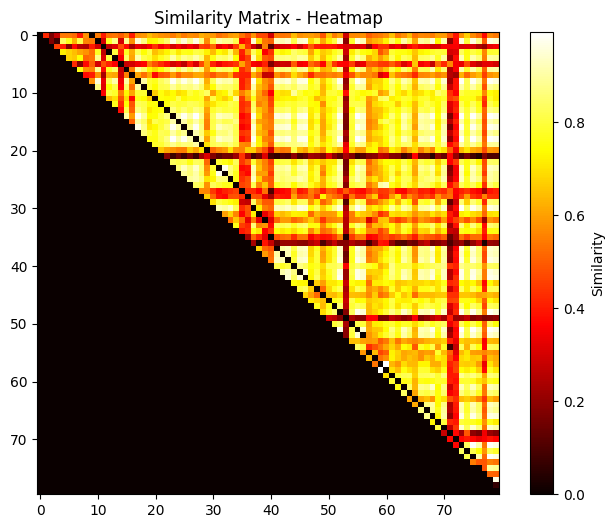

# Trustable: 69
iCls 7
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

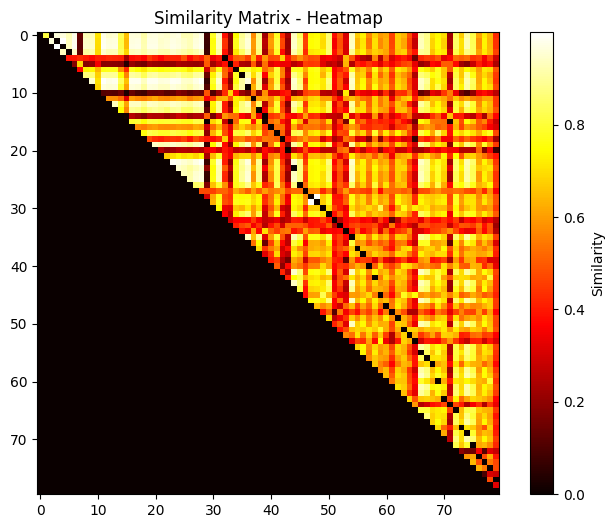

# Trustable: 56
iCls 8
numThisClass 81


  0%|          | 0/81 [00:00<?, ?it/s]

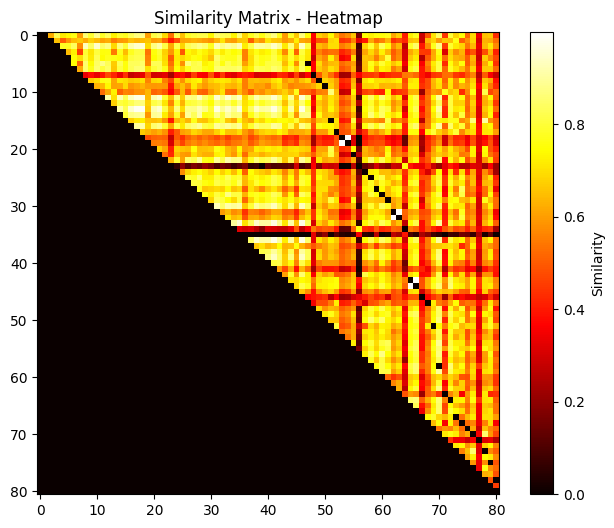

# Trustable: 57
iCls 9
numThisClass 92


  0%|          | 0/92 [00:00<?, ?it/s]

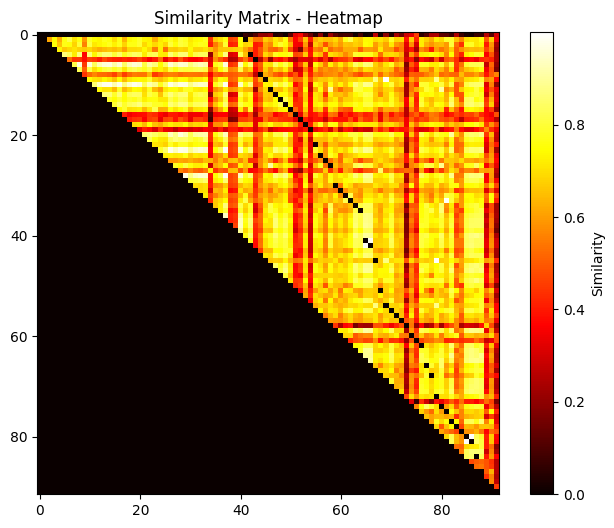

# Trustable: 66
iCls 10
numThisClass 86


  0%|          | 0/86 [00:00<?, ?it/s]

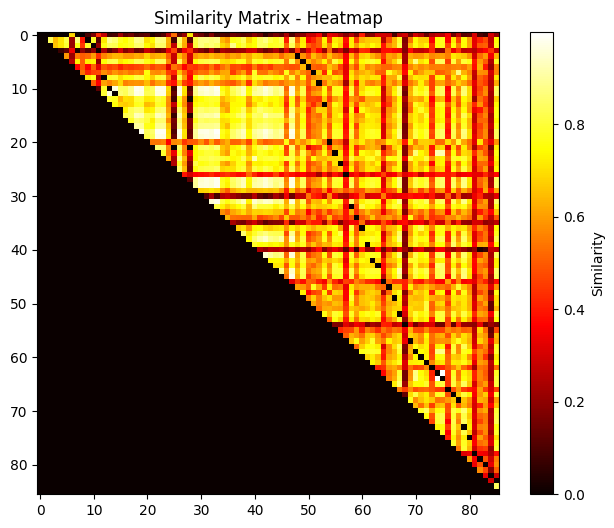

# Trustable: 61
iCls 11
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

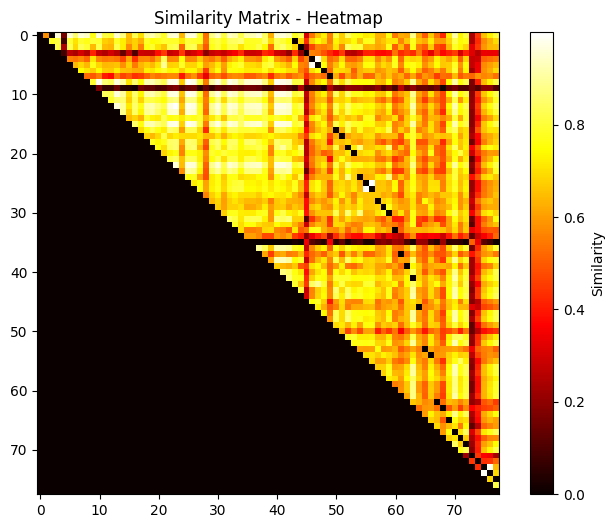

# Trustable: 60
iCls 12
numThisClass 83


  0%|          | 0/83 [00:00<?, ?it/s]

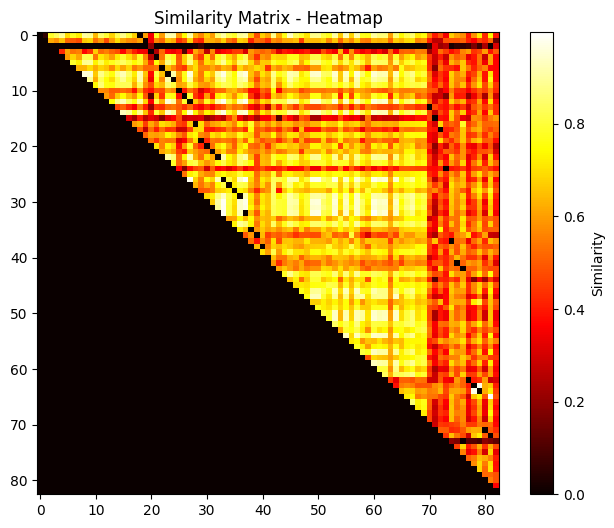

# Trustable: 57
iCls 13
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

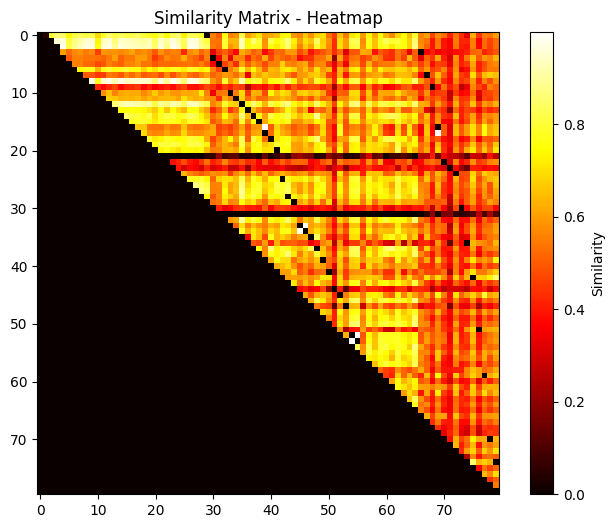

# Trustable: 63
iCls 14
numThisClass 79


  0%|          | 0/79 [00:00<?, ?it/s]

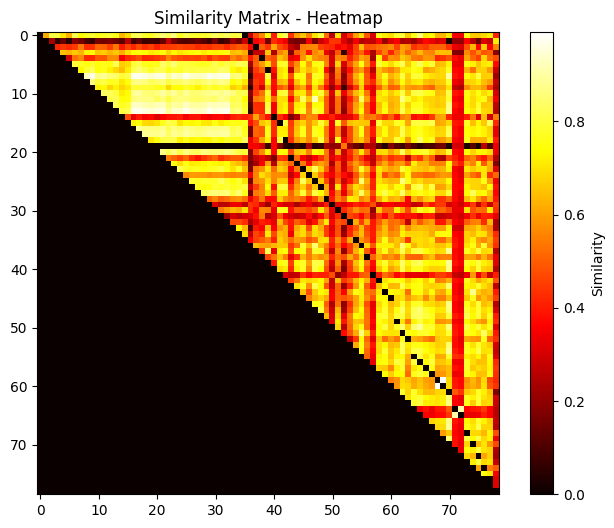

# Trustable: 61
iCls 15
numThisClass 76


  0%|          | 0/76 [00:00<?, ?it/s]

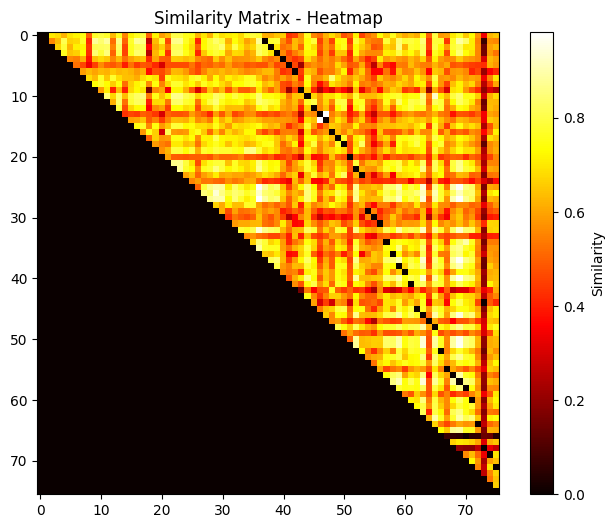

# Trustable: 47
iCls 16
numThisClass 72


  0%|          | 0/72 [00:00<?, ?it/s]

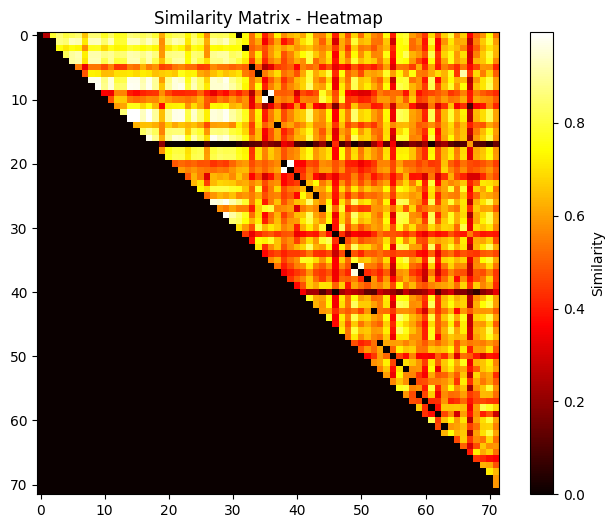

# Trustable: 49
iCls 17
numThisClass 80


  0%|          | 0/80 [00:00<?, ?it/s]

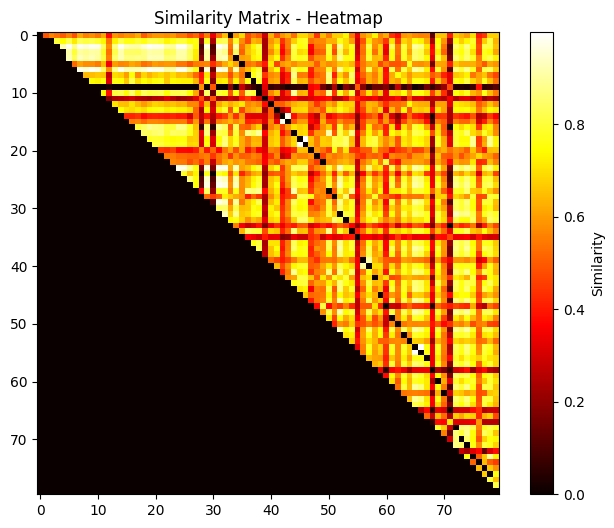

# Trustable: 66
iCls 18
numThisClass 78


  0%|          | 0/78 [00:00<?, ?it/s]

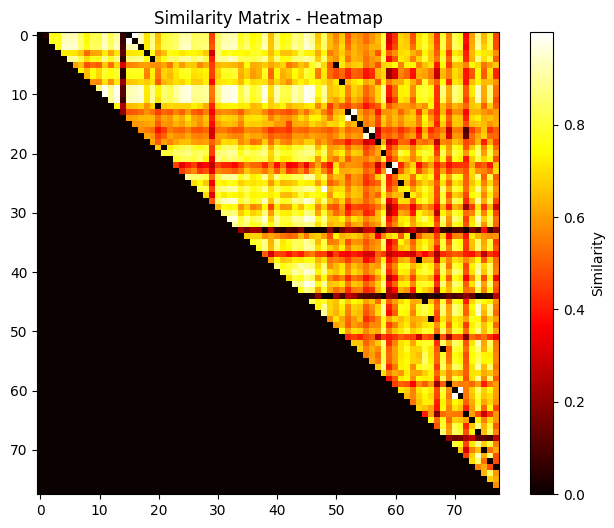

# Trustable: 65
iCls 19
numThisClass 74


  0%|          | 0/74 [00:00<?, ?it/s]

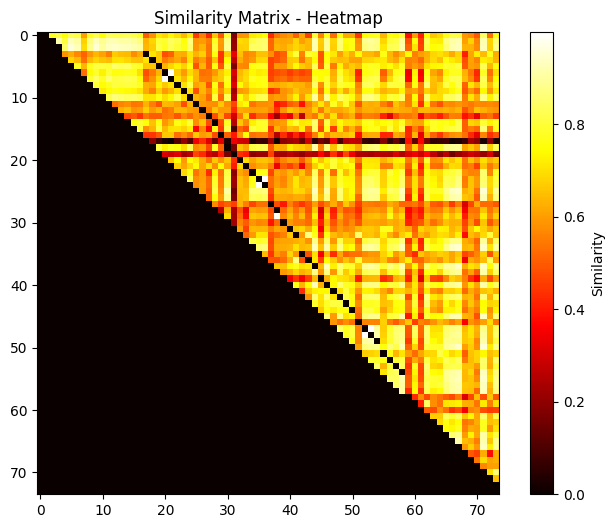

# Trustable: 54


In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life",
                               pseudo_tree="tree", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/PSL_iter4.npz")

In [ ]:
pt = Trainer(train_data = train_set, pseudo_tree="tree")

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 228MB/s]


In [ ]:
print((pt.train_data.pseudo_target>-1).sum())

842


In [ ]:
np.unique(pt.train_data.pseudo_target, return_counts=True)

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11.,
        12., 13., 14., 15., 16., 17., 18., 19.]),
 array([758,  43,  55,  40,  47,  51,  33,  49,  39,  37,  46,  43,  42,
         38,  42,  42,  36,  33,  45,  43,  38]))

In [ ]:
pt.train_data.save_pseudo("/content/gdrive/MyDrive/datasets/pseudolabels/product_images/tree_rl_source_T_PLS.npz")

In [ ]:
pt.train(epochs = 15, log_str = "rl2prod 4it T_SPL norm 15e from PSL_iter4")


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7764423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9014423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9134615384615384


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/tor

0.9278846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9399038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9375


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9375


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9399038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.9399038461538461


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9350961538461539


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9375


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9423076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

    if w.is_alive():  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9423076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7fee5640cf70>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9350961538461539


auc,▁▆▇▇███████████
eval_loss,█▄▃▂▂▂▁▁▁▁▁▁▁▁▁
train_loss,█▃▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.9351
eval_loss,0.25888
train_loss,0.65966


In [ ]:
pt.model.save(f"/content/gdrive/MyDrive/models_save/TREE_real_life2prod_e15_TPSL_from_iter4.pt")

## Training with SPL, Tree and CVAE

### REAL -> PRODUCT

In [ ]:
cvae = CVAE()

cvae.load(f"/content/gdrive/MyDrive/models_save/normCVAE_real_life2prod_e50_tree.pt")

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/tree_psuedo.npz")
pt = Trainer(train_data = train_set)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 175MB/s]


In [ ]:
pt.train(epochs = 15, log_str = "rl2prod 2it SPL 15e with normCVAE trained on tree CM", VAE = cvae)


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

 ··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.4254807692307692


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.5673076923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.7403846153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
self._shutdown_workers()Traceback (most recent call last):

  File "/usr/local/lib/pyt

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

    self._shutdown_workers()Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():    
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
if w.is_alive():
    assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/lib/python3.10/multiprocessing/process.py", line 16

0.8221153846153846


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
Exception ignored in: 

Step:   0%|          | 0/50 [00:00<?, ?it/s]

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

Traceback (most recent call last):
    if w.is_alive():
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
    self._shutdown_workers()Exception ignored in: Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0><function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers


Trace

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.7932692307692307


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8389423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9110576923076923


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8942307692307693


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

0.875


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0><function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>

Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/u

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Exception ignored in: if w.is_alive():
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'    
self._shutdown_workers()AssertionError
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
:     can only test a child processif w.is_alive():

  File "/usr/lib/

0.9014423076923077


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0><function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>

Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():    self._shutdown_workers()
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

    self._shutdown_workers()Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>    
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
assert self._parent_pid == os.getpid(), 'can only test a child process'    self._shutdown_workers()
    
if w.is_alive():AssertionError
  File "/usr/lib

0.8846153846153846


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.8966346153846154


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
self._shutdown_workers()Traceback (most recent call last):

  File "/usr/local/lib/pyt

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.90625


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9230769230769231


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    
assert self._parent_pid == os.getpid(), 'can only test a child process'AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f9a9bbac1f0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Evaluation:   0%|          | 0/13 [00:00<?, ?it/s]

0.9038461538461539


auc,▁▃▅▇▆▇██▇█▇████
eval_loss,█▆▅▃▃▃▂▂▂▁▁▁▁▁▁
train_loss,█▂▂▂▂▁▁▁▁▁▁▁▁▁▁
auc,0.90385
eval_loss,0.65101
train_loss,1.87422


## Training of the normCVAE

In this section we present the training of the normCVAE model. The pretrained models were subsequently utilized in the SPL+CVAE training as well as the SPL+tree+CVAE training.

##### PRODUCT -> REAL


In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "product_images", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/real_life/PSL_iter3.npz")


In [ ]:
t = CVAETrainer(train_set)
t.train(log_str = "trainer 10e loss check", epochs = 10)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Epoch:   0%|          | 0/10 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
    Traceback (most recent call last):
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    
self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
if w.is_alive():    assert self._parent_pid == os.getpid(), 'can only test a child process'

  File "/usr/lib/python3.10/multiprocessing/process.py", line 1

Step:   0%|          | 0/50 [00:00<?, ?it/s]

<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7f03a687f5b0>
    self._shutdown_workers()Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__

      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():    
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    if w.is_alive():
assert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    As

Step:   0%|          | 0/50 [00:00<?, ?it/s]

train_cross_recon_loss,█▆▃▃▂▂▂▂▂▁
train_loss,█▆▃▃▂▂▂▂▂▁
train_recon_loss,█▆▃▃▂▂▂▂▂▁
train_cross_recon_loss,541.50501
train_loss,1079.11326
train_recon_loss,537.60825


In [ ]:
t.model.save(f"prod2rlCVAE_SPL_e10_PSL3.pt")

##### REAL -> PRODUCT

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/PSL_iter2.npz")


In [ ]:
t = CVAETrainer(train_set)
t.train(log_str = "real_life2prod unnorm test 15e", epochs = 15)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Epoch:   0%|          | 0/15 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
          File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()Traceback (most recent call last):
if w.is_alive():  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    
if w.is_alive():
      File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only te

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Exception ignored in: Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>

Traceback (most recent call last):
  File "/usr/local/lib/pyt

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efe483ef520>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train_cross_recon_loss,█▆▄▃▂▁▂▂▂▂▁▁▂▁▁
train_loss,█▆▄▃▂▁▂▂▂▂▁▁▁▁▁
train_recon_loss,█▆▄▃▂▁▂▂▂▂▁▁▁▁▁
train_cross_recon_loss,542.19394
train_loss,1080.11088
train_recon_loss,537.91694


In [ ]:
t.model.save(f"real_life2prodCVAE_SPL_e15_PSL2.pt")

 ##### **Initial considerations**

 Visualization of the synthetic festures in the ResNet-50 feature space with the application of two dimensionality reduction techniques: Principal Component Analysis (PCA) and Uniform Manifold Approximation and Projection (UMAP).

In [ ]:
# P -> R
Xfe_rl, Yfe_rl, Xrecon_rl, Yrecon_rl = extract_features(data_prod, cvae_model_path="/content/gdrive/MyDrive/models_save/prod2rlCVAE_SPL_e10_PSL3.pt")

# R -> P
Xfe_prod, Yfe_prod, Xrecon_prod, Yrecon_prod = extract_features(data_rl, cvae_model_path="/content/gdrive/MyDrive/models_save/real_life2prodCVAE_SPL_e15_PSL2.pt")

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Step:   0%|          | 0/50 [00:00<?, ?it/s]

PRODUCT -> REAL

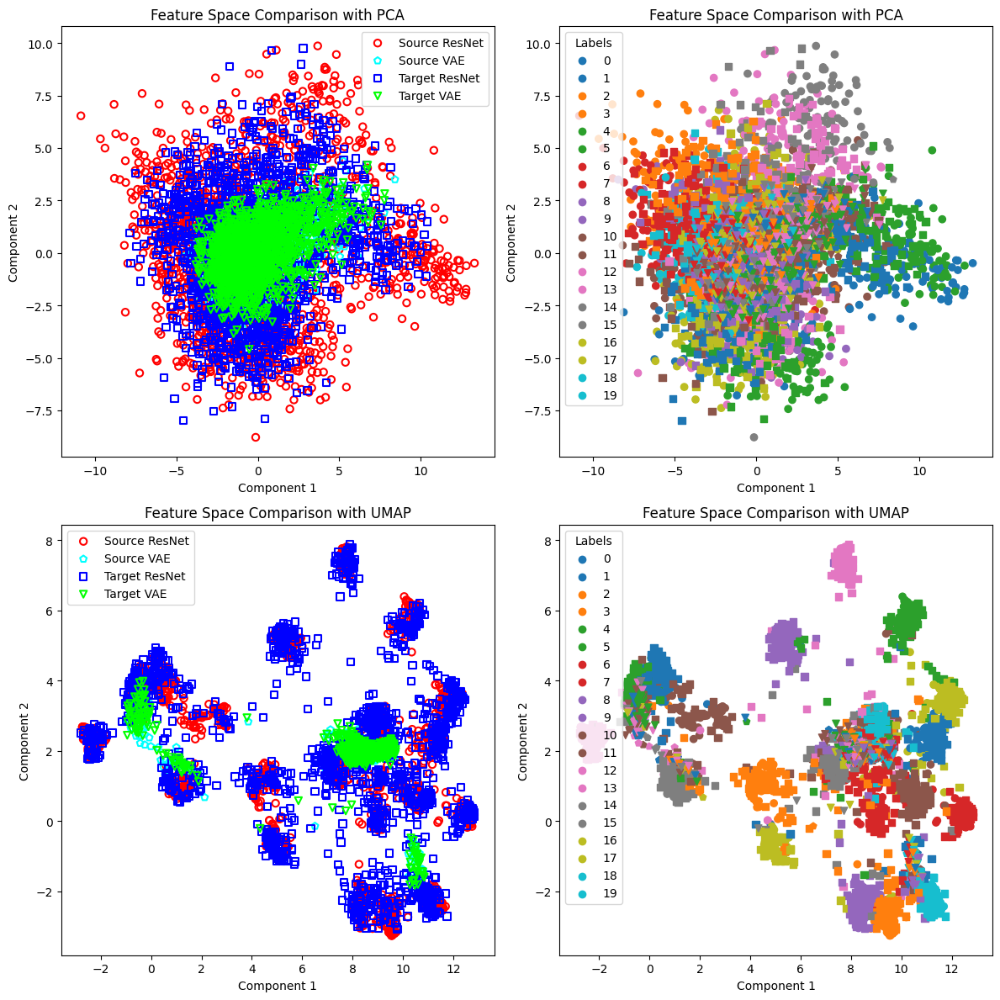

In [ ]:
plot_feature_comparison(Xfe_rl, Xrecon_rl, Yfe_rl, Yrecon_rl)

REAL -> PRODUCT

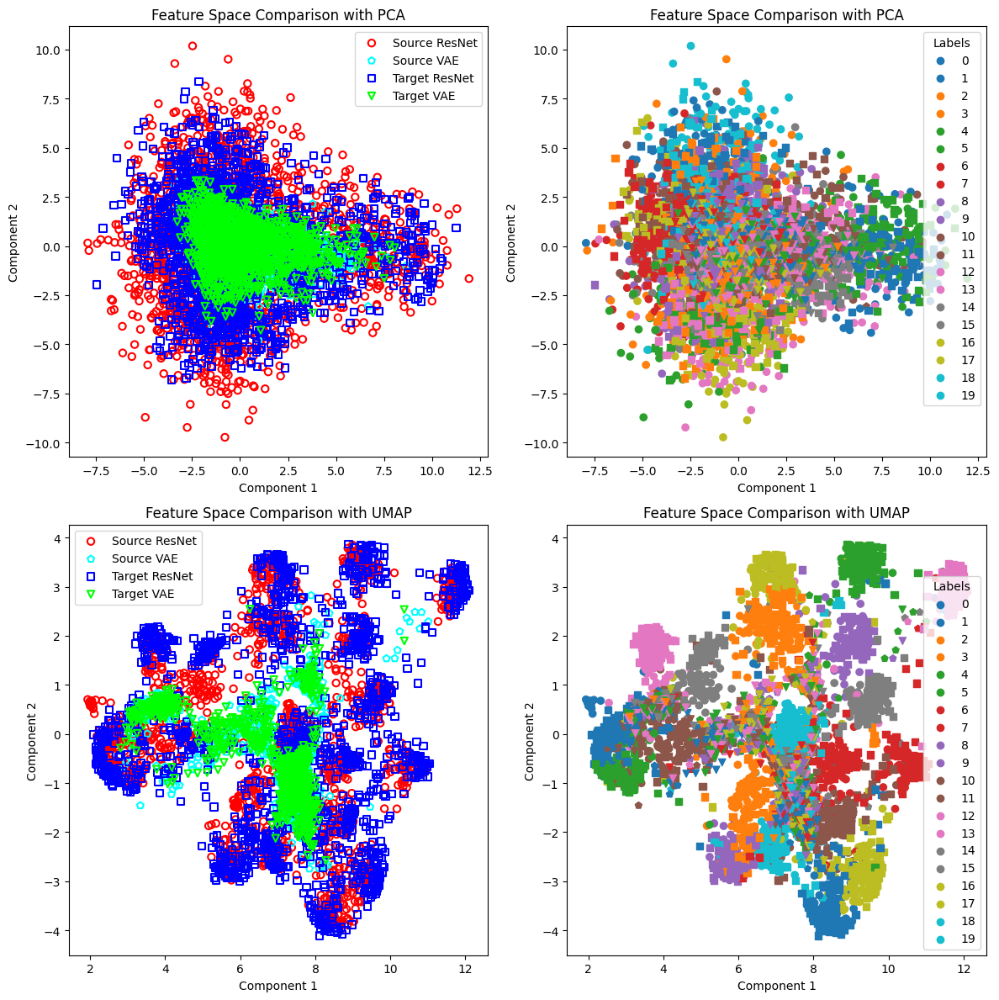

In [ ]:
plot_feature_comparison(Xfe_prod, Xrecon_prod, Yfe_prod, Yrecon_prod)

In the first UMAP plot (bottom left), we observe the distribution of both synthetic and real features in the ResNet-50 feature space. Notably, the features generated by the CVAE span a larger portion of the feature space in the real-to-product direction, while they appear more concentrated in the opposite one. It is worth mentioning that in both directions even if it is not clear, the synthetic features from both domains tend to cluster in similar locations within the feature space causing the overlapping between cyan pentagons and green triangles. Furthermore, in the second UMAP visualization, which includes the class labels, we notice that the features exhibit clustering patterns aligned with the class labels. This suggests that the CVAE has learned some domain-invariant features for each class.

The slight differences in clustering patterns between synthetic and real features could be attributed to the approximation nature of dimentionality reduction methods or the need for more extensive training for the CVAE to effectively span the same portion of the feature space as the real features extracted by ResNet50.

##### REAL -> PRODUCT with pseudolables corrected with trees

In [ ]:
train_set = TwoModalDataLoader( phase='train', root = root, source_domain = "real_life", pseudo_root = "/content/gdrive/MyDrive/datasets/pseudolabels/product_images/tree_psuedo.npz")


In [ ]:
t = CVAETrainer(train_set)
t.train(log_str = "real_life2prod tree labels loss check 50e", epochs = 50)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 233MB/s]


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Epoch:   0%|          | 0/50 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    self._shutdown_workers()
if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

    
can only test a child processassert self._parent_pid == os.getpid(), 'can only test a child process'  File "/usr/lib/python3.10/multip

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>

Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():
    if w.is_alive():  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive

Exception ignored in:     Exception ignored in:   File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
<function _M

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
if w.is_alive():
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only test a child process'if w.is_alive():

AssertionError  File "/usr/lib/python3.10/multiprocessing/proce

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Exception ignored in:     self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>

Traceback (most recent call last):
  File "/usr/local/lib/pyt

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
self._shutdown_workers()  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
AssertionError    : if w.is_alive():can only test a child process

  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    Exception ignored in: if w.is_alive():<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>

Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    assert self._parent_pid == os.getpid(), 'can only test a child process'self._shutdown_workers()

AssertionError  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
:     can only test a child process
if w.is_alive():
Exception ignored

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    Exception ignored in: self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/da

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
Exception ignored in:   File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>self._shutdown_workers()

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError
: can only test a child processcan only test a child process
    Exception ignored in: self._shutdown_workers()<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>

  File "/usr/local/lib/python3.

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():Exception ignored 

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Exception ignored in: Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
    self._shutdown_workers()
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
        self._shutdown_workers()if w.is_alive():

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        if w.is_alive():assert self._parent_pid == os.getpid(), 'can only test a child process'

AssertionError  File "/usr/lib/python3.10/multiprocessing/proce

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430><function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>

Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
      File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()
    if w.is_alive():
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
        assert self._parent_pid == os.getpid(), 'can only test a child process'if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 16

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    self._shutdown_workers()
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():Exception ignored 

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()self._shutdown_workers()

  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():

  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
<function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
        self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
self._shutdown_workers()    
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
if w.is_alive():
    if w.is_alive():  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
: AssertionError    Exception ignored in: assert self._parent_pid == os.getpid(), 'can only test a child process'

<function _MultiProcessin

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

Step:   0%|          | 0/50 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
    assert self._parent_pid == os.getpid(), 'can only test a child process'
AssertionError: can only test a child process
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7efb88b10430>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1478, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py", line 1461, in _shutdown_workers
    if w.is_alive():
  File "/usr/lib/

train_cross_recon_loss,█▆▄▄▃▃▃▃▂▂▃▃▃▃▃▂▂▂▃▂▂▁▂▂▁▂▂▂▁▂▂▂▁▁▁▂▁▁▁▂
train_loss,█▇▄▄▃▃▃▃▂▂▂▃▂▃▃▂▂▂▂▂▂▁▂▂▁▁▂▂▁▂▂▂▁▁▂▂▁▁▁▁
train_recon_loss,█▇▄▄▃▃▃▃▂▂▂▃▂▃▃▂▂▂▂▂▂▁▂▂▁▁▁▂▁▂▂▁▁▁▂▂▁▁▁▁
train_cross_recon_loss,536.3603
train_loss,1068.6312
train_recon_loss,532.27089


In [ ]:
t.model.save(f"normCVAE_SPL_T_real_life2prod_e50_tree.pt")

### **Initial considerations**

Visual inspection of the synthetic features in the ResNet-50 feature space.

In [ ]:
# R -> P
Xfe_prod, Yfe_prod, Xrecon_prod, Yrecon_prod = extract_features(data_rl, cvae_model_path="/content/gdrive/MyDrive/models_save/normCVAE_SPL_T_real_life2prod_e50_tree.pt")

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


Step:   0%|          | 0/50 [00:00<?, ?it/s]

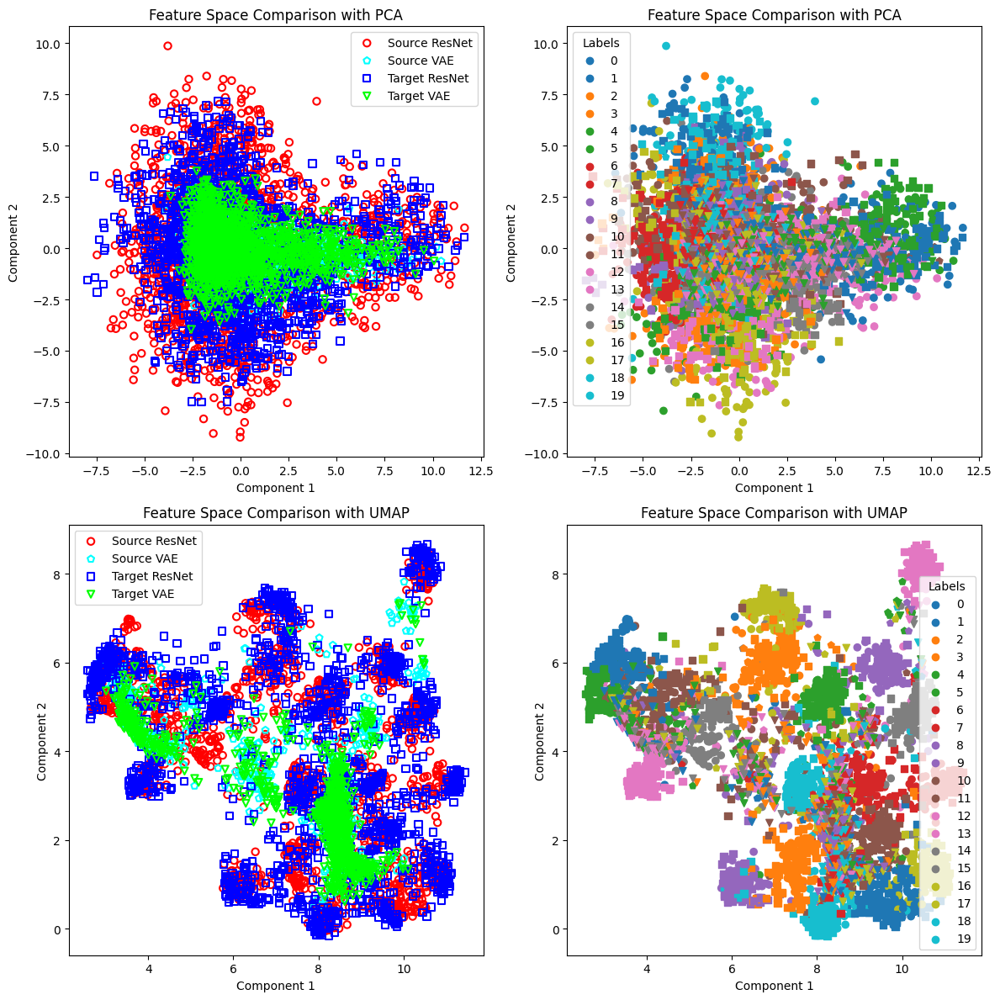

In [ ]:
plot_feature_comparison(Xfe_prod, Xrecon_prod, Yfe_prod, Yrecon_prod)

The training of the model with the incorporation of synthetic features from the CVAE was carried out unidirectionally. This decision was based on the availability of trustable pseudolabels, where the real-to-product direction had 842 trustable pseudolabeled samples compared to only 205 in the product-to-real direction. Due to the limited number of pseudolabeled samples, there is a risk of decreased diversity and representativeness in the target training data. Furthermore, even with a CVAE trained for 50 iterations, the observed performance in the real-to-product direction did not align with our expectations. Therefore, we decided not to proceed with training in the opposite direction.

# Discussion

 Point list summarizing the key steps in this project:

*      *Baseline model implementation:*

    The project begins with a baseline model that utilizes a ResNet-50 architecture to extract features from the input data. This serves as a starting point for comparison with other techniques.

*  *Trustworthy pseudolabel selection:*
    
    Techniques such as SPL and spanning trees are employed to select trustworthy pseudolabels. These techniques aim to identify reliable pseudolabels that are less likely to introduce errors or noise into the training process.

    The pseudolabels obtained for the target domain, in combination with the given labels of the source domain, are utilized to train a classifier. This training process is performed in two ways: a linear training approach and an iterative approach. The iterative training approach allows for refinement and adjustment of the pseudolabels over multiple iterations, leading to potentially improved results and increased adaptation capabilities.

*    *Conditional Variational Autoencoder (CVAE):*

    This step aims to enhance the training data by expanding it with synthetic samples, enabling the classifier to learn domain-invariant representations. By incorporating the synthetic labels generated by the CVAE, the classifier is exposed to a more diverse range of samples during training.

The table below summarises the results obtained within this project.


| Model       | R -> P      | P -> R      | Absolute Gain R->P | Absolute Gain P->R | Upper Bound P | Upper Bound R|
| ----------- | ----------- | ----------- | ---------- | ---------- |  ---------- | ---------- |
| Source Only        | 92.31 | 72.6 | --- | --- | 98.08 | 91.83 |
| SPL - Training extensively      | **95.67** | **86.78** | 3.36 | 14.18 |     |     |
| SPL + CVAE         | 91.59 | 79.81 | - 0.72 | 7.21 |     |     |
| Trees              | 93.99 | 80.77 | 1.68 | 8.17 |     |     |
| Trees - Training extensively   | 94.23 | 81.01 | 1.92 | 8.41 |     |     |
| PSL + Trees        | 94.23 | 82.93 | 1.92 | 10.33 |     |     |
| PSL + Trees + CVAE | 92.31 | --- | 0 | --- |     |     |


Table 1. Results

From a general perspective we can clearly say that one of the two directions, namely product-to-real, poses a more difficult challeng than the other direction. This was expected as images from the real_world domain are more detailed and can feature diverse backgrounds or image condition.
Therefore, a classifier trained on the real_world domain was expected to generalize and perform better on the product_images, as opposed to a classifier trained in the opposite direction and tested on the real_world domain.

Taking these factors into consideration, we initially expected and then observed greater improvements in the "difficult" direction, i.e., product-to-real.

All the plots and confusion matrixes obtained in our experiments are presented in the WANDB visual report below and will be shortly discussed.


## Visual report

In our experiments we have tested several possible settings and combinations for our proposed methods.
We have tested the two psuedolabeling strategies, SPL and spanning-trees, with 5 iterations of 5 epochs each to compare them.
Then with the pseudolabels obtained by the last iteration of SPL we trained a normCVAE to use for further training.
Finally, we trained several models for 15 epochs to perform an extensive comparison between methods.
Namely we compare:

1.   Classifier trained on source only data as baseline
2.   Classifier trained on the pseudolabels obtained by the last iteration of SPL
3.   Classifier trained on the psuedolabels generated by last iteration of  the spanning-tree algorithm
4. Classifier trained on the pseudolabels obtained by the last iteration of SPL together with normCVAE
5. Classifier trained on the pseudolabels obtained by the last iteration of SPL and succesively fed once throug the spanning-tree algorithm

The WANDB visual report provides a comprehensive overview of the experimental results, organized according to the two directions: product-to-real and real-to-product. Each direction includes several sections, including:

1.    Iterative SPL Report
2. Iterative Spanning Tree Report

3.  Comparison of 5-15 Epochs Runs: Baseline model, extensively trained SPL, SPL+normCVAE, extensively trained tree, and SPL+trees

4. NormCVAE Training Report

Overall, the WANDB visual report allows for a detailed examination of accuracy and loss trends, confusion matrices, and class misclassification rankings.

In [ ]:
%%html
<iframe src="https://api.wandb.ai/links/uda-dl/fzjw1nxk" width="1200" height="1000" allowfullscreen></iframe>


***SPL iterative***

Looking at the plots for the SPL iterative training process we can clearly see how the accuracy increases and the evaluation loss drops at each iteration. However, it is important to note that, as we would expect, the training loss increases with each iteration as the number of target pseudolabeled training examples gradually increases.

This behaviour is visible in both diretions however in the direction P->R it is more clear as we obtain an overall better gain across the iterative training process. In the direction R->P the difference in performance across the iterations is much narrower, due to the already competitive starting performance. As a result, the progression in performance across the iterations becomes less stable in this direction.

***Spanning-trees iterative***

We initially conducted a training using the Spanning Trees algorithm for the indentification of the trustable pseudolabes only once (reported in the Rusults/Training section). This preliminary training was conducted as an exploratory step to evaluate the standalone effectiveness of this technique in improving the model's performance. We observed promising results, as documented in the results table, so we decided to further investigate the application of the Spanning Trees algorithm within the iterative training process.

The iterative training process showed that the gain over the baseline was constant regardless of the iteration or total number of iterations for both directions.

A key difference between SPL and Spanning Trees is the fact that Spanning Trees is not bounded in the number of pseudolabels produced at each iteration, while for SPL the number increses at each iteration. More specifically Spanning Tree in the first iteration is able to select as many speudolabels as the threshold allows, and by not having a maximim number we can see the majority of the achievable improvement right from the beginning.

Based on these considerations we decided to test the spanning-trees algorithm by training a classifier on a single iteration for more epochs (i.e. perforing an extensive training). Additionally, we utilized the pseudolabels generated from the last iteration of the SPL method and we applied the Spanning Trees algorithm as a remediation mechanism for mislabeled samples.


***15 Epochs runs***

As expected the differences between the several approaches and the progression are more visible in the P->R direction as we manage to achieve more gain over the baseline.

***P->R***

In the Product-to-Real direction we managed to obtain a significant gain over the baseline across all tested settings. However, there were notable variations in performance among the proposed methods, with SPL emerging as the most successful approach. The utilization of spanning-trees also yielded promising results, with the choice of input pseudolabels not playing a major role in the final outcomes (Tree extenive vs SPL+tree).

Among the proposed methods, the model trained with SPL and using normCVAE for data augmentation achieved the lowest performance, although it still obtained a significant gain over the baseline. Notably, its performance was approximately half that of SPL alone.
It is worth mentioning that the training loss of the classifier trained on synthetic features was considerably higher than that of the other methods suggesting a difficulty to properly train it on the whole dataset, potentially due to the quality of the synthetic data.

By examining the confusion matrix for the 15 epochs runs we can clearly see how the proposed psuedolabling strategies are able to improve the performance of the classifiers greatly on the most mislabeled classes. This can be seen by looking at the classification of `file cabinet` and `flat iron` classes particularly. In addition, the confusion matrix of SPL iterative training revels how the progressive iterations allow to the model to improve also on classes with small classification error.


***R->P***

In the Real-to-Product direction, we observed a similar trend to the opposite direction, albeit with a smaller magnitude. Our proposed methods still yielded a small but significant improvement over the baseline, with SPL once again being the top-performing approach. It is noteworthy that in this direction, the model trained on synthetic data (SPL+CVAE) exhibited poorer performance compared to the baseline. This outcome clearly indicates a challenge in achieving effective generalization, likely due to inconsistencies in the training data.

The confusion matrices for this direction exhibited less variability across the tested models, making it more challenging to draw conclusions. However, we can observe that the class most frequently misclassified is still `file cabinet`, suggesting an underlies common difficulty of this specific class. This challenge could be attributed to the topological features of file cabinets or the separability of projected image features in the ResNet-50 space. The most commonly mislabeled class for `file cabinet` images was `bookcase`, which shares a significant amount of conceptual and visual information with the `file cabinet` class.


***normCVAE***

We checked the performance of the normCVAE model by examining its reconstruction loss during training. Additionally, we compared the synthetic features generated by the generative model with the features extracted by ResNet-50 to ensure they occupied a similar space. While the plots and losses indicated that the normCVAE model was indeed learning, its use for data augmentation did not prove to be successful in terms of performance among the proposed methods.

To investigate whether the limitations of the generative model were potentially due to the presence of mislabeled data in the target domain, we trained an additional model using the pseudolabels processed by the spanning-trees algorithm as a remediation technique. However, we did not observe any significant difference in performance between the resulting classifier, thereby ruling out such speculations.

# Conclusions

Our study focuses on the effectiveness of pseudolabeling in addressing Unsupervised Domain Adaptation (UDA) problems. We have tested and shown that pseudolabeling, often overlooked, can yield solid and competitive performance. We selected our approaches acknowledging our available resources and limitations, namely modest computational power and data scarcity.

Among our proposed methods the best performing one, Selective Pseudolabeling is also the simplest one both in terms of complexity and training requirements.

However, all other methods also achieved significant improvements over the baseline, indicating the adaptability and power of pseudolabeling in learning a cross-domain classifier. The spanning-tree strategy showed comparable performances to SPL. Its reliance on data features rather than a learned classifier makes it more suitable for situations where training a classifier outputting high-confidence pseudolabels is challenging.

On the other hand, the use of normCVAE for data augmentation did not yield successful results. We suspect that the generative model failed to produce informative enough image features, thereby disrupting the training process of the classifier. To address this issue, we considered increasing the complexity of the CVAE architecture to better approximate the distribution of image features. However, doing so would affect the overall complexity of the proposed methods, nullifying one of their main advantages.

In summary, our work highlights the competitiveness of simple architectures. By leveraging the Universal Representation of pretrained models and employing proper training strategies, these architectures can jointly classify different classes across domains. This is possible thanks to the shallow classification MLP at the end of each network which has demonstrated the ability to classify extracted image features in a domain-independent manner.

